# SF DST Car Price Prediction

Цель проекта: Прогнозирование стоимости автомобиля по характеристикам.

Данный проект в рамках курса "Специализация Data Science" был разделен на два юнита. В каждом из которых нужно было реализовать отдельные задачи.
В первой части основной упор был на классический ML, feature engineering и отбор фич, ансамблирование моделей и знакомство с библиотекой CatBoost. 
Во второй части нужно было обучить multi-input нейронную сеть состоящую из простого перцептрона, реккурентной нейросети, которая бы обрабатывала текст, и сверточной нейросети, которая принимала бы на вход фотографии автомобилей. Так же необходимо было ансамблировать ML и DL модели или их результаты.

Личные задачи на проект:
* Попрактиковаться в менеджменте экспериментов
* Попробовать подбор архитектуры перцептрона, с помощью optuna.
* Использовать BERT в качестве нейросети для регрессии на основе текста.


In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Import

In [2]:
!pip install catboost
!pip install category_encoders

In [3]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import sys

import sklearn
import matplotlib.pyplot as plt

from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import ColumnTransformer
from sklearn.metrics import f1_score

from tqdm.notebook import tqdm

from catboost import CatBoostRegressor
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler, MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.feature_extraction.text import CountVectorizer

import tensorflow as tf

from tqdm import tqdm

import re

import pandas_profiling as PP
import category_encoders as ce

from keras.models import load_model

import albumentations

import os
tqdm.pandas()

import random

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.7/dist-packages/tqdm/std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [4]:
print('Python       :', sys.version.split('\n')[0])
print('Numpy        :', np.__version__)
print('Tensorflow    :', tf.__version__)

Python       : 3.7.10 (default, Feb 20 2021, 21:17:23) 
Numpy        : 1.19.5
Tensorflow    : 2.4.1


# Setup

In [5]:
VERSION    = 6
VAL_SIZE   = 0.33   # 33%
N_FOLDS    = 5

# CATBOOST
ITERATIONS = 1000
LR         = 1e-3

# ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [6]:
!pip freeze > requirements.txt
RANDOM_SEED = 42

# Neptune.ai logging setup

In [7]:
! pip install neptune-client==0.4.132

     |████████████████████████████████| 112kB 5.7MB/s 
     |████████████████████████████████| 829kB 11.2MB/s 
     |████████████████████████████████| 61kB 6.0MB/s 
     |████████████████████████████████| 163kB 20.8MB/s 
     |████████████████████████████████| 133kB 16.6MB/s 
     |████████████████████████████████| 71kB 6.3MB/s 
     |████████████████████████████████| 71kB 8.4MB/s 
  Created wheel for neptune-client: filename=neptune_client-0.4.132-py2.py3-none-any.whl size=166223 sha256=d63f9b039038280484ddfae8e4503a2d799e9310f05d4ed5064ba783a9426f53
  Stored in directory: /root/.cache/pip/wheels/ef/17/bc/2f8eef68e5adb68415d3634a6c70185860f4461b00c1c6a37b
  Created wheel for future: filename=future-0.18.2-cp37-none-any.whl size=491058 sha256=a8e1c5e2c7554b3839b9971f11a6ef5c2ec413d8673070bafa14313d8948285b
  Stored in directory: /root/.cache/pip/wheels/8b/99/a0/81daf51dcd359a9377b110a8a886b3895921802d2fc1b2397e
  Created wheel for strict-rfc3339: filename=strict_rfc3339-0.7-cp37-none-a

In [8]:
import neptune

neptune.init(project_qualified_name='rianvarev/Car-price-prediction', # change this to your `workspace_name/project_name`
             api_token='ANONYMOUS', # change this to your api token
            )

Project(rianvarev/Car-price-prediction)

# Data

In [7]:
!ls /content/gdrive/MyDrive/archive

'best_model(8).hdf5'  'car_train(4).csv'   dataset_car_price


In [8]:
train = pd.read_csv("/content/gdrive/MyDrive/archive/car_train(4).csv")
train.dropna(how = 'all', subset = ['price'], inplace = True)

In [9]:
train = train.loc[:,:'{@context']
test = pd.read_csv('/content/gdrive/MyDrive/car_data/test.csv')
# sample_submission = pd.read_csv(DIR_TEST+'sample_submission.csv')

In [10]:
train.loc[1986]

Unnamed: 0                                                           1986
Unnamed: 0.1                                                         1986
Unnamed: 0.1.1                                                       1986
Unnamed: 0.1.1.1                                                     1986
@type                                             http://schema.org/Offer
PTS                                                                   NaN
availability                                    http://schema.org/InStock
bodyType                                                          лифтбек
brand                                                          VOLKSWAGEN
color                                                               серый
complectation           ;Комфорт10;Круиз-контроль;Электростеклоподъёмн...
condition                                                             NaN
customs                                                               NaN
description             Официальный ди

В процессе парсинга картинок возникла проблема с тем, что в некоторых случаях спарсился вместо фотографий откровенный мусор. И фотографии не покрывают тренировочный датасет целиком. Нужно поправить это. Нужно отобрать для предобучения модели только корректные, чтобы затем вставить корректную сверточную модель в мульти-инпут сеть. Либо продублировать картинку автомобиля картинкой точно такой же модели, там где их нет. Переиспользую картинки автомобилей той же модели, так как и так много повторяющихся изображений для разных автомобилей.

In [11]:
def get_sale_id(x):
    try:
        if x.is_pic == True:
            return x['car_id']
        else:
            name = x.car_name
            return random.choice(list(df_train_pics[(df_train_pics['is_pic'] == True) & (df_train_pics['car_name'] == name)]['car_id'].values))
    except:
        np.nan

def get_test_sale_id(x):
    try:
         return random.choice(list(df_train_pics[df_train_pics['car_name'].str.contains.x['car_name']]['car_id'].values))
    except: return np.nan

In [12]:
df_train_pics = pd.DataFrame(columns = ['car_id','car_name', 'is_pic', 'sale_id']) 
df_train_pics['car_id'] = train['id'] 
df_train_pics['car_name'] = train.name 
df_train_pics['car_name'] = df_train_pics['car_name'].apply(lambda x: x.lower().replace(' ', ''))

# df_sub_pics = pd.DataFrame(columns = ['car_id','car_name', 'is_pic', 'sale_id'])  #имена отличаются принципиально, допарсить тяжело, в тесте нет картинок
# df_sub_pics['car_id'] = test['id'] 
# df_sub_pics['car_name'] = test.name 
# df_sub_pics['car_name'] = df_sub_pics['car_name'].apply(lambda x: x.lower().replace(' ', ''))
# df_sub_pics['sale_id'] = df_sub_pics.apply(lambda x: get_test_sale_id(x), axis = 1)

df_train_pics['is_pic'] = df_train_pics.apply(lambda x: os.path.isfile(
    f'/content/gdrive/MyDrive/archive/dataset_car_price/dataset_car_price/{int(x.car_id)}.jpeg'),axis = 1) 
df_train_pics['sale_id'] = df_train_pics.apply(lambda x: get_sale_id(x), axis = 1)

In [13]:
# для скорости оставшиеся 54 штуки проще дропнуть чем допарсить
train.drop(df_train_pics[df_train_pics['sale_id'].isna()].index, inplace = True)
df_train_pics.drop(df_train_pics[df_train_pics['sale_id'].isna()].index, inplace = True)

# EDA

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13890 entries, 0 to 13986
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Unnamed: 0            13890 non-null  int64  
 1   Unnamed: 0.1          13890 non-null  int64  
 2   Unnamed: 0.1.1        13890 non-null  int64  
 3   Unnamed: 0.1.1.1      13890 non-null  int64  
 4   @type                 13890 non-null  object 
 5   PTS                   0 non-null      float64
 6   availability          13890 non-null  object 
 7   bodyType              13889 non-null  object 
 8   brand                 13890 non-null  object 
 9   color                 13890 non-null  object 
 10  complectation         12242 non-null  object 
 11  condition             8950 non-null   object 
 12  customs               8950 non-null   object 
 13  description           13877 non-null  object 
 14  drive                 8949 non-null   object 
 15  engineDisplacement 

In [ ]:
train.head()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Unnamed: 0.1.1.1,@type,PTS,availability,bodyType,brand,color,...,owners,owningTime,price,priceCurrency,productionDate,url,vehicleConfiguration,vehicleEngine,vehicleTransmission,{@context
0,0,0,0,0,http://schema.org/Offer,NaN,http://schema.org/InStock,минивэн,VOLKSWAGEN,серый,...,1 владелец,6 лет и 2 месяца,1697000.0,RUB}},2014.0,https://auto.ru/cars/used/sale/volkswagen/cara...,MINIVAN MECHANICAL 2.0,{@type,механическая,https://schema.org
1,1,1,1,1,http://schema.org/Offer,NaN,http://schema.org/InStock,седан,VOLKSWAGEN,чёрный,...,3 или более,NaN,299000.0,RUB}},2001.0,https://auto.ru/cars/used/sale/volkswagen/pass...,SEDAN AUTOMATIC 1.8,{@type,автоматическая,https://schema.org
2,2,2,2,2,http://schema.org/Offer,NaN,http://schema.org/InStock,внедорожник 5 дв.,VOLKSWAGEN,чёрный,...,2 владельца,8 лет и 1 месяц,1699999.0,RUB}},2012.0,https://auto.ru/cars/used/sale/volkswagen/toua...,ALLROAD_5_DOORS AUTOMATIC 3.6,{@type,автоматическая,https://schema.org
3,3,3,3,3,http://schema.org/Offer,NaN,http://schema.org/InStock,минивэн,VOLKSWAGEN,синий,...,3 или более,NaN,1285000.0,RUB}},2009.0,https://auto.ru/cars/used/sale/volkswagen/mult...,MINIVAN AUTOMATIC 2.5,{@type,автоматическая,https://schema.org
4,4,4,4,4,http://schema.org/Offer,NaN,http://schema.org/InStock,минивэн,VOLKSWAGEN,бежевый,...,NaN,NaN,4298200.0,RUB}},2020.0,https://auto.ru/cars/new/group/volkswagen/cara...,MINIVAN ROBOT 2.0,{@type,роботизированная,https://schema.org


In [ ]:
profile = PP.ProfileReport(train)

In [ ]:
profile

Summarize dataset:   0%|          | 0/52 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Видим, что помимо нужных вещей в трейне спарсилось довольно много мусора, некоторые вещи на данном этапе неинформативны. Нужно привести в соответствие трейн и тест.
Таким образам по каждой колонке трейна:
* *Unnamed: 0 - аналогично индексу, удаляем*
* *@type: технический мусор, удаляем*
* PTS: наличие оригинала или дубликата ПТС
* *availability: указывает на наличие автомобиля или предзаказ, отсутствует в тесте, но может быть информативно в генерации другого признака типа новый ли автомобиль, в перспективе удаляем, но нужно обратить внимание как это связано с другими фичами*
* bodyType: тип кузова, категориальный признак
* brand: модель автомобиля, категориальный признак
* color: цвет, категориальный признак
* complectation: текстовый признак, может пригодится для дамми фич для буста и для реккурентной сетки, нужно сильно чистить из-за косяка в парсере - слова написанные заглавными буквами разбились разделителями, достать их регулярками и заменить на нормальные.
* *сondition и customs: забиты одинаковыми значениями - удаляем*
* description: текстовый признак, может пригодится для дамми фич для буста и для реккурентной сетки, подозрительно выглядит самое частотное значение, нужно обратить внимание - нет ли ошибок в парсинге.
* drive - привод, категориальный признак, много пропусков, почти 40%, можно заполнить из таких же моделей в других записях
* engineDisplacement - вместительность бака в литрах, категориальный признак, пропуски меньше процента, можно заполнить самыми частотными или поискать в таких же моделях в других записях
* enginePower - мощность двигателя, категориальный признак, очень вариативный, пропусков меньше процента, поступим аналогично с предыдущим
* fuelType - тип топлива, парсер зацепил лишнюю скобочку, почистим, пропуски меньше процента, та же стратегия
* hand - руль, правый или левый, "Левый" и "левый" объединим путем перевода в lowercase.
* *id - идентификационный номер объявления, удаляем*
* *idprice - мусорный пустой признак, удаляем*
* *image - url картинки, удаляем, но может еще пригодиться для сверточной нейросетки, хотя датасет в целом уже собран*
* mileage - пробег, числовой признак, пропуски совпадают с пропусками во владельцах, значит новые машины без пробега
* modelDate - дата дизайна модели, числовой признак
* name - название автомобиля, категориальный признак, понадобится в т.ч. для заполнения пропусков.
* numberOfDoors - количество дверей в автомобиле, числовой признак
* *offers - мусорный признак, не заполнен, удаляем*
* owners - количество владельцев автомобиля, пропуски совпадают с пропусками в инфе по владельцам - значит новый автомобиль
* owningTime - на 80 процентов не заполнен, но возможно 80 процентов новые тачки, попробуем заполнить нулями, и попробуем удалить, посмотрим на метрики
* price - цена, таргет переменная
* *priceCurrency - валюта цены, технический мусор, удаляем*
* productionDate - дата производства автомобиля, числовой признак
* url - ссылка на объявления, используем чтобы пофиксить пробег, и возможно что-то еще и удалим
* vehicleConfiguration - конфигурация автомобиля, по сути комбинация признаков bodyType, numberOfDoors, engineDisplacement, vehicleTransmission, но не обязательно всех сразу, категориальный признак
* *vehicleEngine - мусорный признак, не спарсился и нет в тесте, удаляем*
* vehicleTransmission - коробка передач, категориальный признак
* *{@context - мусорный признак, удаляем*

In [ ]:
test_profile = PP.ProfileReport(test)
test_profile

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

В тесте только BMW, и часть названий колонок написана кириллицей, нужно привести в соответствие трейну, так же отличается компановка текста в complectation. В моем парсере допущена ошибка из за которой в комплектации все слова написанные заглавными разбиты разделителями, нужно поправить.

Имена в трейне и тесте похожи, но несколько различаются:

In [ ]:
train.name.sample(5)

3348                                Volkswagen Multivan T5
7982                                  BMW X7  I (G07) M50i
6941           Mercedes-Benz G-Класс AMG  II (W463) 63 AMG
11888                            Audi Q7 I (4L) Рестайлинг
5171     Mercedes-Benz GLA AMG  I (X156) Рестайлинг 45 AMG
Name: name, dtype: object

In [ ]:
test.name.sample(5)

2979    528i xDrive 2.0 AT (245 л.с.) 4WD
1859            35i 3.0 AT (306 л.с.) 4WD
1458           20d 2.0d AT (177 л.с.) 4WD
758                 4.4 AT (555 л.с.) 4WD
2218    30d xDrive 3.0d AT (249 л.с.) 4WD
Name: name, dtype: object

В трейне это полное название модели, в тесте это комбинация признаков engineDisplacement, enginePower, кодового обозначения модели и доп признаков типа xDrive и тд. Опираясь на признак name и его производные, модель будет явно переобучаться на трейне. В ходе экспериментов так и случилось, модель просто выучивала названия и их цены, работала супер-успешно внутри трейна, но давала 80% ошибку на тесте.

# Data Preparation

In [14]:
train.columns

Index(['Unnamed: 0', 'Unnamed: 0.1', 'Unnamed: 0.1.1', 'Unnamed: 0.1.1.1',
       '@type', 'PTS', 'availability', 'bodyType', 'brand', 'color',
       'complectation', 'condition', 'customs', 'description', 'drive',
       'engineDisplacement', 'enginePower', 'fuelType', 'hand', 'id',
       'idprice', 'image', 'mileage', 'modelDate', 'name', 'numberOfDoors',
       'offers', 'owners', 'owningTime', 'price', 'priceCurrency',
       'productionDate', 'url', 'vehicleConfiguration', 'vehicleEngine',
       'vehicleTransmission', '{@context'],
      dtype='object')

In [15]:
test.columns

Index(['bodyType', 'brand', 'color', 'fuelType', 'modelDate', 'name',
       'numberOfDoors', 'productionDate', 'vehicleConfiguration',
       'vehicleTransmission', 'engineDisplacement', 'enginePower',
       'description', 'mileage', 'Комплектация', 'Привод', 'Руль', 'Состояние',
       'Владельцы', 'ПТС', 'Таможня', 'Владение', 'id'],
      dtype='object')

In [16]:
test.columns = ['bodyType', 'brand', 'color', 'fuelType', 'modelDate', 'name',
       'numberOfDoors', 'productionDate', 'vehicleConfiguration',
       'vehicleTransmission', 'engineDisplacement', 'enginePower',
       'description', 'mileage', 'complectation', 'drive', 'hand', 'condition',
       'owners', 'PTS', 'customs', 'owningTime', 'id']



In [17]:
numeric_features = train.select_dtypes(include=['int64', 'float64']).columns
categorical_features = train.select_dtypes(include=['object']).columns
print(f'Numeric features are: {numeric_features} \n',
     f'Categorical features are: {categorical_features}')

Numeric features are: Index(['Unnamed: 0', 'Unnamed: 0.1', 'Unnamed: 0.1.1', 'Unnamed: 0.1.1.1',
       'PTS', 'id', 'idprice', 'mileage', 'modelDate', 'numberOfDoors',
       'price', 'productionDate'],
      dtype='object') 
 Categorical features are: Index(['@type', 'availability', 'bodyType', 'brand', 'color', 'complectation',
       'condition', 'customs', 'description', 'drive', 'engineDisplacement',
       'enginePower', 'fuelType', 'hand', 'image', 'name', 'offers', 'owners',
       'owningTime', 'priceCurrency', 'url', 'vehicleConfiguration',
       'vehicleEngine', 'vehicleTransmission', '{@context'],
      dtype='object')


In [18]:
! pip install pymorphy2

In [19]:
#Хелперы для обработки различных фич. Заполнение пустот и обработка текстовых данных.

from pymorphy2 import MorphAnalyzer
from nltk.corpus import stopwords
import nltk
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
from nltk.corpus import wordnet, stopwords
from nltk.tokenize import RegexpTokenizer

morph = MorphAnalyzer()
lemmatizer=WordNetLemmatizer()

lemmatizer = WordNetLemmatizer()
stopwords_ru = stopwords.words("russian")
tokenizer = RegexpTokenizer(r'\w+')


def fix_drive(ser):
    try:
        return train[(train.bodyType == ser.bodyType) & (train.enginePower == ser.enginePower)].drive.value_counts().index[0]
    except:
        try:
            return train[(train.enginePower == ser.enginePower)].drive.value_counts().index[0]
        except:
            return 'полный'

def fix_displacement(x, method = 'complex'):
    try:
        float(x)
    except:
        return train[pd.to_numeric(train.engineDisplacement, errors='coerce').notnull()].engineDisplacement.median()

def fix_complectation(sentence):
    lst_en = re.findall('[;A-Z]{3,100}[)]*;',sentence)
    lst_ru = re.findall('[;А-Я]{3,100}[)]*;',sentence)
    for lst in [lst_ru, lst_en]:
        for el in lst:
            replacement = el.replace(";",'')
            sentence = sentence.replace(el,';{};'.format(replacement))
            sentence = sentence.replace('AUXUSB','AUX;USB')
    return sentence

def lemmatize(sentence):
    """Вариант для русского языка с морф анализатором"""
    tokens = []
    for token in tokenizer.tokenize(sentence.lower()):
        if token and token not in stopwords_ru:
            token = token.strip()
            token = morph.normal_forms(token)[0]
            
            tokens.append(token)
    if len(tokens) > 2:
        return ' '.join(tokens)
    return None

def get_features(series):
    vectorizer = CountVectorizer(min_df = 0.25)
    list_rvw = series.fillna('noreview') 
    values = vectorizer.fit_transform(list_rvw)

    # Get the features as a pandas DataFrame
    feature_names = vectorizer.get_feature_names()
    df = pd.DataFrame(values.toarray(), columns = feature_names)
    # Make them just boolean
    for col in feature_names:
           df[col] = df[col].apply(lambda x: 1 if x>0 else x)
        
    return df




def mape(y_test,y_pred):
    return np.mean(np.abs(y_test - y_pred)/y_test) * 100

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [20]:
train['Sample'] = '1'
test['Sample'] = '0'

In [21]:
def preproc(df_input, df_test):
    
    df_input_test = df_test.copy()
    df_output = df_input.copy()
    
    # 1. Предподготовка, выбрасываем ненужные признаки из датасета
    df_output = df_output.loc[:,:'{@context']
    df_output = df_output.append(df_input_test, ignore_index = True)
    df_output.drop(['name', 'Unnamed: 0', 'Unnamed: 0.1', 'Unnamed: 0.1.1','Unnamed: 0.1.1.1', '@type','availability', 'customs',
                'condition', 'idprice', 'image', 'offers',
                'priceCurrency', 'url', 'vehicleEngine', '{@context'], axis = 1, inplace = True)
    df_output.dropna(how = 'all', subset = ['bodyType','brand', 'color', 'complectation', 'description', 'drive', 'engineDisplacement', 'enginePower'])
    df_output.drop(['id', 'PTS'], axis = 1, inplace = True)
    
    # 2. Обработка признаков
    global numerical_features
    global categorical_features
    numerical_features = list(df_output.select_dtypes(include=['int64', 'float64']).columns)
    categorical_features = list(df_output.select_dtypes(include=['object']).columns)
    
    #2.1 Чистим признаки drive, делаем числовыми fuelType, engineDisplacement и enginePower т.к. категориально они повторяются в названии
    df_output['drive'] = df_output.apply(lambda x: fix_drive(x) if type(x.drive) != str else x.drive, axis = 1)
    df_output['engineDisplacement'] = df_output['engineDisplacement'].apply(lambda x: float((re.findall('^[0-9]*[.,][0-9]+', x)+[0])[0])) # заменили undefined нулями
    df_output['engineDisplacement']= df_output['engineDisplacement'].apply(lambda x: x if x != 0 else
                                                           df_output[pd.to_numeric(df_output.engineDisplacement, errors='coerce').notnull()].engineDisplacement.median())
    df_output['enginePower']= df_output['enginePower'].apply(lambda x: float(x.replace('N12', '')) if x != 'undefined N12' else x)
    df_output['enginePower']= df_output['enginePower'].apply(lambda x: x if x != 'undefined N12' else
                                                           df_output[pd.to_numeric(df_output.enginePower, errors='coerce').notnull()].enginePower.median())
    df_output['fuelType'] = df_output['fuelType'].apply(lambda x: x.replace('}', '') if x is not np.nan else x)
    categorical_features.remove('engineDisplacement')
    categorical_features.remove('enginePower')
    numerical_features.append('engineDisplacement')
    numerical_features.append('enginePower')
    
    #2.2 Заполняем пропуски в пробеге и количестве владельцев
    df_output['mileage'].fillna(0.0, inplace = True)
    df_output['owners'].fillna('0 владельцев', inplace = True)
    df_output['hand'] = df_output['hand'].apply(lambda x: x.lower())
    # 2.3 Конвертируем признак о владельцах в ординальный
    df_output['ownersOrdinal'] = df_output['owners'].apply(lambda x: int(x.replace('\xa0',' ').split(' ')[0]))
    print(df_output['ownersOrdinal'].value_counts())
    numerical_features.append('ownersOrdinal')
    df_output.drop('owners', axis = 1, inplace = True)
    categorical_features.remove('owners')
    
    # 2.4 Токенизируем признак о комплектации автомобиля и на основании токенов генерим фичи
    df_output['complectation'] = df_output['complectation'].progress_apply(lambda x: lemmatize(str(fix_complectation(x).split(';'))) if type(x) != float else 'none')
    complectation_features = get_features(df_output['complectation'])
    print(complectation_features.columns)
    df_output = df_output.join(complectation_features, how = 'left',rsuffix = 'r')
    
    # Среди признаков сгенерированных на основе комплектации много признаков, которые очень сильно скро
    # Create correlation matrix
    corr_matrix = df_output.corr().abs()

    # Select upper triangle of correlation matrix
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

    # Find index of feature columns with correlation greater than 0.99
    to_drop = [column for column in upper.columns if any(upper[column] > 0.99)]
    df_output.drop(to_drop, axis = 1, inplace = True)
    complectation_features.drop(to_drop, axis = 1, inplace = True)
    
    #2.1 Заполнение пропусков в численных и категориальных признаках
    for column in numerical_features:
        print(column)
        df_output[column].fillna(df_output[column].median(), inplace=True)
    for column in categorical_features:
        print(column)
        df_output[column] = df_output[column].fillna('not_mentioned')
            
    # 2.2 Нормализация данных 
    print(df_output.info())
    scaler = MinMaxScaler()
    for column in numerical_features:
        if column != 'price':
            df_output[column] = scaler.fit_transform(df_output[[column]])[:,0]
    # 3. Кодировка категориальных признаков
    # Для разграничения с ординальными признаками, прочие категориальные закодируем соответственно их частоте вхождения в датасете
    
    # 3.1 Сount Encoding
    cat_features = ['productionDate', 'ownersOrdinal', 'modelDate', 'vehicleTransmission', 'fuelType', 'bodyType', 'brand', 'color', 'drive']
    count_enc = ce.CountEncoder()
    count_encoded = count_enc.fit_transform(df_output[cat_features])
    df_output = df_output.join(count_encoded.add_suffix("_count"))
    count_features = ['productionDate_count','ownersOrdinal_count', 'modelDate_count', 'vehicleTransmission_count', 'fuelType_count', 
                      'bodyType_count', 'brand_count', 'color_count', 'drive_count']
    for column in count_features:
            df_output[column] = scaler.fit_transform(df_output[[column]])[:,0]
    
    # Сделаем  dummy фичи из типа корпуса, топлива, привода, руля, трансмиссии и цвета
    df_oh = pd.get_dummies(df_output.loc[:,['bodyType', 'color', 'fuelType', 'vehicleTransmission', 'drive', 'hand']])
    df_output = df_output.join( df_oh.add_suffix("_oh"))
    
    # 3.2 Target Encoding
    # Тут нужно быть предельно осторожным, чтобы случайно не ликануть данные, потому что мы фактически вмешивам таргет в признаки, и обучать энкодер нужно так,
    # чтобы он не видел таргет частей отведенных на трейн и валидацию, поэтому внесем функцию разбивки на train/test/val внутрь функции предобработки
    X = df_output.copy()
    del(df_output)
    
    X_sub = X[X['Sample'] == '0']

    X = X[X['Sample'] != '0']
    y = X.price

    X.drop(['Sample','price'], axis = 1, inplace = True)
    X_sub.drop(['Sample','price'], axis = 1, inplace = True)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=VAL_SIZE, shuffle=True, random_state=RANDOM_SEED)
    
    target_enc = ce.TargetEncoder(cols=cat_features)
    target_enc.fit(X_train[cat_features], y_train)

    # Трансформируем фичи, переназываем колонки с суффиксом _target и стыкуем их в соответствующие части
    X_train = X_train.join(target_enc.transform(X_train[cat_features]).add_suffix('_target'))
    X_test = X_test.join(target_enc.transform(X_test[cat_features]).add_suffix('_target'))
    X_sub = X_sub.join(target_enc.transform(X_sub[cat_features]).add_suffix('_target'))
    target_features = ['productionDate_target', 'ownersOrdinal_target', 'modelDate_target', 'vehicleTransmission_target', 'fuelType_target',
                       'bodyType_target', 'brand_target', 'color_target', 'drive_target']
    for column in target_features:
        sc=MinMaxScaler()
        sc.fit(X_train[[column]])
        for df in [X_train, X_test, X_sub]:
            df[column] = sc.transform(df[[column]])[:,0]
    
#     # Попробуем погенерить таргет-фичи на основе булевых переменных сделанных из комплектации
#     comp_features = list(complectation_features.columns)
#     ctarget_enc = ce.TargetEncoder(cols=list(complectation_features.columns))
#     ctarget_enc.fit(X_train[complectation_features.columns], y_train)
#     X_train = X_train.join(ctarget_enc.transform(X_train[complectation_features.columns]).add_suffix('_target'))
#     X_test = X_test.join(ctarget_enc.transform(X_test[complectation_features.columns]).add_suffix('_target'))
#     X_sub = X_sub.join(ctarget_enc.transform(X_sub[complectation_features.columns]).add_suffix('_target'))
#     for column in complectation_features.columns:
#         col = column + '_target'
#         sc=MinMaxScaler()
#         sc.fit(X_train[[col]])
#         for df in [X_train, X_test, X_sub]:
#             df[col] = sc.transform(df[[col]])[:,]


    # 4. Сбрасываем фичи, которые мы не обработали
    for df in [X_train, X_test, X_sub]:
        object_columns = df.select_dtypes(include=['object']).columns
        df.drop(object_columns, axis = 1, inplace=True)
    X = X_train.append(X_test)
    X['price'] = y
    return X, X_train, X_test, X_sub, y_train, y_test

In [22]:
X, X_train, X_test, X_sub, y_train, y_test = preproc(train, test)

  0%|          | 7/17727 [00:00<05:00, 58.91it/s]

3    5179
0    4947
1    4192
2    3409
Name: ownersOrdinal, dtype: int64


100%|██████████| 17727/17727 [07:29<00:00, 39.43it/s]


Index(['12', 'abs', 'asr', 'aux', 'ba', 'bluetooth', 'ebd', 'esp', 'hsa',
       'isofix',
       ...
       'центральный', 'шина', 'шторка', 'электрообогрев', 'электропривод',
       'электрорегулировка', 'электроскладывание', 'электростеклоподъёмник',
       'элемент', 'эра'],
      dtype='object', length=128)
mileage
modelDate
numberOfDoors
price
productionDate
engineDisplacement
enginePower
ownersOrdinal
bodyType
brand
color
complectation
description
drive
fuelType
hand
owningTime
vehicleConfiguration
vehicleTransmission
Sample
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17727 entries, 0 to 17726
Columns: 129 entries, bodyType to элемент
dtypes: float64(7), int64(110), object(12)
memory usage: 17.4+ MB
None


In [ ]:
proc_profile = PP.ProfileReport(X)
proc_profile

TypeError: ignored

In [ ]:
sub_profile = PP.ProfileReport(X_sub)
sub_profile

Summarize dataset:   0%|          | 0/307 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Feature Selection

Потестим фичи на дефолтном решателе

In [ ]:
mean = 0
std = 1 
num_samples = 1000

In [ ]:
# добавим шум как индикатор бесполезности признаков
X_train['white_noise'] = np.random.normal(mean, std, size=len(X_train))
X_test['white_noise'] = np.random.normal(mean, std, size=len(X_test))

X_train.drop('white_noise', axis = 1, inplace = True)
X_test.drop('white_noise', axis = 1, inplace = True)

<AxesSubplot:>

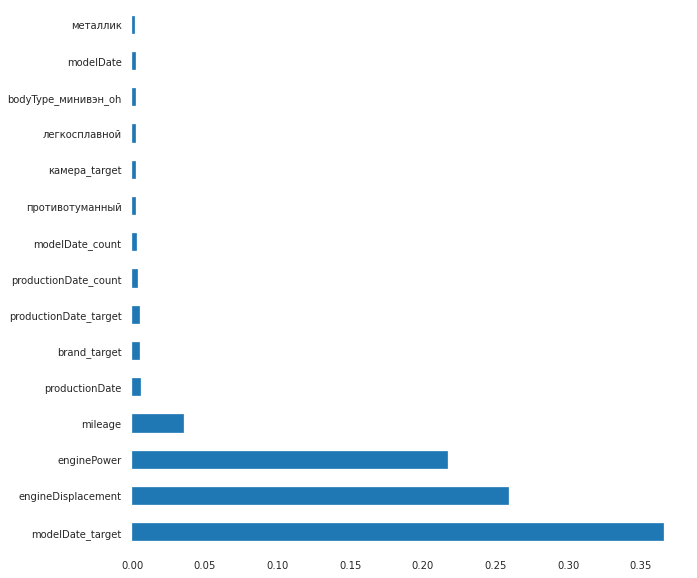

In [ ]:
forest = RandomForestRegressor(random_state = 42, n_jobs = -1)
forest.fit(X_train, y_train)

# Посмотрим на важность фич
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(forest.feature_importances_, index=X_train.columns)
feat_importances.nlargest(15).plot(kind='barh')

In [ ]:
print(f'MAPE:{mape(y_test, forest.predict(X_test))}')
print(f'R2-score:{sklearn.metrics.r2_score(y_test, forest.predict(X_test))}')

MAPE:12.315198346111687
R2-score:0.9272533717834004


Белый шум был на  седьмом-восьмом месте среди признаков. Все что ниже, теоретически можно отсечь. Можно попробовать закодировать булевые признаки на основе комплектации (ни один из которых не выстрелил) в таргет фичи и посмотреть что получится. Пришлось исключить признаки name и name_target, потому, что модель просто выучивала цены по названию автомобилей, которые несколько разные в трейне и тесте и происходил сильный оверфит. Убраная фича production date ухудшила результат на полпроцента. Добавили дамми фичи на основе категориальных характеристик типа цвета и кузова, результат улучшился на 0.3.

Обрезали до только важных:

In [ ]:
important = feat_importances.nlargest(8).index
X_train_i = X_train.loc[:,important].copy()
X_test_i = X_test.loc[:,important].copy()

In [ ]:
rf = RandomForestRegressor(random_state = 42, n_jobs = -1)
rf.fit(X_train_i, y_train)

RandomForestRegressor(n_jobs=-1, random_state=42)

In [ ]:
print(f'MAPE:{mape(y_test, rf.predict(X_test_i))}')
print(f'R2-score:{sklearn.metrics.r2_score(y_test, rf.predict(X_test_i))}')

MAPE:14.025473264910996
R2-score:0.9268639976398361


ухушилась MAPE, но подрос R2

# Stacking

In [ ]:
from sklearn.linear_model import RidgeCV, LassoCV
from sklearn.svm import LinearSVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import StackingRegressor

estimators = [
    ('rf10', RandomForestRegressor(random_state = 42, max_depth = 10, n_jobs = -1)),
    ('rf8', RandomForestRegressor(random_state = 42, max_depth = 8, n_jobs = -1)),
    ('rf6', RandomForestRegressor(random_state = 42, max_depth = 6, n_jobs = -1)),
    ('cb', CatBoostRegressor(depth = 10, random_state = 42, loss_function='MAPE',task_type = 'CPU')),
    ('lr', RidgeCV()),
    ('svr', LinearSVR(random_state=42)),
    ('lasso', LassoCV())
]

reg = StackingRegressor(
    estimators=estimators,
    final_estimator=RandomForestRegressor(n_estimators=15,
                                          random_state=42)
)

reg.fit(X_train, y_train)

0:	learn: 0.7551117	total: 248ms	remaining: 4m 8s
1:	learn: 0.7415429	total: 425ms	remaining: 3m 31s
2:	learn: 0.7324997	total: 603ms	remaining: 3m 20s
3:	learn: 0.7266191	total: 626ms	remaining: 2m 35s
4:	learn: 0.7185806	total: 803ms	remaining: 2m 39s
5:	learn: 0.7037426	total: 985ms	remaining: 2m 43s
6:	learn: 0.6980086	total: 1.16s	remaining: 2m 44s
7:	learn: 0.6900293	total: 1.35s	remaining: 2m 47s
8:	learn: 0.6807485	total: 1.53s	remaining: 2m 48s
9:	learn: 0.6761074	total: 1.71s	remaining: 2m 49s
10:	learn: 0.6714236	total: 1.89s	remaining: 2m 49s
11:	learn: 0.6610876	total: 2.07s	remaining: 2m 50s
12:	learn: 0.6523782	total: 2.25s	remaining: 2m 51s
13:	learn: 0.6464704	total: 2.44s	remaining: 2m 51s
14:	learn: 0.6408315	total: 2.62s	remaining: 2m 51s
15:	learn: 0.6347381	total: 2.8s	remaining: 2m 52s
16:	learn: 0.6257351	total: 2.98s	remaining: 2m 52s
17:	learn: 0.6181483	total: 3.16s	remaining: 2m 52s
18:	learn: 0.6147584	total: 3.34s	remaining: 2m 52s
19:	learn: 0.6083666	tot

158:	learn: 0.3503082	total: 30.3s	remaining: 2m 40s
159:	learn: 0.3499677	total: 30.5s	remaining: 2m 39s
160:	learn: 0.3497121	total: 30.6s	remaining: 2m 39s
161:	learn: 0.3492921	total: 30.8s	remaining: 2m 39s
162:	learn: 0.3467643	total: 31s	remaining: 2m 39s
163:	learn: 0.3460510	total: 31.2s	remaining: 2m 39s
164:	learn: 0.3455808	total: 31.4s	remaining: 2m 39s
165:	learn: 0.3447923	total: 31.6s	remaining: 2m 38s
166:	learn: 0.3430799	total: 31.7s	remaining: 2m 38s
167:	learn: 0.3425498	total: 31.9s	remaining: 2m 37s
168:	learn: 0.3420316	total: 32.1s	remaining: 2m 37s
169:	learn: 0.3418460	total: 32.3s	remaining: 2m 37s
170:	learn: 0.3414890	total: 32.4s	remaining: 2m 37s
171:	learn: 0.3414223	total: 32.6s	remaining: 2m 37s
172:	learn: 0.3411909	total: 32.8s	remaining: 2m 36s
173:	learn: 0.3402561	total: 33s	remaining: 2m 36s
174:	learn: 0.3398934	total: 33.2s	remaining: 2m 36s
175:	learn: 0.3396432	total: 33.3s	remaining: 2m 36s
176:	learn: 0.3394363	total: 33.5s	remaining: 2m 3

314:	learn: 0.3002481	total: 1m	remaining: 2m 11s
315:	learn: 0.3000279	total: 1m	remaining: 2m 11s
316:	learn: 0.2999697	total: 1m 1s	remaining: 2m 11s
317:	learn: 0.2998644	total: 1m 1s	remaining: 2m 11s
318:	learn: 0.2995307	total: 1m 1s	remaining: 2m 11s
319:	learn: 0.2993629	total: 1m 1s	remaining: 2m 11s
320:	learn: 0.2991000	total: 1m 1s	remaining: 2m 10s
321:	learn: 0.2989870	total: 1m 2s	remaining: 2m 10s
322:	learn: 0.2989162	total: 1m 2s	remaining: 2m 10s
323:	learn: 0.2987620	total: 1m 2s	remaining: 2m 10s
324:	learn: 0.2986890	total: 1m 2s	remaining: 2m 9s
325:	learn: 0.2984973	total: 1m 2s	remaining: 2m 9s
326:	learn: 0.2982764	total: 1m 2s	remaining: 2m 9s
327:	learn: 0.2981666	total: 1m 3s	remaining: 2m 9s
328:	learn: 0.2979402	total: 1m 3s	remaining: 2m 9s
329:	learn: 0.2978437	total: 1m 3s	remaining: 2m 8s
330:	learn: 0.2976942	total: 1m 3s	remaining: 2m 8s
331:	learn: 0.2975582	total: 1m 3s	remaining: 2m 8s
332:	learn: 0.2974238	total: 1m 4s	remaining: 2m 8s
333:	lea

469:	learn: 0.2861261	total: 1m 30s	remaining: 1m 42s
470:	learn: 0.2861058	total: 1m 30s	remaining: 1m 42s
471:	learn: 0.2860316	total: 1m 31s	remaining: 1m 41s
472:	learn: 0.2859676	total: 1m 31s	remaining: 1m 41s
473:	learn: 0.2859347	total: 1m 31s	remaining: 1m 41s
474:	learn: 0.2859140	total: 1m 31s	remaining: 1m 41s
475:	learn: 0.2858521	total: 1m 31s	remaining: 1m 41s
476:	learn: 0.2858298	total: 1m 32s	remaining: 1m 40s
477:	learn: 0.2858023	total: 1m 32s	remaining: 1m 40s
478:	learn: 0.2857759	total: 1m 32s	remaining: 1m 40s
479:	learn: 0.2857244	total: 1m 32s	remaining: 1m 40s
480:	learn: 0.2856722	total: 1m 33s	remaining: 1m 40s
481:	learn: 0.2856495	total: 1m 33s	remaining: 1m 40s
482:	learn: 0.2856132	total: 1m 33s	remaining: 1m 40s
483:	learn: 0.2855960	total: 1m 33s	remaining: 1m 40s
484:	learn: 0.2855485	total: 1m 34s	remaining: 1m 39s
485:	learn: 0.2855155	total: 1m 34s	remaining: 1m 39s
486:	learn: 0.2854484	total: 1m 34s	remaining: 1m 39s
487:	learn: 0.2854069	total:

623:	learn: 0.2797193	total: 2m 1s	remaining: 1m 13s
624:	learn: 0.2797052	total: 2m 1s	remaining: 1m 12s
625:	learn: 0.2796285	total: 2m 1s	remaining: 1m 12s
626:	learn: 0.2794659	total: 2m 1s	remaining: 1m 12s
627:	learn: 0.2794440	total: 2m 2s	remaining: 1m 12s
628:	learn: 0.2794168	total: 2m 2s	remaining: 1m 12s
629:	learn: 0.2793947	total: 2m 2s	remaining: 1m 11s
630:	learn: 0.2793722	total: 2m 2s	remaining: 1m 11s
631:	learn: 0.2793570	total: 2m 2s	remaining: 1m 11s
632:	learn: 0.2793464	total: 2m 2s	remaining: 1m 11s
633:	learn: 0.2793269	total: 2m 3s	remaining: 1m 11s
634:	learn: 0.2793037	total: 2m 3s	remaining: 1m 10s
635:	learn: 0.2792765	total: 2m 3s	remaining: 1m 10s
636:	learn: 0.2792675	total: 2m 3s	remaining: 1m 10s
637:	learn: 0.2792545	total: 2m 3s	remaining: 1m 10s
638:	learn: 0.2792017	total: 2m 4s	remaining: 1m 10s
639:	learn: 0.2791940	total: 2m 4s	remaining: 1m 9s
640:	learn: 0.2791521	total: 2m 4s	remaining: 1m 9s
641:	learn: 0.2791452	total: 2m 4s	remaining: 1m

780:	learn: 0.2738306	total: 2m 32s	remaining: 42.7s
781:	learn: 0.2738249	total: 2m 32s	remaining: 42.5s
782:	learn: 0.2737681	total: 2m 32s	remaining: 42.3s
783:	learn: 0.2737509	total: 2m 32s	remaining: 42.1s
784:	learn: 0.2736469	total: 2m 32s	remaining: 41.9s
785:	learn: 0.2736281	total: 2m 33s	remaining: 41.7s
786:	learn: 0.2735495	total: 2m 33s	remaining: 41.5s
787:	learn: 0.2734602	total: 2m 33s	remaining: 41.3s
788:	learn: 0.2734538	total: 2m 33s	remaining: 41.1s
789:	learn: 0.2734484	total: 2m 33s	remaining: 40.9s
790:	learn: 0.2734383	total: 2m 34s	remaining: 40.7s
791:	learn: 0.2734305	total: 2m 34s	remaining: 40.5s
792:	learn: 0.2734205	total: 2m 34s	remaining: 40.3s
793:	learn: 0.2733972	total: 2m 34s	remaining: 40.1s
794:	learn: 0.2733889	total: 2m 34s	remaining: 39.9s
795:	learn: 0.2733794	total: 2m 34s	remaining: 39.7s
796:	learn: 0.2733620	total: 2m 35s	remaining: 39.5s
797:	learn: 0.2733410	total: 2m 35s	remaining: 39.3s
798:	learn: 0.2733289	total: 2m 35s	remaining:

936:	learn: 0.2649474	total: 3m 2s	remaining: 12.3s
937:	learn: 0.2648654	total: 3m 3s	remaining: 12.1s
938:	learn: 0.2648551	total: 3m 3s	remaining: 11.9s
939:	learn: 0.2648501	total: 3m 3s	remaining: 11.7s
940:	learn: 0.2648378	total: 3m 3s	remaining: 11.5s
941:	learn: 0.2648327	total: 3m 3s	remaining: 11.3s
942:	learn: 0.2648043	total: 3m 4s	remaining: 11.1s
943:	learn: 0.2648045	total: 3m 4s	remaining: 10.9s
944:	learn: 0.2647776	total: 3m 4s	remaining: 10.7s
945:	learn: 0.2647766	total: 3m 4s	remaining: 10.5s
946:	learn: 0.2646154	total: 3m 4s	remaining: 10.3s
947:	learn: 0.2646106	total: 3m 4s	remaining: 10.1s
948:	learn: 0.2645713	total: 3m 5s	remaining: 9.95s
949:	learn: 0.2645704	total: 3m 5s	remaining: 9.75s
950:	learn: 0.2645635	total: 3m 5s	remaining: 9.56s
951:	learn: 0.2630510	total: 3m 5s	remaining: 9.36s
952:	learn: 0.2630468	total: 3m 5s	remaining: 9.17s
953:	learn: 0.2630414	total: 3m 6s	remaining: 8.97s
954:	learn: 0.2630387	total: 3m 6s	remaining: 8.78s
955:	learn: 

95:	learn: 0.4011128	total: 17.2s	remaining: 2m 41s
96:	learn: 0.4003187	total: 17.4s	remaining: 2m 41s
97:	learn: 0.3983070	total: 17.5s	remaining: 2m 41s
98:	learn: 0.3964730	total: 17.7s	remaining: 2m 41s
99:	learn: 0.3951684	total: 17.9s	remaining: 2m 41s
100:	learn: 0.3941553	total: 18.1s	remaining: 2m 40s
101:	learn: 0.3905184	total: 18.3s	remaining: 2m 40s
102:	learn: 0.3891945	total: 18.4s	remaining: 2m 40s
103:	learn: 0.3882168	total: 18.6s	remaining: 2m 40s
104:	learn: 0.3858795	total: 18.8s	remaining: 2m 40s
105:	learn: 0.3850637	total: 19s	remaining: 2m 39s
106:	learn: 0.3849797	total: 19.1s	remaining: 2m 39s
107:	learn: 0.3828077	total: 19.3s	remaining: 2m 39s
108:	learn: 0.3819541	total: 19.5s	remaining: 2m 39s
109:	learn: 0.3812324	total: 19.7s	remaining: 2m 39s
110:	learn: 0.3802054	total: 19.9s	remaining: 2m 39s
111:	learn: 0.3791789	total: 20s	remaining: 2m 38s
112:	learn: 0.3766509	total: 20.2s	remaining: 2m 38s
113:	learn: 0.3758082	total: 20.4s	remaining: 2m 38s
11

251:	learn: 0.2977555	total: 47.3s	remaining: 2m 20s
252:	learn: 0.2975135	total: 47.5s	remaining: 2m 20s
253:	learn: 0.2974052	total: 47.7s	remaining: 2m 20s
254:	learn: 0.2971264	total: 47.9s	remaining: 2m 19s
255:	learn: 0.2965985	total: 48s	remaining: 2m 19s
256:	learn: 0.2962588	total: 48.2s	remaining: 2m 19s
257:	learn: 0.2961073	total: 48.4s	remaining: 2m 19s
258:	learn: 0.2959893	total: 48.6s	remaining: 2m 18s
259:	learn: 0.2958422	total: 48.8s	remaining: 2m 18s
260:	learn: 0.2951146	total: 48.9s	remaining: 2m 18s
261:	learn: 0.2950660	total: 49.1s	remaining: 2m 18s
262:	learn: 0.2949708	total: 49.3s	remaining: 2m 18s
263:	learn: 0.2942564	total: 49.5s	remaining: 2m 17s
264:	learn: 0.2941357	total: 49.6s	remaining: 2m 17s
265:	learn: 0.2939664	total: 49.8s	remaining: 2m 17s
266:	learn: 0.2938988	total: 50s	remaining: 2m 17s
267:	learn: 0.2930618	total: 50.2s	remaining: 2m 17s
268:	learn: 0.2929827	total: 50.4s	remaining: 2m 16s
269:	learn: 0.2928987	total: 50.5s	remaining: 2m 1

407:	learn: 0.2747921	total: 1m 19s	remaining: 1m 55s
408:	learn: 0.2746564	total: 1m 19s	remaining: 1m 54s
409:	learn: 0.2745977	total: 1m 19s	remaining: 1m 54s
410:	learn: 0.2745153	total: 1m 19s	remaining: 1m 54s
411:	learn: 0.2744746	total: 1m 20s	remaining: 1m 54s
412:	learn: 0.2744372	total: 1m 20s	remaining: 1m 54s
413:	learn: 0.2744094	total: 1m 20s	remaining: 1m 53s
414:	learn: 0.2743774	total: 1m 20s	remaining: 1m 53s
415:	learn: 0.2742538	total: 1m 20s	remaining: 1m 53s
416:	learn: 0.2742178	total: 1m 21s	remaining: 1m 53s
417:	learn: 0.2741237	total: 1m 21s	remaining: 1m 53s
418:	learn: 0.2740944	total: 1m 21s	remaining: 1m 52s
419:	learn: 0.2740092	total: 1m 21s	remaining: 1m 52s
420:	learn: 0.2739527	total: 1m 21s	remaining: 1m 52s
421:	learn: 0.2739301	total: 1m 22s	remaining: 1m 52s
422:	learn: 0.2738394	total: 1m 22s	remaining: 1m 52s
423:	learn: 0.2737402	total: 1m 22s	remaining: 1m 52s
424:	learn: 0.2736862	total: 1m 22s	remaining: 1m 51s
425:	learn: 0.2736040	total:

559:	learn: 0.2668725	total: 1m 51s	remaining: 1m 27s
560:	learn: 0.2668570	total: 1m 52s	remaining: 1m 27s
561:	learn: 0.2668343	total: 1m 52s	remaining: 1m 27s
562:	learn: 0.2659319	total: 1m 52s	remaining: 1m 27s
563:	learn: 0.2659156	total: 1m 52s	remaining: 1m 27s
564:	learn: 0.2658984	total: 1m 53s	remaining: 1m 27s
565:	learn: 0.2658817	total: 1m 53s	remaining: 1m 26s
566:	learn: 0.2658727	total: 1m 53s	remaining: 1m 26s
567:	learn: 0.2658410	total: 1m 53s	remaining: 1m 26s
568:	learn: 0.2657079	total: 1m 53s	remaining: 1m 26s
569:	learn: 0.2656925	total: 1m 54s	remaining: 1m 26s
570:	learn: 0.2656482	total: 1m 54s	remaining: 1m 25s
571:	learn: 0.2656034	total: 1m 54s	remaining: 1m 25s
572:	learn: 0.2655455	total: 1m 54s	remaining: 1m 25s
573:	learn: 0.2655355	total: 1m 54s	remaining: 1m 25s
574:	learn: 0.2654774	total: 1m 55s	remaining: 1m 25s
575:	learn: 0.2654573	total: 1m 55s	remaining: 1m 24s
576:	learn: 0.2654170	total: 1m 55s	remaining: 1m 24s
577:	learn: 0.2653917	total:

715:	learn: 0.2601020	total: 2m 26s	remaining: 57.9s
716:	learn: 0.2600965	total: 2m 26s	remaining: 57.7s
717:	learn: 0.2600860	total: 2m 26s	remaining: 57.5s
718:	learn: 0.2600679	total: 2m 26s	remaining: 57.3s
719:	learn: 0.2600578	total: 2m 26s	remaining: 57.1s
720:	learn: 0.2600531	total: 2m 27s	remaining: 56.9s
721:	learn: 0.2600102	total: 2m 27s	remaining: 56.7s
722:	learn: 0.2600004	total: 2m 27s	remaining: 56.5s
723:	learn: 0.2599927	total: 2m 27s	remaining: 56.3s
724:	learn: 0.2599684	total: 2m 27s	remaining: 56.1s
725:	learn: 0.2599639	total: 2m 28s	remaining: 55.9s
726:	learn: 0.2599460	total: 2m 28s	remaining: 55.7s
727:	learn: 0.2599312	total: 2m 28s	remaining: 55.5s
728:	learn: 0.2599123	total: 2m 28s	remaining: 55.3s
729:	learn: 0.2599006	total: 2m 28s	remaining: 55.1s
730:	learn: 0.2598901	total: 2m 29s	remaining: 54.8s
731:	learn: 0.2598608	total: 2m 29s	remaining: 54.6s
732:	learn: 0.2596508	total: 2m 29s	remaining: 54.4s
733:	learn: 0.2596429	total: 2m 29s	remaining:

871:	learn: 0.2538840	total: 2m 59s	remaining: 26.4s
872:	learn: 0.2538837	total: 2m 59s	remaining: 26.1s
873:	learn: 0.2538710	total: 2m 59s	remaining: 25.9s
874:	learn: 0.2538394	total: 3m	remaining: 25.7s
875:	learn: 0.2538370	total: 3m	remaining: 25.5s
876:	learn: 0.2538287	total: 3m	remaining: 25.3s
877:	learn: 0.2538265	total: 3m	remaining: 25.1s
878:	learn: 0.2538261	total: 3m	remaining: 24.9s
879:	learn: 0.2538193	total: 3m 1s	remaining: 24.7s
880:	learn: 0.2538176	total: 3m 1s	remaining: 24.5s
881:	learn: 0.2538071	total: 3m 1s	remaining: 24.3s
882:	learn: 0.2537913	total: 3m 1s	remaining: 24.1s
883:	learn: 0.2537847	total: 3m 1s	remaining: 23.9s
884:	learn: 0.2537749	total: 3m 2s	remaining: 23.7s
885:	learn: 0.2537639	total: 3m 2s	remaining: 23.5s
886:	learn: 0.2526276	total: 3m 2s	remaining: 23.3s
887:	learn: 0.2526231	total: 3m 2s	remaining: 23.1s
888:	learn: 0.2526174	total: 3m 2s	remaining: 22.8s
889:	learn: 0.2526081	total: 3m 3s	remaining: 22.6s
890:	learn: 0.2525945	to

29:	learn: 0.5156741	total: 6.88s	remaining: 3m 42s
30:	learn: 0.5128066	total: 7.09s	remaining: 3m 41s
31:	learn: 0.5100137	total: 7.3s	remaining: 3m 40s
32:	learn: 0.5080078	total: 7.51s	remaining: 3m 40s
33:	learn: 0.5071900	total: 7.55s	remaining: 3m 34s
34:	learn: 0.5000516	total: 7.76s	remaining: 3m 33s
35:	learn: 0.4945114	total: 7.97s	remaining: 3m 33s
36:	learn: 0.4922529	total: 8.18s	remaining: 3m 32s
37:	learn: 0.4847523	total: 8.39s	remaining: 3m 32s
38:	learn: 0.4830861	total: 8.6s	remaining: 3m 31s
39:	learn: 0.4769924	total: 8.8s	remaining: 3m 31s
40:	learn: 0.4733855	total: 9.01s	remaining: 3m 30s
41:	learn: 0.4716240	total: 9.22s	remaining: 3m 30s
42:	learn: 0.4692796	total: 9.43s	remaining: 3m 29s
43:	learn: 0.4645669	total: 9.64s	remaining: 3m 29s
44:	learn: 0.4582698	total: 9.85s	remaining: 3m 28s
45:	learn: 0.4566071	total: 10.1s	remaining: 3m 28s
46:	learn: 0.4539640	total: 10.3s	remaining: 3m 28s
47:	learn: 0.4534297	total: 10.3s	remaining: 3m 24s
48:	learn: 0.45

187:	learn: 0.3015993	total: 41.1s	remaining: 2m 57s
188:	learn: 0.3011708	total: 41.3s	remaining: 2m 57s
189:	learn: 0.3003200	total: 41.5s	remaining: 2m 56s
190:	learn: 0.3002245	total: 41.7s	remaining: 2m 56s
191:	learn: 0.2998329	total: 41.9s	remaining: 2m 56s
192:	learn: 0.2997785	total: 42.1s	remaining: 2m 55s
193:	learn: 0.2995030	total: 42.3s	remaining: 2m 55s
194:	learn: 0.2989761	total: 42.4s	remaining: 2m 55s
195:	learn: 0.2984691	total: 42.6s	remaining: 2m 54s
196:	learn: 0.2981142	total: 42.8s	remaining: 2m 54s
197:	learn: 0.2977115	total: 43s	remaining: 2m 54s
198:	learn: 0.2976212	total: 43.2s	remaining: 2m 53s
199:	learn: 0.2974506	total: 43.4s	remaining: 2m 53s
200:	learn: 0.2969705	total: 43.6s	remaining: 2m 53s
201:	learn: 0.2965356	total: 43.8s	remaining: 2m 53s
202:	learn: 0.2964030	total: 44s	remaining: 2m 52s
203:	learn: 0.2956566	total: 44.2s	remaining: 2m 52s
204:	learn: 0.2951195	total: 44.4s	remaining: 2m 52s
205:	learn: 0.2946430	total: 44.6s	remaining: 2m 5

343:	learn: 0.2608154	total: 1m 13s	remaining: 2m 20s
344:	learn: 0.2607136	total: 1m 13s	remaining: 2m 20s
345:	learn: 0.2605717	total: 1m 13s	remaining: 2m 19s
346:	learn: 0.2604821	total: 1m 14s	remaining: 2m 19s
347:	learn: 0.2603786	total: 1m 14s	remaining: 2m 19s
348:	learn: 0.2601744	total: 1m 14s	remaining: 2m 19s
349:	learn: 0.2601156	total: 1m 14s	remaining: 2m 18s
350:	learn: 0.2599878	total: 1m 14s	remaining: 2m 18s
351:	learn: 0.2598328	total: 1m 15s	remaining: 2m 18s
352:	learn: 0.2597067	total: 1m 15s	remaining: 2m 17s
353:	learn: 0.2595875	total: 1m 15s	remaining: 2m 17s
354:	learn: 0.2594629	total: 1m 15s	remaining: 2m 17s
355:	learn: 0.2593036	total: 1m 15s	remaining: 2m 17s
356:	learn: 0.2592267	total: 1m 16s	remaining: 2m 16s
357:	learn: 0.2591222	total: 1m 16s	remaining: 2m 16s
358:	learn: 0.2590457	total: 1m 16s	remaining: 2m 16s
359:	learn: 0.2589567	total: 1m 16s	remaining: 2m 16s
360:	learn: 0.2588700	total: 1m 16s	remaining: 2m 15s
361:	learn: 0.2587700	total:

497:	learn: 0.2494079	total: 1m 43s	remaining: 1m 44s
498:	learn: 0.2493810	total: 1m 43s	remaining: 1m 44s
499:	learn: 0.2493281	total: 1m 44s	remaining: 1m 44s
500:	learn: 0.2492614	total: 1m 44s	remaining: 1m 43s
501:	learn: 0.2492394	total: 1m 44s	remaining: 1m 43s
502:	learn: 0.2492002	total: 1m 44s	remaining: 1m 43s
503:	learn: 0.2491656	total: 1m 44s	remaining: 1m 43s
504:	learn: 0.2491350	total: 1m 44s	remaining: 1m 42s
505:	learn: 0.2491045	total: 1m 45s	remaining: 1m 42s
506:	learn: 0.2490970	total: 1m 45s	remaining: 1m 42s
507:	learn: 0.2489363	total: 1m 45s	remaining: 1m 42s
508:	learn: 0.2489198	total: 1m 45s	remaining: 1m 41s
509:	learn: 0.2487975	total: 1m 45s	remaining: 1m 41s
510:	learn: 0.2487271	total: 1m 45s	remaining: 1m 41s
511:	learn: 0.2486930	total: 1m 46s	remaining: 1m 41s
512:	learn: 0.2486725	total: 1m 46s	remaining: 1m 40s
513:	learn: 0.2486029	total: 1m 46s	remaining: 1m 40s
514:	learn: 0.2485776	total: 1m 46s	remaining: 1m 40s
515:	learn: 0.2485174	total:

651:	learn: 0.2369493	total: 2m 12s	remaining: 1m 10s
652:	learn: 0.2369331	total: 2m 13s	remaining: 1m 10s
653:	learn: 0.2368677	total: 2m 13s	remaining: 1m 10s
654:	learn: 0.2368486	total: 2m 13s	remaining: 1m 10s
655:	learn: 0.2367156	total: 2m 13s	remaining: 1m 10s
656:	learn: 0.2365919	total: 2m 14s	remaining: 1m 10s
657:	learn: 0.2365779	total: 2m 14s	remaining: 1m 9s
658:	learn: 0.2365587	total: 2m 14s	remaining: 1m 9s
659:	learn: 0.2365276	total: 2m 14s	remaining: 1m 9s
660:	learn: 0.2365053	total: 2m 15s	remaining: 1m 9s
661:	learn: 0.2364927	total: 2m 15s	remaining: 1m 9s
662:	learn: 0.2363022	total: 2m 15s	remaining: 1m 8s
663:	learn: 0.2360897	total: 2m 15s	remaining: 1m 8s
664:	learn: 0.2360627	total: 2m 15s	remaining: 1m 8s
665:	learn: 0.2359857	total: 2m 15s	remaining: 1m 8s
666:	learn: 0.2359565	total: 2m 16s	remaining: 1m 7s
667:	learn: 0.2359378	total: 2m 16s	remaining: 1m 7s
668:	learn: 0.2358909	total: 2m 16s	remaining: 1m 7s
669:	learn: 0.2358749	total: 2m 16s	rema

808:	learn: 0.2310022	total: 2m 43s	remaining: 38.6s
809:	learn: 0.2309942	total: 2m 43s	remaining: 38.4s
810:	learn: 0.2309792	total: 2m 43s	remaining: 38.2s
811:	learn: 0.2309767	total: 2m 44s	remaining: 38s
812:	learn: 0.2309394	total: 2m 44s	remaining: 37.8s
813:	learn: 0.2309229	total: 2m 44s	remaining: 37.6s
814:	learn: 0.2308898	total: 2m 44s	remaining: 37.4s
815:	learn: 0.2308861	total: 2m 44s	remaining: 37.2s
816:	learn: 0.2308802	total: 2m 44s	remaining: 36.9s
817:	learn: 0.2308752	total: 2m 45s	remaining: 36.7s
818:	learn: 0.2308369	total: 2m 45s	remaining: 36.5s
819:	learn: 0.2308208	total: 2m 45s	remaining: 36.3s
820:	learn: 0.2308114	total: 2m 45s	remaining: 36.1s
821:	learn: 0.2308063	total: 2m 45s	remaining: 35.9s
822:	learn: 0.2307919	total: 2m 46s	remaining: 35.7s
823:	learn: 0.2307909	total: 2m 46s	remaining: 35.5s
824:	learn: 0.2307748	total: 2m 46s	remaining: 35.3s
825:	learn: 0.2307665	total: 2m 46s	remaining: 35.2s
826:	learn: 0.2307585	total: 2m 47s	remaining: 3

966:	learn: 0.2279112	total: 3m 13s	remaining: 6.6s
967:	learn: 0.2279053	total: 3m 13s	remaining: 6.4s
968:	learn: 0.2278863	total: 3m 13s	remaining: 6.2s
969:	learn: 0.2278770	total: 3m 14s	remaining: 6s
970:	learn: 0.2278728	total: 3m 14s	remaining: 5.8s
971:	learn: 0.2278672	total: 3m 14s	remaining: 5.6s
972:	learn: 0.2278549	total: 3m 14s	remaining: 5.4s
973:	learn: 0.2278502	total: 3m 14s	remaining: 5.2s
974:	learn: 0.2278476	total: 3m 15s	remaining: 5s
975:	learn: 0.2278347	total: 3m 15s	remaining: 4.81s
976:	learn: 0.2278109	total: 3m 15s	remaining: 4.61s
977:	learn: 0.2278091	total: 3m 16s	remaining: 4.41s
978:	learn: 0.2277947	total: 3m 16s	remaining: 4.21s
979:	learn: 0.2277855	total: 3m 16s	remaining: 4.01s
980:	learn: 0.2277756	total: 3m 16s	remaining: 3.81s
981:	learn: 0.2277680	total: 3m 16s	remaining: 3.61s
982:	learn: 0.2277552	total: 3m 16s	remaining: 3.4s
983:	learn: 0.2277514	total: 3m 17s	remaining: 3.2s
984:	learn: 0.2277424	total: 3m 17s	remaining: 3s
985:	learn:

125:	learn: 0.3731985	total: 22.9s	remaining: 2m 38s
126:	learn: 0.3727954	total: 23.1s	remaining: 2m 38s
127:	learn: 0.3714083	total: 23.2s	remaining: 2m 38s
128:	learn: 0.3698703	total: 23.4s	remaining: 2m 38s
129:	learn: 0.3668857	total: 23.6s	remaining: 2m 37s
130:	learn: 0.3663983	total: 23.8s	remaining: 2m 37s
131:	learn: 0.3660608	total: 24s	remaining: 2m 37s
132:	learn: 0.3660416	total: 24s	remaining: 2m 36s
133:	learn: 0.3653663	total: 24.2s	remaining: 2m 36s
134:	learn: 0.3651158	total: 24.4s	remaining: 2m 36s
135:	learn: 0.3624021	total: 24.5s	remaining: 2m 35s
136:	learn: 0.3616615	total: 24.7s	remaining: 2m 35s
137:	learn: 0.3601501	total: 24.9s	remaining: 2m 35s
138:	learn: 0.3589150	total: 25.1s	remaining: 2m 35s
139:	learn: 0.3586056	total: 25.3s	remaining: 2m 35s
140:	learn: 0.3583298	total: 25.4s	remaining: 2m 34s
141:	learn: 0.3581051	total: 25.6s	remaining: 2m 34s
142:	learn: 0.3578097	total: 25.8s	remaining: 2m 34s
143:	learn: 0.3573971	total: 26s	remaining: 2m 34s

281:	learn: 0.2969867	total: 52.6s	remaining: 2m 13s
282:	learn: 0.2968960	total: 52.8s	remaining: 2m 13s
283:	learn: 0.2967999	total: 53s	remaining: 2m 13s
284:	learn: 0.2967480	total: 53.2s	remaining: 2m 13s
285:	learn: 0.2964355	total: 53.5s	remaining: 2m 13s
286:	learn: 0.2963935	total: 53.8s	remaining: 2m 13s
287:	learn: 0.2962717	total: 54.1s	remaining: 2m 13s
288:	learn: 0.2960340	total: 54.3s	remaining: 2m 13s
289:	learn: 0.2959080	total: 54.6s	remaining: 2m 13s
290:	learn: 0.2957624	total: 54.8s	remaining: 2m 13s
291:	learn: 0.2956560	total: 55s	remaining: 2m 13s
292:	learn: 0.2954535	total: 55.2s	remaining: 2m 13s
293:	learn: 0.2953460	total: 55.4s	remaining: 2m 12s
294:	learn: 0.2952186	total: 55.5s	remaining: 2m 12s
295:	learn: 0.2949743	total: 55.7s	remaining: 2m 12s
296:	learn: 0.2947861	total: 55.9s	remaining: 2m 12s
297:	learn: 0.2945921	total: 56.1s	remaining: 2m 12s
298:	learn: 0.2944308	total: 56.3s	remaining: 2m 11s
299:	learn: 0.2943402	total: 56.4s	remaining: 2m 1

438:	learn: 0.2806963	total: 1m 23s	remaining: 1m 46s
439:	learn: 0.2806455	total: 1m 23s	remaining: 1m 46s
440:	learn: 0.2805970	total: 1m 24s	remaining: 1m 46s
441:	learn: 0.2805181	total: 1m 24s	remaining: 1m 46s
442:	learn: 0.2804851	total: 1m 24s	remaining: 1m 46s
443:	learn: 0.2804480	total: 1m 24s	remaining: 1m 45s
444:	learn: 0.2803768	total: 1m 24s	remaining: 1m 45s
445:	learn: 0.2803408	total: 1m 24s	remaining: 1m 45s
446:	learn: 0.2802938	total: 1m 25s	remaining: 1m 45s
447:	learn: 0.2802683	total: 1m 25s	remaining: 1m 45s
448:	learn: 0.2802241	total: 1m 25s	remaining: 1m 44s
449:	learn: 0.2801694	total: 1m 25s	remaining: 1m 44s
450:	learn: 0.2800900	total: 1m 25s	remaining: 1m 44s
451:	learn: 0.2800745	total: 1m 26s	remaining: 1m 44s
452:	learn: 0.2800255	total: 1m 26s	remaining: 1m 44s
453:	learn: 0.2799982	total: 1m 26s	remaining: 1m 44s
454:	learn: 0.2799805	total: 1m 26s	remaining: 1m 43s
455:	learn: 0.2799639	total: 1m 27s	remaining: 1m 43s
456:	learn: 0.2799229	total:

591:	learn: 0.2747787	total: 1m 53s	remaining: 1m 18s
592:	learn: 0.2747696	total: 1m 53s	remaining: 1m 18s
593:	learn: 0.2747616	total: 1m 54s	remaining: 1m 17s
594:	learn: 0.2747485	total: 1m 54s	remaining: 1m 17s
595:	learn: 0.2747415	total: 1m 54s	remaining: 1m 17s
596:	learn: 0.2747226	total: 1m 54s	remaining: 1m 17s
597:	learn: 0.2747059	total: 1m 54s	remaining: 1m 17s
598:	learn: 0.2747007	total: 1m 54s	remaining: 1m 16s
599:	learn: 0.2745696	total: 1m 55s	remaining: 1m 16s
600:	learn: 0.2745525	total: 1m 55s	remaining: 1m 16s
601:	learn: 0.2745441	total: 1m 55s	remaining: 1m 16s
602:	learn: 0.2745158	total: 1m 55s	remaining: 1m 16s
603:	learn: 0.2745028	total: 1m 55s	remaining: 1m 15s
604:	learn: 0.2744879	total: 1m 56s	remaining: 1m 15s
605:	learn: 0.2744698	total: 1m 56s	remaining: 1m 15s
606:	learn: 0.2744644	total: 1m 56s	remaining: 1m 15s
607:	learn: 0.2744550	total: 1m 56s	remaining: 1m 15s
608:	learn: 0.2744388	total: 1m 56s	remaining: 1m 14s
609:	learn: 0.2744063	total:

748:	learn: 0.2686462	total: 2m 24s	remaining: 48.3s
749:	learn: 0.2686384	total: 2m 24s	remaining: 48.1s
750:	learn: 0.2670766	total: 2m 24s	remaining: 47.9s
751:	learn: 0.2670465	total: 2m 24s	remaining: 47.7s
752:	learn: 0.2670385	total: 2m 24s	remaining: 47.5s
753:	learn: 0.2670227	total: 2m 24s	remaining: 47.3s
754:	learn: 0.2669671	total: 2m 25s	remaining: 47.1s
755:	learn: 0.2669563	total: 2m 25s	remaining: 46.9s
756:	learn: 0.2669405	total: 2m 25s	remaining: 46.7s
757:	learn: 0.2669244	total: 2m 25s	remaining: 46.5s
758:	learn: 0.2669142	total: 2m 25s	remaining: 46.3s
759:	learn: 0.2668990	total: 2m 26s	remaining: 46.1s
760:	learn: 0.2668731	total: 2m 26s	remaining: 45.9s
761:	learn: 0.2668376	total: 2m 26s	remaining: 45.7s
762:	learn: 0.2668252	total: 2m 26s	remaining: 45.5s
763:	learn: 0.2668079	total: 2m 26s	remaining: 45.3s
764:	learn: 0.2668034	total: 2m 26s	remaining: 45.1s
765:	learn: 0.2667778	total: 2m 27s	remaining: 44.9s
766:	learn: 0.2667594	total: 2m 27s	remaining:

905:	learn: 0.2619857	total: 2m 54s	remaining: 18.1s
906:	learn: 0.2619818	total: 2m 54s	remaining: 17.9s
907:	learn: 0.2619808	total: 2m 54s	remaining: 17.7s
908:	learn: 0.2619431	total: 2m 55s	remaining: 17.5s
909:	learn: 0.2619235	total: 2m 55s	remaining: 17.3s
910:	learn: 0.2618617	total: 2m 55s	remaining: 17.1s
911:	learn: 0.2618398	total: 2m 55s	remaining: 17s
912:	learn: 0.2618375	total: 2m 55s	remaining: 16.8s
913:	learn: 0.2618229	total: 2m 56s	remaining: 16.6s
914:	learn: 0.2618162	total: 2m 56s	remaining: 16.4s
915:	learn: 0.2617565	total: 2m 56s	remaining: 16.2s
916:	learn: 0.2617423	total: 2m 56s	remaining: 16s
917:	learn: 0.2617357	total: 2m 56s	remaining: 15.8s
918:	learn: 0.2617232	total: 2m 56s	remaining: 15.6s
919:	learn: 0.2617188	total: 2m 57s	remaining: 15.4s
920:	learn: 0.2617166	total: 2m 57s	remaining: 15.2s
921:	learn: 0.2616859	total: 2m 57s	remaining: 15s
922:	learn: 0.2616789	total: 2m 57s	remaining: 14.8s
923:	learn: 0.2616762	total: 2m 57s	remaining: 14.6s

64:	learn: 0.4387426	total: 11.9s	remaining: 2m 51s
65:	learn: 0.4368754	total: 12.1s	remaining: 2m 51s
66:	learn: 0.4364824	total: 12.3s	remaining: 2m 50s
67:	learn: 0.4362305	total: 12.4s	remaining: 2m 50s
68:	learn: 0.4358217	total: 12.6s	remaining: 2m 50s
69:	learn: 0.4340668	total: 12.8s	remaining: 2m 49s
70:	learn: 0.4335630	total: 12.8s	remaining: 2m 47s
71:	learn: 0.4320144	total: 13s	remaining: 2m 47s
72:	learn: 0.4303541	total: 13.2s	remaining: 2m 47s
73:	learn: 0.4268734	total: 13.4s	remaining: 2m 47s
74:	learn: 0.4238063	total: 13.5s	remaining: 2m 47s
75:	learn: 0.4233309	total: 13.7s	remaining: 2m 46s
76:	learn: 0.4223139	total: 13.9s	remaining: 2m 46s
77:	learn: 0.4206827	total: 14.1s	remaining: 2m 46s
78:	learn: 0.4193853	total: 14.3s	remaining: 2m 46s
79:	learn: 0.4175321	total: 14.5s	remaining: 2m 46s
80:	learn: 0.4166259	total: 14.8s	remaining: 2m 47s
81:	learn: 0.4165006	total: 15.1s	remaining: 2m 48s
82:	learn: 0.4142419	total: 15.4s	remaining: 2m 49s
83:	learn: 0.4

220:	learn: 0.2980181	total: 41.6s	remaining: 2m 26s
221:	learn: 0.2973550	total: 41.8s	remaining: 2m 26s
222:	learn: 0.2971938	total: 41.9s	remaining: 2m 26s
223:	learn: 0.2969772	total: 42.1s	remaining: 2m 25s
224:	learn: 0.2969417	total: 42.3s	remaining: 2m 25s
225:	learn: 0.2967300	total: 42.5s	remaining: 2m 25s
226:	learn: 0.2963618	total: 42.6s	remaining: 2m 25s
227:	learn: 0.2961645	total: 42.8s	remaining: 2m 24s
228:	learn: 0.2957544	total: 43s	remaining: 2m 24s
229:	learn: 0.2954905	total: 43.2s	remaining: 2m 24s
230:	learn: 0.2953934	total: 43.4s	remaining: 2m 24s
231:	learn: 0.2950517	total: 43.5s	remaining: 2m 24s
232:	learn: 0.2946492	total: 43.7s	remaining: 2m 23s
233:	learn: 0.2944424	total: 43.9s	remaining: 2m 23s
234:	learn: 0.2934901	total: 44.1s	remaining: 2m 23s
235:	learn: 0.2927791	total: 44.2s	remaining: 2m 23s
236:	learn: 0.2925201	total: 44.4s	remaining: 2m 23s
237:	learn: 0.2921655	total: 44.6s	remaining: 2m 22s
238:	learn: 0.2919918	total: 44.8s	remaining: 2m

377:	learn: 0.2686334	total: 1m 11s	remaining: 1m 58s
378:	learn: 0.2685900	total: 1m 11s	remaining: 1m 57s
379:	learn: 0.2685375	total: 1m 12s	remaining: 1m 57s
380:	learn: 0.2683884	total: 1m 12s	remaining: 1m 57s
381:	learn: 0.2683270	total: 1m 12s	remaining: 1m 57s
382:	learn: 0.2682241	total: 1m 12s	remaining: 1m 56s
383:	learn: 0.2681244	total: 1m 12s	remaining: 1m 56s
384:	learn: 0.2680242	total: 1m 12s	remaining: 1m 56s
385:	learn: 0.2679705	total: 1m 13s	remaining: 1m 56s
386:	learn: 0.2679058	total: 1m 13s	remaining: 1m 56s
387:	learn: 0.2678695	total: 1m 13s	remaining: 1m 55s
388:	learn: 0.2677374	total: 1m 13s	remaining: 1m 55s
389:	learn: 0.2676669	total: 1m 13s	remaining: 1m 55s
390:	learn: 0.2676222	total: 1m 14s	remaining: 1m 55s
391:	learn: 0.2675182	total: 1m 14s	remaining: 1m 55s
392:	learn: 0.2674102	total: 1m 14s	remaining: 1m 54s
393:	learn: 0.2673132	total: 1m 14s	remaining: 1m 54s
394:	learn: 0.2672388	total: 1m 14s	remaining: 1m 54s
395:	learn: 0.2671025	total:

530:	learn: 0.2604469	total: 1m 40s	remaining: 1m 28s
531:	learn: 0.2604276	total: 1m 40s	remaining: 1m 28s
532:	learn: 0.2604233	total: 1m 41s	remaining: 1m 28s
533:	learn: 0.2604146	total: 1m 41s	remaining: 1m 28s
534:	learn: 0.2604045	total: 1m 41s	remaining: 1m 28s
535:	learn: 0.2603839	total: 1m 41s	remaining: 1m 27s
536:	learn: 0.2603175	total: 1m 41s	remaining: 1m 27s
537:	learn: 0.2602977	total: 1m 41s	remaining: 1m 27s
538:	learn: 0.2602474	total: 1m 42s	remaining: 1m 27s
539:	learn: 0.2602087	total: 1m 42s	remaining: 1m 27s
540:	learn: 0.2601927	total: 1m 42s	remaining: 1m 27s
541:	learn: 0.2601767	total: 1m 42s	remaining: 1m 27s
542:	learn: 0.2601350	total: 1m 43s	remaining: 1m 26s
543:	learn: 0.2601308	total: 1m 43s	remaining: 1m 26s
544:	learn: 0.2601243	total: 1m 43s	remaining: 1m 26s
545:	learn: 0.2600819	total: 1m 43s	remaining: 1m 26s
546:	learn: 0.2600752	total: 1m 44s	remaining: 1m 26s
547:	learn: 0.2600221	total: 1m 44s	remaining: 1m 26s
548:	learn: 0.2600152	total:

686:	learn: 0.2565715	total: 2m 10s	remaining: 59.3s
687:	learn: 0.2565001	total: 2m 10s	remaining: 59.1s
688:	learn: 0.2564789	total: 2m 10s	remaining: 58.9s
689:	learn: 0.2564649	total: 2m 10s	remaining: 58.7s
690:	learn: 0.2564388	total: 2m 10s	remaining: 58.5s
691:	learn: 0.2564371	total: 2m 11s	remaining: 58.4s
692:	learn: 0.2563340	total: 2m 11s	remaining: 58.2s
693:	learn: 0.2563205	total: 2m 11s	remaining: 58.1s
694:	learn: 0.2563186	total: 2m 12s	remaining: 58s
695:	learn: 0.2563074	total: 2m 12s	remaining: 57.8s
696:	learn: 0.2562996	total: 2m 12s	remaining: 57.6s
697:	learn: 0.2562937	total: 2m 12s	remaining: 57.4s
698:	learn: 0.2562873	total: 2m 12s	remaining: 57.2s
699:	learn: 0.2562809	total: 2m 13s	remaining: 57s
700:	learn: 0.2562749	total: 2m 13s	remaining: 56.8s
701:	learn: 0.2562654	total: 2m 13s	remaining: 56.6s
702:	learn: 0.2562467	total: 2m 13s	remaining: 56.4s
703:	learn: 0.2562418	total: 2m 13s	remaining: 56.3s
704:	learn: 0.2562374	total: 2m 13s	remaining: 56.

843:	learn: 0.2544538	total: 2m 40s	remaining: 29.6s
844:	learn: 0.2544367	total: 2m 40s	remaining: 29.4s
845:	learn: 0.2544261	total: 2m 40s	remaining: 29.2s
846:	learn: 0.2543934	total: 2m 40s	remaining: 29s
847:	learn: 0.2543899	total: 2m 40s	remaining: 28.9s
848:	learn: 0.2543837	total: 2m 41s	remaining: 28.7s
849:	learn: 0.2543697	total: 2m 41s	remaining: 28.5s
850:	learn: 0.2543549	total: 2m 41s	remaining: 28.3s
851:	learn: 0.2543525	total: 2m 41s	remaining: 28.1s
852:	learn: 0.2543500	total: 2m 41s	remaining: 27.9s
853:	learn: 0.2543211	total: 2m 42s	remaining: 27.7s
854:	learn: 0.2543037	total: 2m 42s	remaining: 27.5s
855:	learn: 0.2543011	total: 2m 42s	remaining: 27.3s
856:	learn: 0.2542939	total: 2m 42s	remaining: 27.1s
857:	learn: 0.2542904	total: 2m 42s	remaining: 26.9s
858:	learn: 0.2542878	total: 2m 42s	remaining: 26.7s
859:	learn: 0.2542807	total: 2m 43s	remaining: 26.5s
860:	learn: 0.2542793	total: 2m 43s	remaining: 26.4s
861:	learn: 0.2542741	total: 2m 43s	remaining: 2

0:	learn: 0.7626712	total: 173ms	remaining: 2m 52s
1:	learn: 0.7491996	total: 361ms	remaining: 2m 59s
2:	learn: 0.7343054	total: 533ms	remaining: 2m 57s
3:	learn: 0.7209984	total: 705ms	remaining: 2m 55s
4:	learn: 0.7114148	total: 877ms	remaining: 2m 54s
5:	learn: 0.7015071	total: 1.05s	remaining: 2m 53s
6:	learn: 0.6930070	total: 1.22s	remaining: 2m 53s
7:	learn: 0.6843199	total: 1.5s	remaining: 3m 6s
8:	learn: 0.6787638	total: 1.81s	remaining: 3m 19s
9:	learn: 0.6755447	total: 1.9s	remaining: 3m 8s
10:	learn: 0.6699847	total: 2.19s	remaining: 3m 17s
11:	learn: 0.6606829	total: 2.45s	remaining: 3m 21s
12:	learn: 0.6498421	total: 2.74s	remaining: 3m 28s
13:	learn: 0.6404243	total: 2.92s	remaining: 3m 25s
14:	learn: 0.6300357	total: 3.1s	remaining: 3m 23s
15:	learn: 0.6191394	total: 3.28s	remaining: 3m 21s
16:	learn: 0.6076243	total: 3.45s	remaining: 3m 19s
17:	learn: 0.5974885	total: 3.63s	remaining: 3m 18s
18:	learn: 0.5881600	total: 3.81s	remaining: 3m 16s
19:	learn: 0.5797713	total:

159:	learn: 0.3125882	total: 29.3s	remaining: 2m 33s
160:	learn: 0.3122270	total: 29.5s	remaining: 2m 33s
161:	learn: 0.3117758	total: 29.7s	remaining: 2m 33s
162:	learn: 0.3116884	total: 29.8s	remaining: 2m 33s
163:	learn: 0.3115667	total: 29.9s	remaining: 2m 32s
164:	learn: 0.3111548	total: 30.1s	remaining: 2m 32s
165:	learn: 0.3101749	total: 30.3s	remaining: 2m 32s
166:	learn: 0.3099707	total: 30.5s	remaining: 2m 32s
167:	learn: 0.3094795	total: 30.7s	remaining: 2m 31s
168:	learn: 0.3091113	total: 30.8s	remaining: 2m 31s
169:	learn: 0.3085198	total: 31s	remaining: 2m 31s
170:	learn: 0.3081058	total: 31.2s	remaining: 2m 31s
171:	learn: 0.3078233	total: 31.3s	remaining: 2m 30s
172:	learn: 0.3075548	total: 31.5s	remaining: 2m 30s
173:	learn: 0.3065973	total: 31.7s	remaining: 2m 30s
174:	learn: 0.3064107	total: 31.9s	remaining: 2m 30s
175:	learn: 0.3059090	total: 32s	remaining: 2m 29s
176:	learn: 0.3054573	total: 32.2s	remaining: 2m 29s
177:	learn: 0.3053052	total: 32.4s	remaining: 2m 2

315:	learn: 0.2736307	total: 58.5s	remaining: 2m 6s
316:	learn: 0.2735386	total: 58.7s	remaining: 2m 6s
317:	learn: 0.2730464	total: 58.8s	remaining: 2m 6s
318:	learn: 0.2729575	total: 59s	remaining: 2m 6s
319:	learn: 0.2728252	total: 59.2s	remaining: 2m 5s
320:	learn: 0.2727868	total: 59.4s	remaining: 2m 5s
321:	learn: 0.2726870	total: 59.5s	remaining: 2m 5s
322:	learn: 0.2725574	total: 59.7s	remaining: 2m 5s
323:	learn: 0.2724920	total: 59.9s	remaining: 2m 4s
324:	learn: 0.2724072	total: 1m	remaining: 2m 4s
325:	learn: 0.2722649	total: 1m	remaining: 2m 4s
326:	learn: 0.2721084	total: 1m	remaining: 2m 4s
327:	learn: 0.2720547	total: 1m	remaining: 2m 4s
328:	learn: 0.2719498	total: 1m	remaining: 2m 3s
329:	learn: 0.2718729	total: 1m	remaining: 2m 3s
330:	learn: 0.2718129	total: 1m 1s	remaining: 2m 3s
331:	learn: 0.2716454	total: 1m 1s	remaining: 2m 3s
332:	learn: 0.2715540	total: 1m 1s	remaining: 2m 3s
333:	learn: 0.2714609	total: 1m 1s	remaining: 2m 2s
334:	learn: 0.2713656	total: 1m 

470:	learn: 0.2607812	total: 1m 27s	remaining: 1m 37s
471:	learn: 0.2607524	total: 1m 27s	remaining: 1m 37s
472:	learn: 0.2607302	total: 1m 27s	remaining: 1m 37s
473:	learn: 0.2607130	total: 1m 27s	remaining: 1m 37s
474:	learn: 0.2606537	total: 1m 27s	remaining: 1m 37s
475:	learn: 0.2606361	total: 1m 28s	remaining: 1m 36s
476:	learn: 0.2606166	total: 1m 28s	remaining: 1m 36s
477:	learn: 0.2605958	total: 1m 28s	remaining: 1m 36s
478:	learn: 0.2605789	total: 1m 28s	remaining: 1m 36s
479:	learn: 0.2605645	total: 1m 28s	remaining: 1m 36s
480:	learn: 0.2605251	total: 1m 28s	remaining: 1m 35s
481:	learn: 0.2604625	total: 1m 29s	remaining: 1m 35s
482:	learn: 0.2604214	total: 1m 29s	remaining: 1m 35s
483:	learn: 0.2603828	total: 1m 29s	remaining: 1m 35s
484:	learn: 0.2603425	total: 1m 29s	remaining: 1m 35s
485:	learn: 0.2603138	total: 1m 30s	remaining: 1m 35s
486:	learn: 0.2603047	total: 1m 30s	remaining: 1m 35s
487:	learn: 0.2602344	total: 1m 30s	remaining: 1m 35s
488:	learn: 0.2601912	total:

622:	learn: 0.2575542	total: 1m 54s	remaining: 1m 9s
623:	learn: 0.2574939	total: 1m 54s	remaining: 1m 9s
624:	learn: 0.2574509	total: 1m 55s	remaining: 1m 9s
625:	learn: 0.2574358	total: 1m 55s	remaining: 1m 8s
626:	learn: 0.2574275	total: 1m 55s	remaining: 1m 8s
627:	learn: 0.2573935	total: 1m 55s	remaining: 1m 8s
628:	learn: 0.2573716	total: 1m 55s	remaining: 1m 8s
629:	learn: 0.2573353	total: 1m 55s	remaining: 1m 8s
630:	learn: 0.2573300	total: 1m 56s	remaining: 1m 7s
631:	learn: 0.2573248	total: 1m 56s	remaining: 1m 7s
632:	learn: 0.2573050	total: 1m 56s	remaining: 1m 7s
633:	learn: 0.2563829	total: 1m 56s	remaining: 1m 7s
634:	learn: 0.2563513	total: 1m 56s	remaining: 1m 7s
635:	learn: 0.2563290	total: 1m 56s	remaining: 1m 6s
636:	learn: 0.2563055	total: 1m 57s	remaining: 1m 6s
637:	learn: 0.2562962	total: 1m 57s	remaining: 1m 6s
638:	learn: 0.2562813	total: 1m 57s	remaining: 1m 6s
639:	learn: 0.2562657	total: 1m 57s	remaining: 1m 6s
640:	learn: 0.2562459	total: 1m 57s	remaining:

779:	learn: 0.2528133	total: 2m 23s	remaining: 40.5s
780:	learn: 0.2528086	total: 2m 23s	remaining: 40.3s
781:	learn: 0.2527953	total: 2m 23s	remaining: 40.1s
782:	learn: 0.2527703	total: 2m 24s	remaining: 40s
783:	learn: 0.2526735	total: 2m 24s	remaining: 39.8s
784:	learn: 0.2526623	total: 2m 24s	remaining: 39.6s
785:	learn: 0.2526528	total: 2m 25s	remaining: 39.5s
786:	learn: 0.2526425	total: 2m 25s	remaining: 39.3s
787:	learn: 0.2526380	total: 2m 25s	remaining: 39.2s
788:	learn: 0.2526305	total: 2m 25s	remaining: 39s
789:	learn: 0.2526153	total: 2m 25s	remaining: 38.8s
790:	learn: 0.2526115	total: 2m 26s	remaining: 38.6s
791:	learn: 0.2525992	total: 2m 26s	remaining: 38.4s
792:	learn: 0.2525975	total: 2m 26s	remaining: 38.2s
793:	learn: 0.2525311	total: 2m 26s	remaining: 38.1s
794:	learn: 0.2525012	total: 2m 26s	remaining: 37.9s
795:	learn: 0.2524911	total: 2m 27s	remaining: 37.7s
796:	learn: 0.2524896	total: 2m 27s	remaining: 37.5s
797:	learn: 0.2524781	total: 2m 27s	remaining: 37.

935:	learn: 0.2502286	total: 2m 52s	remaining: 11.8s
936:	learn: 0.2502181	total: 2m 52s	remaining: 11.6s
937:	learn: 0.2502162	total: 2m 52s	remaining: 11.4s
938:	learn: 0.2502114	total: 2m 52s	remaining: 11.2s
939:	learn: 0.2502074	total: 2m 52s	remaining: 11s
940:	learn: 0.2502021	total: 2m 53s	remaining: 10.9s
941:	learn: 0.2501857	total: 2m 53s	remaining: 10.7s
942:	learn: 0.2501741	total: 2m 53s	remaining: 10.5s
943:	learn: 0.2501250	total: 2m 53s	remaining: 10.3s
944:	learn: 0.2501024	total: 2m 54s	remaining: 10.1s
945:	learn: 0.2500930	total: 2m 54s	remaining: 9.95s
946:	learn: 0.2500877	total: 2m 54s	remaining: 9.77s
947:	learn: 0.2500844	total: 2m 54s	remaining: 9.58s
948:	learn: 0.2500785	total: 2m 54s	remaining: 9.4s
949:	learn: 0.2500307	total: 2m 55s	remaining: 9.21s
950:	learn: 0.2500247	total: 2m 55s	remaining: 9.03s
951:	learn: 0.2500132	total: 2m 55s	remaining: 8.84s
952:	learn: 0.2500107	total: 2m 55s	remaining: 8.66s
953:	learn: 0.2500033	total: 2m 55s	remaining: 8.

StackingRegressor(estimators=[('rf10',
                               RandomForestRegressor(max_depth=10, n_jobs=-1,
                                                     random_state=42)),
                              ('rf8',
                               RandomForestRegressor(max_depth=8, n_jobs=-1,
                                                     random_state=42)),
                              ('rf6',
                               RandomForestRegressor(max_depth=6, n_jobs=-1,
                                                     random_state=42)),
                              ('cb',
                               <catboost.core.CatBoostRegressor object at 0x7f5bea3247d0>),
                              ('lr', RidgeCV(alphas=array([ 0.1,  1. , 10. ]))),
                              ('svr', LinearSVR(random_state=42)),
                              ('lasso', LassoCV())],
                  final_estimator=RandomForestRegressor(n_estimators=15,
                                  

In [ ]:
print(f'MAPE:{mape(y_test, reg.predict(X_test))}')
print(f'R2-score:{sklearn.metrics.r2_score(y_test, reg.predict(X_test))}')

MAPE:14.982507277179735
R2-score:0.9218912594302509


In [ ]:
reg2 = StackingRegressor(
    estimators=estimators,
    final_estimator=RandomForestRegressor(n_estimators=15,
                                          random_state=42)
)

reg2.fit(X_train_i, y_train)

0:	learn: 0.7626180	total: 19ms	remaining: 19s
1:	learn: 0.7526633	total: 31.5ms	remaining: 15.7s
2:	learn: 0.7369908	total: 43.7ms	remaining: 14.5s
3:	learn: 0.7268688	total: 56.6ms	remaining: 14.1s
4:	learn: 0.7218574	total: 68.9ms	remaining: 13.7s
5:	learn: 0.7152233	total: 81.2ms	remaining: 13.4s
6:	learn: 0.7063654	total: 92.9ms	remaining: 13.2s
7:	learn: 0.6968513	total: 105ms	remaining: 13s
8:	learn: 0.6869475	total: 117ms	remaining: 12.9s
9:	learn: 0.6738616	total: 129ms	remaining: 12.8s
10:	learn: 0.6613457	total: 142ms	remaining: 12.7s
11:	learn: 0.6541138	total: 154ms	remaining: 12.7s
12:	learn: 0.6467490	total: 166ms	remaining: 12.6s
13:	learn: 0.6349218	total: 178ms	remaining: 12.5s
14:	learn: 0.6255554	total: 190ms	remaining: 12.5s
15:	learn: 0.6141088	total: 202ms	remaining: 12.4s
16:	learn: 0.6039202	total: 214ms	remaining: 12.4s
17:	learn: 0.6015638	total: 230ms	remaining: 12.6s
18:	learn: 0.5984991	total: 242ms	remaining: 12.5s
19:	learn: 0.5879098	total: 254ms	remain

172:	learn: 0.3428987	total: 2.11s	remaining: 10.1s
173:	learn: 0.3427439	total: 2.12s	remaining: 10.1s
174:	learn: 0.3425666	total: 2.13s	remaining: 10.1s
175:	learn: 0.3423618	total: 2.14s	remaining: 10s
176:	learn: 0.3419826	total: 2.16s	remaining: 10s
177:	learn: 0.3418341	total: 2.17s	remaining: 10s
178:	learn: 0.3417012	total: 2.18s	remaining: 10s
179:	learn: 0.3412832	total: 2.19s	remaining: 9.99s
180:	learn: 0.3412239	total: 2.21s	remaining: 9.98s
181:	learn: 0.3410973	total: 2.22s	remaining: 9.96s
182:	learn: 0.3409164	total: 2.23s	remaining: 9.95s
183:	learn: 0.3408829	total: 2.24s	remaining: 9.94s
184:	learn: 0.3408536	total: 2.25s	remaining: 9.93s
185:	learn: 0.3407022	total: 2.27s	remaining: 9.91s
186:	learn: 0.3405946	total: 2.28s	remaining: 9.9s
187:	learn: 0.3404739	total: 2.29s	remaining: 9.89s
188:	learn: 0.3403837	total: 2.3s	remaining: 9.88s
189:	learn: 0.3402535	total: 2.32s	remaining: 9.88s
190:	learn: 0.3398611	total: 2.33s	remaining: 9.87s
191:	learn: 0.3397580	

339:	learn: 0.3118369	total: 4.6s	remaining: 8.94s
340:	learn: 0.3117890	total: 4.62s	remaining: 8.92s
341:	learn: 0.3117174	total: 4.64s	remaining: 8.93s
342:	learn: 0.3117080	total: 4.66s	remaining: 8.93s
343:	learn: 0.3116145	total: 4.73s	remaining: 9.03s
344:	learn: 0.3115652	total: 4.75s	remaining: 9.03s
345:	learn: 0.3114334	total: 4.78s	remaining: 9.03s
346:	learn: 0.3113450	total: 4.8s	remaining: 9.03s
347:	learn: 0.3112257	total: 4.82s	remaining: 9.03s
348:	learn: 0.3111653	total: 4.84s	remaining: 9.03s
349:	learn: 0.3110929	total: 4.86s	remaining: 9.02s
350:	learn: 0.3110251	total: 4.88s	remaining: 9.02s
351:	learn: 0.3110012	total: 4.9s	remaining: 9.02s
352:	learn: 0.3109348	total: 4.93s	remaining: 9.03s
353:	learn: 0.3108951	total: 4.95s	remaining: 9.04s
354:	learn: 0.3108127	total: 4.97s	remaining: 9.04s
355:	learn: 0.3107326	total: 4.99s	remaining: 9.02s
356:	learn: 0.3106509	total: 5s	remaining: 9s
357:	learn: 0.3106018	total: 5.01s	remaining: 8.98s
358:	learn: 0.3105588

511:	learn: 0.3037894	total: 6.91s	remaining: 6.59s
512:	learn: 0.3037510	total: 6.92s	remaining: 6.57s
513:	learn: 0.3037092	total: 6.94s	remaining: 6.56s
514:	learn: 0.3036921	total: 6.95s	remaining: 6.54s
515:	learn: 0.3036708	total: 6.96s	remaining: 6.53s
516:	learn: 0.3036240	total: 6.97s	remaining: 6.51s
517:	learn: 0.3036103	total: 6.98s	remaining: 6.5s
518:	learn: 0.3036016	total: 7s	remaining: 6.48s
519:	learn: 0.3035843	total: 7.01s	remaining: 6.47s
520:	learn: 0.3035532	total: 7.02s	remaining: 6.45s
521:	learn: 0.3035433	total: 7.03s	remaining: 6.44s
522:	learn: 0.3035056	total: 7.04s	remaining: 6.42s
523:	learn: 0.3034793	total: 7.06s	remaining: 6.41s
524:	learn: 0.3034395	total: 7.07s	remaining: 6.4s
525:	learn: 0.3034174	total: 7.08s	remaining: 6.38s
526:	learn: 0.3034050	total: 7.09s	remaining: 6.37s
527:	learn: 0.3033744	total: 7.11s	remaining: 6.35s
528:	learn: 0.3033538	total: 7.12s	remaining: 6.34s
529:	learn: 0.3033269	total: 7.13s	remaining: 6.32s
530:	learn: 0.303

681:	learn: 0.2994203	total: 8.98s	remaining: 4.19s
682:	learn: 0.2994116	total: 8.99s	remaining: 4.17s
683:	learn: 0.2994074	total: 9.01s	remaining: 4.16s
684:	learn: 0.2993874	total: 9.02s	remaining: 4.15s
685:	learn: 0.2993794	total: 9.03s	remaining: 4.13s
686:	learn: 0.2990263	total: 9.04s	remaining: 4.12s
687:	learn: 0.2990187	total: 9.05s	remaining: 4.11s
688:	learn: 0.2989990	total: 9.07s	remaining: 4.1s
689:	learn: 0.2989922	total: 9.1s	remaining: 4.09s
690:	learn: 0.2988089	total: 9.11s	remaining: 4.08s
691:	learn: 0.2987952	total: 9.13s	remaining: 4.06s
692:	learn: 0.2987879	total: 9.14s	remaining: 4.05s
693:	learn: 0.2987846	total: 9.15s	remaining: 4.04s
694:	learn: 0.2987758	total: 9.16s	remaining: 4.02s
695:	learn: 0.2987737	total: 9.18s	remaining: 4.01s
696:	learn: 0.2987688	total: 9.19s	remaining: 4s
697:	learn: 0.2987375	total: 9.21s	remaining: 3.98s
698:	learn: 0.2987266	total: 9.22s	remaining: 3.97s
699:	learn: 0.2986981	total: 9.23s	remaining: 3.96s
700:	learn: 0.298

851:	learn: 0.2951980	total: 11.9s	remaining: 2.06s
852:	learn: 0.2951618	total: 11.9s	remaining: 2.05s
853:	learn: 0.2951540	total: 11.9s	remaining: 2.04s
854:	learn: 0.2951141	total: 11.9s	remaining: 2.02s
855:	learn: 0.2950949	total: 11.9s	remaining: 2.01s
856:	learn: 0.2950842	total: 11.9s	remaining: 1.99s
857:	learn: 0.2950733	total: 12s	remaining: 1.98s
858:	learn: 0.2950588	total: 12s	remaining: 1.97s
859:	learn: 0.2950250	total: 12s	remaining: 1.95s
860:	learn: 0.2950225	total: 12s	remaining: 1.94s
861:	learn: 0.2950036	total: 12s	remaining: 1.92s
862:	learn: 0.2949868	total: 12s	remaining: 1.91s
863:	learn: 0.2949661	total: 12s	remaining: 1.89s
864:	learn: 0.2949593	total: 12s	remaining: 1.88s
865:	learn: 0.2949589	total: 12.1s	remaining: 1.86s
866:	learn: 0.2949447	total: 12.1s	remaining: 1.85s
867:	learn: 0.2949300	total: 12.1s	remaining: 1.84s
868:	learn: 0.2949192	total: 12.1s	remaining: 1.82s
869:	learn: 0.2949132	total: 12.1s	remaining: 1.81s
870:	learn: 0.2949110	total:

19:	learn: 0.5807987	total: 228ms	remaining: 11.2s
20:	learn: 0.5702970	total: 240ms	remaining: 11.2s
21:	learn: 0.5632619	total: 252ms	remaining: 11.2s
22:	learn: 0.5575362	total: 264ms	remaining: 11.2s
23:	learn: 0.5499007	total: 276ms	remaining: 11.2s
24:	learn: 0.5435547	total: 287ms	remaining: 11.2s
25:	learn: 0.5377705	total: 300ms	remaining: 11.2s
26:	learn: 0.5301142	total: 311ms	remaining: 11.2s
27:	learn: 0.5292034	total: 315ms	remaining: 10.9s
28:	learn: 0.5244816	total: 327ms	remaining: 11s
29:	learn: 0.5172249	total: 339ms	remaining: 11s
30:	learn: 0.5121191	total: 351ms	remaining: 11s
31:	learn: 0.5076042	total: 362ms	remaining: 11s
32:	learn: 0.5061191	total: 370ms	remaining: 10.8s
33:	learn: 0.5027442	total: 381ms	remaining: 10.8s
34:	learn: 0.5009441	total: 392ms	remaining: 10.8s
35:	learn: 0.4962884	total: 404ms	remaining: 10.8s
36:	learn: 0.4937081	total: 415ms	remaining: 10.8s
37:	learn: 0.4879394	total: 427ms	remaining: 10.8s
38:	learn: 0.4863259	total: 436ms	remai

186:	learn: 0.3412188	total: 2.08s	remaining: 9.05s
187:	learn: 0.3411925	total: 2.09s	remaining: 9.04s
188:	learn: 0.3410896	total: 2.1s	remaining: 9.03s
189:	learn: 0.3409896	total: 2.12s	remaining: 9.02s
190:	learn: 0.3407441	total: 2.13s	remaining: 9.01s
191:	learn: 0.3406006	total: 2.14s	remaining: 9s
192:	learn: 0.3404123	total: 2.15s	remaining: 8.99s
193:	learn: 0.3402383	total: 2.16s	remaining: 8.98s
194:	learn: 0.3400344	total: 2.17s	remaining: 8.97s
195:	learn: 0.3400091	total: 2.19s	remaining: 8.96s
196:	learn: 0.3393116	total: 2.2s	remaining: 8.96s
197:	learn: 0.3368800	total: 2.21s	remaining: 8.95s
198:	learn: 0.3366346	total: 2.22s	remaining: 8.94s
199:	learn: 0.3363689	total: 2.23s	remaining: 8.93s
200:	learn: 0.3362415	total: 2.24s	remaining: 8.91s
201:	learn: 0.3362246	total: 2.25s	remaining: 8.88s
202:	learn: 0.3331834	total: 2.26s	remaining: 8.87s
203:	learn: 0.3331333	total: 2.27s	remaining: 8.86s
204:	learn: 0.3328754	total: 2.28s	remaining: 8.85s
205:	learn: 0.332

348:	learn: 0.3097773	total: 3.93s	remaining: 7.32s
349:	learn: 0.3096931	total: 3.94s	remaining: 7.31s
350:	learn: 0.3096195	total: 3.95s	remaining: 7.3s
351:	learn: 0.3095791	total: 3.96s	remaining: 7.29s
352:	learn: 0.3095471	total: 3.97s	remaining: 7.28s
353:	learn: 0.3094650	total: 3.98s	remaining: 7.27s
354:	learn: 0.3093999	total: 4s	remaining: 7.26s
355:	learn: 0.3093576	total: 4.01s	remaining: 7.25s
356:	learn: 0.3093074	total: 4.02s	remaining: 7.24s
357:	learn: 0.3092376	total: 4.03s	remaining: 7.22s
358:	learn: 0.3091464	total: 4.04s	remaining: 7.21s
359:	learn: 0.3090731	total: 4.05s	remaining: 7.2s
360:	learn: 0.3090252	total: 4.06s	remaining: 7.19s
361:	learn: 0.3089543	total: 4.07s	remaining: 7.18s
362:	learn: 0.3088497	total: 4.09s	remaining: 7.17s
363:	learn: 0.3088029	total: 4.1s	remaining: 7.16s
364:	learn: 0.3087129	total: 4.11s	remaining: 7.15s
365:	learn: 0.3086593	total: 4.12s	remaining: 7.14s
366:	learn: 0.3085161	total: 4.14s	remaining: 7.13s
367:	learn: 0.3084

520:	learn: 0.2798744	total: 5.99s	remaining: 5.5s
521:	learn: 0.2798487	total: 6.02s	remaining: 5.51s
522:	learn: 0.2798278	total: 6.04s	remaining: 5.51s
523:	learn: 0.2798030	total: 6.07s	remaining: 5.51s
524:	learn: 0.2797868	total: 6.09s	remaining: 5.51s
525:	learn: 0.2797450	total: 6.11s	remaining: 5.51s
526:	learn: 0.2797222	total: 6.14s	remaining: 5.51s
527:	learn: 0.2796759	total: 6.16s	remaining: 5.51s
528:	learn: 0.2796283	total: 6.19s	remaining: 5.51s
529:	learn: 0.2795523	total: 6.22s	remaining: 5.51s
530:	learn: 0.2795238	total: 6.24s	remaining: 5.51s
531:	learn: 0.2795089	total: 6.26s	remaining: 5.51s
532:	learn: 0.2794795	total: 6.28s	remaining: 5.5s
533:	learn: 0.2794530	total: 6.3s	remaining: 5.5s
534:	learn: 0.2794266	total: 6.32s	remaining: 5.49s
535:	learn: 0.2793935	total: 6.33s	remaining: 5.48s
536:	learn: 0.2793776	total: 6.35s	remaining: 5.48s
537:	learn: 0.2792372	total: 6.37s	remaining: 5.47s
538:	learn: 0.2792105	total: 6.39s	remaining: 5.46s
539:	learn: 0.27

685:	learn: 0.2751956	total: 8.69s	remaining: 3.98s
686:	learn: 0.2751901	total: 8.71s	remaining: 3.97s
687:	learn: 0.2751797	total: 8.72s	remaining: 3.95s
688:	learn: 0.2751576	total: 8.73s	remaining: 3.94s
689:	learn: 0.2751498	total: 8.74s	remaining: 3.93s
690:	learn: 0.2751480	total: 8.75s	remaining: 3.91s
691:	learn: 0.2751422	total: 8.77s	remaining: 3.9s
692:	learn: 0.2751365	total: 8.78s	remaining: 3.89s
693:	learn: 0.2749595	total: 8.79s	remaining: 3.88s
694:	learn: 0.2749528	total: 8.8s	remaining: 3.86s
695:	learn: 0.2749487	total: 8.81s	remaining: 3.85s
696:	learn: 0.2749261	total: 8.82s	remaining: 3.84s
697:	learn: 0.2749193	total: 8.84s	remaining: 3.82s
698:	learn: 0.2749149	total: 8.85s	remaining: 3.81s
699:	learn: 0.2749002	total: 8.86s	remaining: 3.8s
700:	learn: 0.2748932	total: 8.87s	remaining: 3.79s
701:	learn: 0.2748924	total: 8.88s	remaining: 3.77s
702:	learn: 0.2748894	total: 8.9s	remaining: 3.76s
703:	learn: 0.2748777	total: 8.91s	remaining: 3.75s
704:	learn: 0.27

852:	learn: 0.2729824	total: 10.8s	remaining: 1.85s
853:	learn: 0.2729764	total: 10.8s	remaining: 1.84s
854:	learn: 0.2729718	total: 10.8s	remaining: 1.83s
855:	learn: 0.2729623	total: 10.8s	remaining: 1.82s
856:	learn: 0.2729561	total: 10.8s	remaining: 1.8s
857:	learn: 0.2729523	total: 10.8s	remaining: 1.79s
858:	learn: 0.2729430	total: 10.8s	remaining: 1.78s
859:	learn: 0.2729407	total: 10.8s	remaining: 1.76s
860:	learn: 0.2729393	total: 10.9s	remaining: 1.75s
861:	learn: 0.2729363	total: 10.9s	remaining: 1.74s
862:	learn: 0.2729225	total: 10.9s	remaining: 1.73s
863:	learn: 0.2729208	total: 10.9s	remaining: 1.72s
864:	learn: 0.2729154	total: 10.9s	remaining: 1.7s
865:	learn: 0.2729071	total: 10.9s	remaining: 1.69s
866:	learn: 0.2728930	total: 10.9s	remaining: 1.68s
867:	learn: 0.2728897	total: 11s	remaining: 1.67s
868:	learn: 0.2728816	total: 11s	remaining: 1.66s
869:	learn: 0.2728755	total: 11s	remaining: 1.64s
870:	learn: 0.2728520	total: 11s	remaining: 1.63s
871:	learn: 0.2728398	

18:	learn: 0.5928921	total: 224ms	remaining: 11.5s
19:	learn: 0.5919131	total: 227ms	remaining: 11.1s
20:	learn: 0.5834017	total: 239ms	remaining: 11.1s
21:	learn: 0.5722180	total: 251ms	remaining: 11.1s
22:	learn: 0.5663383	total: 262ms	remaining: 11.1s
23:	learn: 0.5571408	total: 274ms	remaining: 11.1s
24:	learn: 0.5557289	total: 285ms	remaining: 11.1s
25:	learn: 0.5465917	total: 297ms	remaining: 11.1s
26:	learn: 0.5446766	total: 308ms	remaining: 11.1s
27:	learn: 0.5372617	total: 320ms	remaining: 11.1s
28:	learn: 0.5315069	total: 332ms	remaining: 11.1s
29:	learn: 0.5237127	total: 343ms	remaining: 11.1s
30:	learn: 0.5170574	total: 355ms	remaining: 11.1s
31:	learn: 0.5099593	total: 367ms	remaining: 11.1s
32:	learn: 0.5049109	total: 378ms	remaining: 11.1s
33:	learn: 0.4989461	total: 389ms	remaining: 11.1s
34:	learn: 0.4970504	total: 401ms	remaining: 11s
35:	learn: 0.4953896	total: 412ms	remaining: 11s
36:	learn: 0.4900131	total: 425ms	remaining: 11.1s
37:	learn: 0.4878719	total: 438ms	r

184:	learn: 0.3227798	total: 2.08s	remaining: 9.15s
185:	learn: 0.3216362	total: 2.09s	remaining: 9.14s
186:	learn: 0.3212437	total: 2.1s	remaining: 9.13s
187:	learn: 0.3208635	total: 2.11s	remaining: 9.12s
188:	learn: 0.3204230	total: 2.12s	remaining: 9.11s
189:	learn: 0.3203398	total: 2.13s	remaining: 9.1s
190:	learn: 0.3198795	total: 2.15s	remaining: 9.09s
191:	learn: 0.3195369	total: 2.16s	remaining: 9.08s
192:	learn: 0.3192403	total: 2.17s	remaining: 9.08s
193:	learn: 0.3190658	total: 2.18s	remaining: 9.07s
194:	learn: 0.3187827	total: 2.19s	remaining: 9.06s
195:	learn: 0.3187657	total: 2.2s	remaining: 9.03s
196:	learn: 0.3186497	total: 2.21s	remaining: 9.02s
197:	learn: 0.3174238	total: 2.22s	remaining: 9.01s
198:	learn: 0.3172406	total: 2.23s	remaining: 8.99s
199:	learn: 0.3171202	total: 2.25s	remaining: 8.98s
200:	learn: 0.3168470	total: 2.26s	remaining: 8.97s
201:	learn: 0.3168208	total: 2.27s	remaining: 8.96s
202:	learn: 0.3159487	total: 2.28s	remaining: 8.96s
203:	learn: 0.3

350:	learn: 0.2942755	total: 4.41s	remaining: 8.16s
351:	learn: 0.2942095	total: 4.43s	remaining: 8.16s
352:	learn: 0.2940979	total: 4.45s	remaining: 8.16s
353:	learn: 0.2939808	total: 4.47s	remaining: 8.15s
354:	learn: 0.2939024	total: 4.49s	remaining: 8.15s
355:	learn: 0.2938237	total: 4.51s	remaining: 8.15s
356:	learn: 0.2937874	total: 4.53s	remaining: 8.15s
357:	learn: 0.2937296	total: 4.54s	remaining: 8.15s
358:	learn: 0.2936284	total: 4.56s	remaining: 8.15s
359:	learn: 0.2935587	total: 4.58s	remaining: 8.15s
360:	learn: 0.2934396	total: 4.6s	remaining: 8.14s
361:	learn: 0.2933707	total: 4.63s	remaining: 8.16s
362:	learn: 0.2931414	total: 4.65s	remaining: 8.16s
363:	learn: 0.2930585	total: 4.66s	remaining: 8.14s
364:	learn: 0.2930046	total: 4.67s	remaining: 8.13s
365:	learn: 0.2929533	total: 4.68s	remaining: 8.12s
366:	learn: 0.2928990	total: 4.7s	remaining: 8.1s
367:	learn: 0.2927862	total: 4.71s	remaining: 8.1s
368:	learn: 0.2927309	total: 4.73s	remaining: 8.09s
369:	learn: 0.29

516:	learn: 0.2856840	total: 6.59s	remaining: 6.15s
517:	learn: 0.2856688	total: 6.6s	remaining: 6.14s
518:	learn: 0.2856553	total: 6.61s	remaining: 6.13s
519:	learn: 0.2856120	total: 6.62s	remaining: 6.11s
520:	learn: 0.2855999	total: 6.63s	remaining: 6.1s
521:	learn: 0.2855633	total: 6.64s	remaining: 6.08s
522:	learn: 0.2855342	total: 6.66s	remaining: 6.07s
523:	learn: 0.2855021	total: 6.67s	remaining: 6.05s
524:	learn: 0.2854856	total: 6.68s	remaining: 6.04s
525:	learn: 0.2854568	total: 6.69s	remaining: 6.03s
526:	learn: 0.2854428	total: 6.7s	remaining: 6.01s
527:	learn: 0.2854167	total: 6.71s	remaining: 6s
528:	learn: 0.2853790	total: 6.72s	remaining: 5.99s
529:	learn: 0.2853638	total: 6.73s	remaining: 5.97s
530:	learn: 0.2853120	total: 6.75s	remaining: 5.96s
531:	learn: 0.2853052	total: 6.76s	remaining: 5.95s
532:	learn: 0.2852910	total: 6.77s	remaining: 5.93s
533:	learn: 0.2852719	total: 6.78s	remaining: 5.92s
534:	learn: 0.2852347	total: 6.8s	remaining: 5.91s
535:	learn: 0.28521

688:	learn: 0.2817155	total: 8.68s	remaining: 3.92s
689:	learn: 0.2817064	total: 8.69s	remaining: 3.9s
690:	learn: 0.2816754	total: 8.71s	remaining: 3.89s
691:	learn: 0.2816680	total: 8.72s	remaining: 3.88s
692:	learn: 0.2816582	total: 8.73s	remaining: 3.87s
693:	learn: 0.2816401	total: 8.74s	remaining: 3.85s
694:	learn: 0.2816223	total: 8.75s	remaining: 3.84s
695:	learn: 0.2816121	total: 8.76s	remaining: 3.83s
696:	learn: 0.2815896	total: 8.77s	remaining: 3.81s
697:	learn: 0.2815670	total: 8.78s	remaining: 3.8s
698:	learn: 0.2815586	total: 8.8s	remaining: 3.79s
699:	learn: 0.2815568	total: 8.81s	remaining: 3.77s
700:	learn: 0.2815518	total: 8.82s	remaining: 3.76s
701:	learn: 0.2815465	total: 8.83s	remaining: 3.75s
702:	learn: 0.2815287	total: 8.84s	remaining: 3.73s
703:	learn: 0.2815243	total: 8.85s	remaining: 3.72s
704:	learn: 0.2815141	total: 8.86s	remaining: 3.71s
705:	learn: 0.2814886	total: 8.88s	remaining: 3.7s
706:	learn: 0.2814719	total: 8.89s	remaining: 3.68s
707:	learn: 0.28

849:	learn: 0.2800263	total: 10.6s	remaining: 1.86s
850:	learn: 0.2800178	total: 10.6s	remaining: 1.85s
851:	learn: 0.2800053	total: 10.6s	remaining: 1.84s
852:	learn: 0.2799983	total: 10.6s	remaining: 1.83s
853:	learn: 0.2799943	total: 10.6s	remaining: 1.81s
854:	learn: 0.2799901	total: 10.6s	remaining: 1.8s
855:	learn: 0.2799850	total: 10.6s	remaining: 1.79s
856:	learn: 0.2799804	total: 10.6s	remaining: 1.78s
857:	learn: 0.2799783	total: 10.7s	remaining: 1.76s
858:	learn: 0.2799769	total: 10.7s	remaining: 1.75s
859:	learn: 0.2799726	total: 10.7s	remaining: 1.74s
860:	learn: 0.2799689	total: 10.7s	remaining: 1.73s
861:	learn: 0.2799649	total: 10.7s	remaining: 1.71s
862:	learn: 0.2799640	total: 10.7s	remaining: 1.7s
863:	learn: 0.2799535	total: 10.7s	remaining: 1.69s
864:	learn: 0.2799522	total: 10.7s	remaining: 1.68s
865:	learn: 0.2799499	total: 10.7s	remaining: 1.66s
866:	learn: 0.2799451	total: 10.8s	remaining: 1.65s
867:	learn: 0.2799434	total: 10.8s	remaining: 1.64s
868:	learn: 0.

19:	learn: 0.5867427	total: 224ms	remaining: 11s
20:	learn: 0.5807492	total: 236ms	remaining: 11s
21:	learn: 0.5733931	total: 247ms	remaining: 11s
22:	learn: 0.5675165	total: 259ms	remaining: 11s
23:	learn: 0.5632157	total: 271ms	remaining: 11s
24:	learn: 0.5569062	total: 278ms	remaining: 10.9s
25:	learn: 0.5478195	total: 290ms	remaining: 10.9s
26:	learn: 0.5416536	total: 301ms	remaining: 10.9s
27:	learn: 0.5343336	total: 313ms	remaining: 10.9s
28:	learn: 0.5288975	total: 324ms	remaining: 10.9s
29:	learn: 0.5234317	total: 336ms	remaining: 10.9s
30:	learn: 0.5220737	total: 347ms	remaining: 10.9s
31:	learn: 0.5145745	total: 359ms	remaining: 10.8s
32:	learn: 0.5131052	total: 370ms	remaining: 10.8s
33:	learn: 0.5049151	total: 382ms	remaining: 10.8s
34:	learn: 0.5018434	total: 393ms	remaining: 10.8s
35:	learn: 0.4953994	total: 404ms	remaining: 10.8s
36:	learn: 0.4908619	total: 416ms	remaining: 10.8s
37:	learn: 0.4894007	total: 429ms	remaining: 10.9s
38:	learn: 0.4836347	total: 441ms	remaini

182:	learn: 0.3422374	total: 2.28s	remaining: 10.2s
183:	learn: 0.3419568	total: 2.3s	remaining: 10.2s
184:	learn: 0.3419217	total: 2.32s	remaining: 10.2s
185:	learn: 0.3411895	total: 2.34s	remaining: 10.2s
186:	learn: 0.3411075	total: 2.36s	remaining: 10.3s
187:	learn: 0.3409041	total: 2.39s	remaining: 10.3s
188:	learn: 0.3402836	total: 2.41s	remaining: 10.3s
189:	learn: 0.3401750	total: 2.43s	remaining: 10.4s
190:	learn: 0.3401001	total: 2.44s	remaining: 10.3s
191:	learn: 0.3398625	total: 2.46s	remaining: 10.4s
192:	learn: 0.3396205	total: 2.48s	remaining: 10.4s
193:	learn: 0.3395569	total: 2.5s	remaining: 10.4s
194:	learn: 0.3394330	total: 2.52s	remaining: 10.4s
195:	learn: 0.3370894	total: 2.54s	remaining: 10.4s
196:	learn: 0.3366590	total: 2.56s	remaining: 10.4s
197:	learn: 0.3361906	total: 2.59s	remaining: 10.5s
198:	learn: 0.3361339	total: 2.62s	remaining: 10.5s
199:	learn: 0.3361110	total: 2.64s	remaining: 10.6s
200:	learn: 0.3360447	total: 2.66s	remaining: 10.6s
201:	learn: 0.

355:	learn: 0.2941347	total: 4.75s	remaining: 8.6s
356:	learn: 0.2940333	total: 4.76s	remaining: 8.58s
357:	learn: 0.2939604	total: 4.78s	remaining: 8.57s
358:	learn: 0.2933729	total: 4.79s	remaining: 8.55s
359:	learn: 0.2933300	total: 4.8s	remaining: 8.53s
360:	learn: 0.2931962	total: 4.81s	remaining: 8.52s
361:	learn: 0.2929573	total: 4.83s	remaining: 8.51s
362:	learn: 0.2928917	total: 4.85s	remaining: 8.51s
363:	learn: 0.2928279	total: 4.86s	remaining: 8.49s
364:	learn: 0.2927323	total: 4.87s	remaining: 8.47s
365:	learn: 0.2923111	total: 4.88s	remaining: 8.46s
366:	learn: 0.2921598	total: 4.89s	remaining: 8.44s
367:	learn: 0.2920902	total: 4.91s	remaining: 8.43s
368:	learn: 0.2920017	total: 4.92s	remaining: 8.41s
369:	learn: 0.2919008	total: 4.93s	remaining: 8.39s
370:	learn: 0.2918370	total: 4.94s	remaining: 8.38s
371:	learn: 0.2917637	total: 4.96s	remaining: 8.37s
372:	learn: 0.2917016	total: 4.97s	remaining: 8.35s
373:	learn: 0.2916571	total: 4.98s	remaining: 8.33s
374:	learn: 0.

521:	learn: 0.2852005	total: 6.8s	remaining: 6.23s
522:	learn: 0.2851721	total: 6.81s	remaining: 6.21s
523:	learn: 0.2851290	total: 6.83s	remaining: 6.2s
524:	learn: 0.2851072	total: 6.84s	remaining: 6.19s
525:	learn: 0.2850669	total: 6.85s	remaining: 6.17s
526:	learn: 0.2850627	total: 6.86s	remaining: 6.16s
527:	learn: 0.2850467	total: 6.87s	remaining: 6.14s
528:	learn: 0.2850314	total: 6.88s	remaining: 6.13s
529:	learn: 0.2849941	total: 6.9s	remaining: 6.12s
530:	learn: 0.2849747	total: 6.91s	remaining: 6.1s
531:	learn: 0.2849314	total: 6.92s	remaining: 6.09s
532:	learn: 0.2849106	total: 6.93s	remaining: 6.07s
533:	learn: 0.2848890	total: 6.94s	remaining: 6.06s
534:	learn: 0.2848658	total: 6.95s	remaining: 6.04s
535:	learn: 0.2848384	total: 6.97s	remaining: 6.03s
536:	learn: 0.2848205	total: 6.98s	remaining: 6.02s
537:	learn: 0.2847697	total: 6.99s	remaining: 6s
538:	learn: 0.2847368	total: 7s	remaining: 5.99s
539:	learn: 0.2847234	total: 7.01s	remaining: 5.97s
540:	learn: 0.2847094	

693:	learn: 0.2804450	total: 8.84s	remaining: 3.9s
694:	learn: 0.2804350	total: 8.85s	remaining: 3.88s
695:	learn: 0.2804324	total: 8.86s	remaining: 3.87s
696:	learn: 0.2804042	total: 8.87s	remaining: 3.86s
697:	learn: 0.2803785	total: 8.89s	remaining: 3.84s
698:	learn: 0.2803656	total: 8.9s	remaining: 3.83s
699:	learn: 0.2803547	total: 8.91s	remaining: 3.82s
700:	learn: 0.2803362	total: 8.92s	remaining: 3.81s
701:	learn: 0.2803275	total: 8.93s	remaining: 3.79s
702:	learn: 0.2803182	total: 8.95s	remaining: 3.78s
703:	learn: 0.2803059	total: 8.96s	remaining: 3.77s
704:	learn: 0.2802980	total: 8.97s	remaining: 3.75s
705:	learn: 0.2802966	total: 8.98s	remaining: 3.74s
706:	learn: 0.2802870	total: 8.99s	remaining: 3.73s
707:	learn: 0.2802787	total: 9s	remaining: 3.71s
708:	learn: 0.2802729	total: 9.01s	remaining: 3.7s
709:	learn: 0.2802568	total: 9.03s	remaining: 3.69s
710:	learn: 0.2802524	total: 9.04s	remaining: 3.67s
711:	learn: 0.2802373	total: 9.05s	remaining: 3.66s
712:	learn: 0.2802

868:	learn: 0.2787684	total: 10.9s	remaining: 1.65s
869:	learn: 0.2787553	total: 10.9s	remaining: 1.63s
870:	learn: 0.2787481	total: 10.9s	remaining: 1.62s
871:	learn: 0.2787462	total: 11s	remaining: 1.61s
872:	learn: 0.2787326	total: 11s	remaining: 1.59s
873:	learn: 0.2787319	total: 11s	remaining: 1.58s
874:	learn: 0.2787228	total: 11s	remaining: 1.57s
875:	learn: 0.2787170	total: 11s	remaining: 1.56s
876:	learn: 0.2787110	total: 11s	remaining: 1.54s
877:	learn: 0.2787094	total: 11s	remaining: 1.53s
878:	learn: 0.2787029	total: 11s	remaining: 1.52s
879:	learn: 0.2787000	total: 11.1s	remaining: 1.51s
880:	learn: 0.2786911	total: 11.1s	remaining: 1.49s
881:	learn: 0.2786831	total: 11.1s	remaining: 1.48s
882:	learn: 0.2786719	total: 11.1s	remaining: 1.47s
883:	learn: 0.2786713	total: 11.1s	remaining: 1.46s
884:	learn: 0.2786588	total: 11.1s	remaining: 1.44s
885:	learn: 0.2786516	total: 11.1s	remaining: 1.43s
886:	learn: 0.2786444	total: 11.1s	remaining: 1.42s
887:	learn: 0.2786384	total:

31:	learn: 0.5163981	total: 639ms	remaining: 19.3s
32:	learn: 0.5163161	total: 642ms	remaining: 18.8s
33:	learn: 0.5144372	total: 662ms	remaining: 18.8s
34:	learn: 0.5113535	total: 681ms	remaining: 18.8s
35:	learn: 0.5078609	total: 701ms	remaining: 18.8s
36:	learn: 0.5047999	total: 722ms	remaining: 18.8s
37:	learn: 0.4993313	total: 742ms	remaining: 18.8s
38:	learn: 0.4928355	total: 763ms	remaining: 18.8s
39:	learn: 0.4919752	total: 770ms	remaining: 18.5s
40:	learn: 0.4900672	total: 797ms	remaining: 18.6s
41:	learn: 0.4833079	total: 829ms	remaining: 18.9s
42:	learn: 0.4762280	total: 855ms	remaining: 19s
43:	learn: 0.4745479	total: 876ms	remaining: 19s
44:	learn: 0.4716856	total: 889ms	remaining: 18.9s
45:	learn: 0.4678280	total: 908ms	remaining: 18.8s
46:	learn: 0.4654222	total: 928ms	remaining: 18.8s
47:	learn: 0.4598850	total: 947ms	remaining: 18.8s
48:	learn: 0.4585434	total: 967ms	remaining: 18.8s
49:	learn: 0.4577159	total: 986ms	remaining: 18.7s
50:	learn: 0.4558241	total: 1s	rema

202:	learn: 0.3311405	total: 2.94s	remaining: 11.6s
203:	learn: 0.3309356	total: 2.96s	remaining: 11.5s
204:	learn: 0.3309014	total: 2.97s	remaining: 11.5s
205:	learn: 0.3307057	total: 2.98s	remaining: 11.5s
206:	learn: 0.3305003	total: 2.99s	remaining: 11.5s
207:	learn: 0.3303517	total: 3s	remaining: 11.4s
208:	learn: 0.3298564	total: 3.01s	remaining: 11.4s
209:	learn: 0.3294747	total: 3.03s	remaining: 11.4s
210:	learn: 0.3294390	total: 3.04s	remaining: 11.4s
211:	learn: 0.3290824	total: 3.05s	remaining: 11.3s
212:	learn: 0.3281283	total: 3.06s	remaining: 11.3s
213:	learn: 0.3279755	total: 3.07s	remaining: 11.3s
214:	learn: 0.3278457	total: 3.08s	remaining: 11.3s
215:	learn: 0.3275982	total: 3.1s	remaining: 11.2s
216:	learn: 0.3272307	total: 3.11s	remaining: 11.2s
217:	learn: 0.3270557	total: 3.12s	remaining: 11.2s
218:	learn: 0.3269861	total: 3.13s	remaining: 11.2s
219:	learn: 0.3259104	total: 3.14s	remaining: 11.1s
220:	learn: 0.3240625	total: 3.16s	remaining: 11.1s
221:	learn: 0.32

364:	learn: 0.3032502	total: 5.26s	remaining: 9.15s
365:	learn: 0.3031121	total: 5.28s	remaining: 9.14s
366:	learn: 0.3030484	total: 5.3s	remaining: 9.14s
367:	learn: 0.3029966	total: 5.32s	remaining: 9.13s
368:	learn: 0.3029428	total: 5.33s	remaining: 9.12s
369:	learn: 0.3028760	total: 5.35s	remaining: 9.12s
370:	learn: 0.3028097	total: 5.37s	remaining: 9.11s
371:	learn: 0.3027743	total: 5.39s	remaining: 9.1s
372:	learn: 0.3027075	total: 5.41s	remaining: 9.09s
373:	learn: 0.3024630	total: 5.43s	remaining: 9.08s
374:	learn: 0.3023927	total: 5.45s	remaining: 9.08s
375:	learn: 0.3023103	total: 5.47s	remaining: 9.08s
376:	learn: 0.3022295	total: 5.49s	remaining: 9.07s
377:	learn: 0.3021105	total: 5.51s	remaining: 9.06s
378:	learn: 0.3020412	total: 5.53s	remaining: 9.05s
379:	learn: 0.3019150	total: 5.54s	remaining: 9.05s
380:	learn: 0.3017999	total: 5.56s	remaining: 9.04s
381:	learn: 0.3017720	total: 5.58s	remaining: 9.03s
382:	learn: 0.3017219	total: 5.6s	remaining: 9.02s
383:	learn: 0.3

528:	learn: 0.2960390	total: 7.34s	remaining: 6.53s
529:	learn: 0.2959952	total: 7.35s	remaining: 6.52s
530:	learn: 0.2959810	total: 7.36s	remaining: 6.5s
531:	learn: 0.2959758	total: 7.37s	remaining: 6.49s
532:	learn: 0.2959492	total: 7.39s	remaining: 6.47s
533:	learn: 0.2959273	total: 7.4s	remaining: 6.46s
534:	learn: 0.2956565	total: 7.41s	remaining: 6.44s
535:	learn: 0.2956170	total: 7.42s	remaining: 6.43s
536:	learn: 0.2955738	total: 7.43s	remaining: 6.41s
537:	learn: 0.2955347	total: 7.45s	remaining: 6.39s
538:	learn: 0.2954878	total: 7.46s	remaining: 6.38s
539:	learn: 0.2954796	total: 7.47s	remaining: 6.36s
540:	learn: 0.2954716	total: 7.48s	remaining: 6.35s
541:	learn: 0.2954603	total: 7.5s	remaining: 6.33s
542:	learn: 0.2952302	total: 7.51s	remaining: 6.32s
543:	learn: 0.2952191	total: 7.52s	remaining: 6.3s
544:	learn: 0.2951980	total: 7.53s	remaining: 6.29s
545:	learn: 0.2951707	total: 7.55s	remaining: 6.28s
546:	learn: 0.2949763	total: 7.56s	remaining: 6.26s
547:	learn: 0.29

687:	learn: 0.2917805	total: 9.23s	remaining: 4.19s
688:	learn: 0.2917713	total: 9.24s	remaining: 4.17s
689:	learn: 0.2917352	total: 9.25s	remaining: 4.16s
690:	learn: 0.2917200	total: 9.27s	remaining: 4.14s
691:	learn: 0.2916901	total: 9.28s	remaining: 4.13s
692:	learn: 0.2916530	total: 9.29s	remaining: 4.12s
693:	learn: 0.2916334	total: 9.3s	remaining: 4.1s
694:	learn: 0.2916248	total: 9.31s	remaining: 4.09s
695:	learn: 0.2916177	total: 9.32s	remaining: 4.07s
696:	learn: 0.2916046	total: 9.34s	remaining: 4.06s
697:	learn: 0.2915863	total: 9.35s	remaining: 4.04s
698:	learn: 0.2915546	total: 9.36s	remaining: 4.03s
699:	learn: 0.2915427	total: 9.37s	remaining: 4.01s
700:	learn: 0.2915308	total: 9.38s	remaining: 4s
701:	learn: 0.2915241	total: 9.39s	remaining: 3.99s
702:	learn: 0.2915204	total: 9.41s	remaining: 3.97s
703:	learn: 0.2915023	total: 9.42s	remaining: 3.96s
704:	learn: 0.2914898	total: 9.43s	remaining: 3.95s
705:	learn: 0.2914747	total: 9.44s	remaining: 3.93s
706:	learn: 0.291

847:	learn: 0.2895418	total: 11.3s	remaining: 2.03s
848:	learn: 0.2895397	total: 11.3s	remaining: 2.02s
849:	learn: 0.2895355	total: 11.4s	remaining: 2s
850:	learn: 0.2895255	total: 11.4s	remaining: 1.99s
851:	learn: 0.2895196	total: 11.4s	remaining: 1.98s
852:	learn: 0.2895169	total: 11.4s	remaining: 1.97s
853:	learn: 0.2895137	total: 11.4s	remaining: 1.96s
854:	learn: 0.2895112	total: 11.5s	remaining: 1.94s
855:	learn: 0.2895089	total: 11.5s	remaining: 1.93s
856:	learn: 0.2894979	total: 11.5s	remaining: 1.92s
857:	learn: 0.2894901	total: 11.5s	remaining: 1.91s
858:	learn: 0.2894827	total: 11.5s	remaining: 1.9s
859:	learn: 0.2894761	total: 11.6s	remaining: 1.88s
860:	learn: 0.2894725	total: 11.6s	remaining: 1.87s
861:	learn: 0.2894639	total: 11.6s	remaining: 1.86s
862:	learn: 0.2894493	total: 11.6s	remaining: 1.84s
863:	learn: 0.2894457	total: 11.7s	remaining: 1.83s
864:	learn: 0.2894306	total: 11.7s	remaining: 1.82s
865:	learn: 0.2894281	total: 11.7s	remaining: 1.81s
866:	learn: 0.28

18:	learn: 0.6209077	total: 222ms	remaining: 11.4s
19:	learn: 0.6097534	total: 233ms	remaining: 11.4s
20:	learn: 0.6042176	total: 244ms	remaining: 11.4s
21:	learn: 0.5937768	total: 256ms	remaining: 11.4s
22:	learn: 0.5925271	total: 267ms	remaining: 11.3s
23:	learn: 0.5885979	total: 278ms	remaining: 11.3s
24:	learn: 0.5793348	total: 289ms	remaining: 11.3s
25:	learn: 0.5703676	total: 300ms	remaining: 11.2s
26:	learn: 0.5681761	total: 311ms	remaining: 11.2s
27:	learn: 0.5640238	total: 323ms	remaining: 11.2s
28:	learn: 0.5605168	total: 335ms	remaining: 11.2s
29:	learn: 0.5589304	total: 346ms	remaining: 11.2s
30:	learn: 0.5526763	total: 358ms	remaining: 11.2s
31:	learn: 0.5507012	total: 369ms	remaining: 11.2s
32:	learn: 0.5474656	total: 380ms	remaining: 11.1s
33:	learn: 0.5414326	total: 392ms	remaining: 11.1s
34:	learn: 0.5403728	total: 403ms	remaining: 11.1s
35:	learn: 0.5359788	total: 414ms	remaining: 11.1s
36:	learn: 0.5287949	total: 429ms	remaining: 11.2s
37:	learn: 0.5220284	total: 441

183:	learn: 0.3223248	total: 2.06s	remaining: 9.15s
184:	learn: 0.3222023	total: 2.08s	remaining: 9.14s
185:	learn: 0.3213643	total: 2.09s	remaining: 9.13s
186:	learn: 0.3211903	total: 2.1s	remaining: 9.12s
187:	learn: 0.3210663	total: 2.11s	remaining: 9.11s
188:	learn: 0.3200055	total: 2.12s	remaining: 9.1s
189:	learn: 0.3199634	total: 2.13s	remaining: 9.09s
190:	learn: 0.3198906	total: 2.14s	remaining: 9.06s
191:	learn: 0.3198167	total: 2.15s	remaining: 9.05s
192:	learn: 0.3197158	total: 2.16s	remaining: 9.04s
193:	learn: 0.3196760	total: 2.17s	remaining: 9.03s
194:	learn: 0.3188743	total: 2.19s	remaining: 9.02s
195:	learn: 0.3173694	total: 2.2s	remaining: 9.01s
196:	learn: 0.3173637	total: 2.2s	remaining: 8.97s
197:	learn: 0.3172454	total: 2.21s	remaining: 8.96s
198:	learn: 0.3165905	total: 2.22s	remaining: 8.95s
199:	learn: 0.3164354	total: 2.23s	remaining: 8.94s
200:	learn: 0.3155576	total: 2.25s	remaining: 8.93s
201:	learn: 0.3153433	total: 2.26s	remaining: 8.92s
202:	learn: 0.31

347:	learn: 0.2998705	total: 3.93s	remaining: 7.36s
348:	learn: 0.2996907	total: 3.94s	remaining: 7.35s
349:	learn: 0.2996818	total: 3.95s	remaining: 7.34s
350:	learn: 0.2996282	total: 3.96s	remaining: 7.33s
351:	learn: 0.2995385	total: 3.98s	remaining: 7.32s
352:	learn: 0.2994798	total: 3.99s	remaining: 7.31s
353:	learn: 0.2994145	total: 4s	remaining: 7.3s
354:	learn: 0.2993497	total: 4.01s	remaining: 7.29s
355:	learn: 0.2992716	total: 4.02s	remaining: 7.28s
356:	learn: 0.2991381	total: 4.03s	remaining: 7.26s
357:	learn: 0.2991096	total: 4.04s	remaining: 7.25s
358:	learn: 0.2990339	total: 4.06s	remaining: 7.24s
359:	learn: 0.2989644	total: 4.07s	remaining: 7.23s
360:	learn: 0.2988869	total: 4.08s	remaining: 7.22s
361:	learn: 0.2988410	total: 4.09s	remaining: 7.21s
362:	learn: 0.2988210	total: 4.1s	remaining: 7.2s
363:	learn: 0.2987626	total: 4.11s	remaining: 7.19s
364:	learn: 0.2986849	total: 4.13s	remaining: 7.18s
365:	learn: 0.2986327	total: 4.14s	remaining: 7.17s
366:	learn: 0.2985

509:	learn: 0.2932281	total: 5.79s	remaining: 5.56s
510:	learn: 0.2932066	total: 5.8s	remaining: 5.55s
511:	learn: 0.2931745	total: 5.81s	remaining: 5.54s
512:	learn: 0.2931563	total: 5.82s	remaining: 5.53s
513:	learn: 0.2931316	total: 5.83s	remaining: 5.52s
514:	learn: 0.2931064	total: 5.85s	remaining: 5.51s
515:	learn: 0.2930698	total: 5.86s	remaining: 5.49s
516:	learn: 0.2930516	total: 5.87s	remaining: 5.48s
517:	learn: 0.2930227	total: 5.88s	remaining: 5.47s
518:	learn: 0.2930039	total: 5.89s	remaining: 5.46s
519:	learn: 0.2929785	total: 5.9s	remaining: 5.45s
520:	learn: 0.2929586	total: 5.91s	remaining: 5.44s
521:	learn: 0.2929389	total: 5.93s	remaining: 5.43s
522:	learn: 0.2928959	total: 5.94s	remaining: 5.42s
523:	learn: 0.2928811	total: 5.95s	remaining: 5.4s
524:	learn: 0.2928627	total: 5.96s	remaining: 5.39s
525:	learn: 0.2928424	total: 5.97s	remaining: 5.38s
526:	learn: 0.2928280	total: 5.98s	remaining: 5.37s
527:	learn: 0.2928079	total: 6s	remaining: 5.36s
528:	learn: 0.2927

671:	learn: 0.2903062	total: 7.64s	remaining: 3.73s
672:	learn: 0.2902965	total: 7.65s	remaining: 3.72s
673:	learn: 0.2902391	total: 7.66s	remaining: 3.71s
674:	learn: 0.2902365	total: 7.67s	remaining: 3.69s
675:	learn: 0.2902337	total: 7.68s	remaining: 3.68s
676:	learn: 0.2902326	total: 7.7s	remaining: 3.67s
677:	learn: 0.2902227	total: 7.71s	remaining: 3.66s
678:	learn: 0.2902153	total: 7.72s	remaining: 3.65s
679:	learn: 0.2902094	total: 7.73s	remaining: 3.64s
680:	learn: 0.2902021	total: 7.74s	remaining: 3.63s
681:	learn: 0.2901995	total: 7.75s	remaining: 3.62s
682:	learn: 0.2901833	total: 7.76s	remaining: 3.6s
683:	learn: 0.2901739	total: 7.78s	remaining: 3.59s
684:	learn: 0.2901719	total: 7.79s	remaining: 3.58s
685:	learn: 0.2901689	total: 7.8s	remaining: 3.57s
686:	learn: 0.2901658	total: 7.81s	remaining: 3.56s
687:	learn: 0.2901641	total: 7.82s	remaining: 3.55s
688:	learn: 0.2901522	total: 7.83s	remaining: 3.54s
689:	learn: 0.2901483	total: 7.84s	remaining: 3.52s
690:	learn: 0.2

836:	learn: 0.2886227	total: 10.1s	remaining: 1.97s
837:	learn: 0.2886195	total: 10.1s	remaining: 1.96s
838:	learn: 0.2886163	total: 10.2s	remaining: 1.95s
839:	learn: 0.2886082	total: 10.2s	remaining: 1.94s
840:	learn: 0.2886071	total: 10.2s	remaining: 1.93s
841:	learn: 0.2885926	total: 10.2s	remaining: 1.91s
842:	learn: 0.2885824	total: 10.2s	remaining: 1.9s
843:	learn: 0.2885790	total: 10.2s	remaining: 1.89s
844:	learn: 0.2885770	total: 10.2s	remaining: 1.88s
845:	learn: 0.2885720	total: 10.2s	remaining: 1.86s
846:	learn: 0.2885696	total: 10.3s	remaining: 1.85s
847:	learn: 0.2885680	total: 10.3s	remaining: 1.84s
848:	learn: 0.2885623	total: 10.3s	remaining: 1.83s
849:	learn: 0.2885559	total: 10.3s	remaining: 1.81s
850:	learn: 0.2885544	total: 10.3s	remaining: 1.8s
851:	learn: 0.2885426	total: 10.3s	remaining: 1.79s
852:	learn: 0.2885416	total: 10.3s	remaining: 1.78s
853:	learn: 0.2885372	total: 10.3s	remaining: 1.77s
854:	learn: 0.2885343	total: 10.3s	remaining: 1.75s
855:	learn: 0.

997:	learn: 0.2829057	total: 12s	remaining: 24.1ms
998:	learn: 0.2829047	total: 12s	remaining: 12ms
999:	learn: 0.2828991	total: 12s	remaining: 0us


StackingRegressor(estimators=[('rf10',
                               RandomForestRegressor(max_depth=10, n_jobs=-1,
                                                     random_state=42)),
                              ('rf8',
                               RandomForestRegressor(max_depth=8, n_jobs=-1,
                                                     random_state=42)),
                              ('rf6',
                               RandomForestRegressor(max_depth=6, n_jobs=-1,
                                                     random_state=42)),
                              ('cb',
                               <catboost.core.CatBoostRegressor object at 0x7f5bea3247d0>),
                              ('lr', RidgeCV(alphas=array([ 0.1,  1. , 10. ]))),
                              ('svr', LinearSVR(random_state=42)),
                              ('lasso', LassoCV())],
                  final_estimator=RandomForestRegressor(n_estimators=15,
                                  

In [ ]:
print(f'MAPE:{mape(y_test, reg2.predict(X_test_i))}')
print(f'R2-score:{sklearn.metrics.r2_score(y_test, reg2.predict(X_test_i))}')

MAPE:24.8953392744607
R2-score:0.9178158694507625


In [ ]:
stacking_preds = reg.predict(X_sub)

In [ ]:
sample_submission['price'] = rf.predict(X_sub.loc[:,important])
sample_submission.to_csv('sub_stack.csv')


# Simple dense neural network + Optuna

Подберем количество слоев, скрытых юнитов, weight decay в простом перцептроне с помощью Optuna.

In [34]:
import shutil
import tempfile

import tensorflow as tf
from optuna.integration import TFKerasPruningCallback

import optuna


MODEL_DIR = tempfile.mkdtemp()
BATCH_SIZE = 128

PRUNING_INTERVAL_STEPS = 50
NUM_EPOCHS =100

def create_regressor(trial):
    # Оптимизируем количество слоев, сокращение весов, и количество юнитов в них

    n_layers = trial.suggest_int("n_layers", 1, 10)
    weight_decay = trial.suggest_float("weight_decay_-1", 1e-10, 1e-3, log=True)
    model = tf.keras.Sequential()
    num_hidden_0 = trial.suggest_discrete_uniform("n_units_l{}".format(-1), 64, 1024, 64)
    
    model.add(tf.keras.layers.Dense(
                num_hidden_0, input_dim=X_train.shape[1],
                activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(weight_decay),
            ))
    model.add(
            tf.keras.layers.Dropout(trial.suggest_float(f'{-1} dropout_rate', 0, 0.5))
            )
    model.add(tf.keras.layers.BatchNormalization())
    
    for i in range(n_layers):
        weight_decay_i = trial.suggest_float("weight_decay{}".format(i), 1e-10, 1e-3, log=True)
        num_hidden = trial.suggest_discrete_uniform("n_units_l{}".format(i), 64, 1024, 64)
        model.add(
            tf.keras.layers.Dense(
                num_hidden,
                activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(weight_decay_i)))
        model.add(tf.keras.layers.Dropout(trial.suggest_float(f'{i} dropout_rate', 0, 0.5)))
        model.add(tf.keras.layers.BatchNormalization())
        
    model.add(tf.keras.layers.Dense(1, activation = 'linear'))
    model.compile(loss="MAPE", optimizer=create_optimizer(trial), metrics='MAPE')

    return model

def create_optimizer(trial):
    # We optimize the choice of optimizers as well as their parameters.
    kwargs = {}
    optimizer_options = ["Adam"]
    optimizer_selected = trial.suggest_categorical("optimizer", optimizer_options)
    if optimizer_selected == "RMSprop":
        kwargs["learning_rate"] = trial.suggest_float("rmsprop_learning_rate", 1e-10, 1e-1, log=True)
        kwargs["decay"] = trial.suggest_float("rmsprop_decay", 0.85, 0.99)
        kwargs["momentum"] = trial.suggest_float("rmsprop_momentum", 1e-10, 1e-1, log=True)
    elif optimizer_selected == "Adam":
        kwargs["learning_rate"] = trial.suggest_float("adam_learning_rate", 1e-10, 1e-1, log=True)
    elif optimizer_selected == "SGD":
        kwargs["learning_rate"] = trial.suggest_float(
            "sgd_opt_learning_rate", 1e-10, 1e-1, log=True)
        kwargs["momentum"] = trial.suggest_float("sgd_opt_momentum", 1e-10, 1e-1, log=True)

    optimizer = getattr(tf.optimizers, optimizer_selected)(**kwargs)
    return optimizer

def objective(trial):
    # Clear clutter from previous TensorFlow graphs.
    tf.keras.backend.clear_session()

    # Metrics to be monitored by Optuna.

    monitor = "val_MAPE"


    # Create tf.keras model instance.
    model = create_regressor(trial)


    # Create callbacks for early stopping and pruning.
    callbacks = [tf.keras.callbacks.EarlyStopping(patience=5),
                 TFKerasPruningCallback(trial, monitor)]

    # Train model.
    history = model.fit(X_train, y_train, 
                    validation_split=0.15, 
                    batch_size=BATCH_SIZE, 
                    epochs=NUM_EPOCHS, 
                    callbacks=callbacks,
                    verbose=2,)

    return history.history[monitor][-1]

def show_result(study):

    pruned_trials = [t for t in study.trials if t.state == optuna.trial.TrialState.PRUNED]
    complete_trials = [t for t in study.trials if t.state == optuna.trial.TrialState.COMPLETE]

    print("Study statistics: ")
    print("  Number of finished trials: ", len(study.trials))
    print("  Number of pruned trials: ", len(pruned_trials))
    print("  Number of complete trials: ", len(complete_trials))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: ", trial.value)

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))


def main():

    study = optuna.create_study(direction="minimize", pruner=optuna.pruners.MedianPruner(n_startup_trials=5, n_warmup_steps=30, interval_steps=10))

    study.optimize(objective, n_trials=1000, timeout=600)

    show_result(study)


ModuleNotFoundError: ignored

In [ ]:
main()

[I 2021-03-02 08:38:36,373] A new study created in memory with name: no-name-40f7ba59-8edd-432b-bd50-f52feb7bcb46


Epoch 1/100
62/62 - 4s - loss: 100.1190 - MAPE: 99.9994 - val_loss: 100.0711 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 0s - loss: 100.0429 - MAPE: 99.9969 - val_loss: 100.0270 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 0s - loss: 100.0119 - MAPE: 99.9943 - val_loss: 100.0108 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 0s - loss: 99.9988 - MAPE: 99.9914 - val_loss: 100.0056 - val_MAPE: 100.0005
Epoch 5/100
62/62 - 0s - loss: 99.9923 - MAPE: 99.9883 - val_loss: 100.0015 - val_MAPE: 99.9984
Epoch 6/100
62/62 - 0s - loss: 99.9879 - MAPE: 99.9852 - val_loss: 100.0001 - val_MAPE: 99.9978
Epoch 7/100
62/62 - 0s - loss: 99.9841 - MAPE: 99.9819 - val_loss: 99.9964 - val_MAPE: 99.9943
Epoch 8/100
62/62 - 1s - loss: 99.9802 - MAPE: 99.9782 - val_loss: 99.9905 - val_MAPE: 99.9885
Epoch 9/100
62/62 - 1s - loss: 99.9766 - MAPE: 99.9747 - val_loss: 99.9815 - val_MAPE: 99.9795
Epoch 10/100
62/62 - 0s - loss: 99.9728 - MAPE: 99.9709 - val_loss: 99.9843 - val_MAPE: 99.9825
Epoch 11/100
62/62 - 0s - loss: 99.9

[I 2021-03-02 08:39:04,913] Trial 0 finished with value: 99.76409912109375 and parameters: {'n_layers': 4, 'weight_decay_-1': 0.00039841219513589324, 'n_units_l-1': 64.0, '-1 dropout_rate': 0.1595110710339137, 'weight_decay0': 6.368478114734648e-08, 'n_units_l0': 64.0, '0 dropout_rate': 0.402915361280425, 'weight_decay1': 1.4002276842522147e-08, 'n_units_l1': 192.0, '1 dropout_rate': 0.3854671761839341, 'weight_decay2': 0.0004498568899101946, 'n_units_l2': 768.0, '2 dropout_rate': 0.19241633471886516, 'weight_decay3': 9.907091902267559e-08, 'n_units_l3': 384.0, '3 dropout_rate': 0.03003992876090128, 'optimizer': 'Adam', 'adam_learning_rate': 0.0004154059758954008}. Best is trial 0 with value: 99.76409912109375.


Epoch 1/100
62/62 - 4s - loss: 100.0283 - MAPE: 100.0000 - val_loss: 100.0278 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 1s - loss: 100.0272 - MAPE: 100.0000 - val_loss: 100.0268 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 1s - loss: 100.0262 - MAPE: 99.9999 - val_loss: 100.0257 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 1s - loss: 100.0249 - MAPE: 99.9996 - val_loss: 100.0246 - val_MAPE: 99.9997
Epoch 5/100
62/62 - 1s - loss: 100.0235 - MAPE: 99.9991 - val_loss: 100.0230 - val_MAPE: 99.9990
Epoch 6/100
62/62 - 1s - loss: 100.0220 - MAPE: 99.9985 - val_loss: 100.0210 - val_MAPE: 99.9979
Epoch 7/100
62/62 - 1s - loss: 100.0204 - MAPE: 99.9978 - val_loss: 100.0191 - val_MAPE: 99.9969
Epoch 8/100
62/62 - 1s - loss: 100.0190 - MAPE: 99.9972 - val_loss: 100.0176 - val_MAPE: 99.9962
Epoch 9/100
62/62 - 1s - loss: 100.0179 - MAPE: 99.9968 - val_loss: 100.0164 - val_MAPE: 99.9958
Epoch 10/100
62/62 - 1s - loss: 100.0167 - MAPE: 99.9964 - val_loss: 100.0154 - val_MAPE: 99.9954
Epoch 11/100
62/62 - 1s 

Epoch 86/100
62/62 - 1s - loss: 99.9805 - MAPE: 99.9775 - val_loss: 99.9838 - val_MAPE: 99.9808
Epoch 87/100
62/62 - 1s - loss: 99.9801 - MAPE: 99.9771 - val_loss: 99.9829 - val_MAPE: 99.9798
Epoch 88/100
62/62 - 1s - loss: 99.9799 - MAPE: 99.9769 - val_loss: 99.9834 - val_MAPE: 99.9803
Epoch 89/100
62/62 - 1s - loss: 99.9796 - MAPE: 99.9766 - val_loss: 99.9831 - val_MAPE: 99.9801
Epoch 90/100
62/62 - 1s - loss: 99.9793 - MAPE: 99.9762 - val_loss: 99.9832 - val_MAPE: 99.9802
Epoch 91/100
62/62 - 1s - loss: 99.9790 - MAPE: 99.9761 - val_loss: 99.9825 - val_MAPE: 99.9795
Epoch 92/100
62/62 - 1s - loss: 99.9790 - MAPE: 99.9761 - val_loss: 99.9820 - val_MAPE: 99.9791
Epoch 93/100
62/62 - 1s - loss: 99.9784 - MAPE: 99.9755 - val_loss: 99.9825 - val_MAPE: 99.9795
Epoch 94/100
62/62 - 1s - loss: 99.9782 - MAPE: 99.9753 - val_loss: 99.9824 - val_MAPE: 99.9795
Epoch 95/100
62/62 - 1s - loss: 99.9778 - MAPE: 99.9749 - val_loss: 99.9812 - val_MAPE: 99.9783
Epoch 96/100
62/62 - 1s - loss: 99.9775 

[I 2021-03-02 08:40:19,778] Trial 1 finished with value: 99.97895812988281 and parameters: {'n_layers': 8, 'weight_decay_-1': 6.116641822565378e-09, 'n_units_l-1': 384.0, '-1 dropout_rate': 0.16892283107352862, 'weight_decay0': 3.3761545912438406e-07, 'n_units_l0': 448.0, '0 dropout_rate': 0.34897802650678444, 'weight_decay1': 2.796884646668919e-10, 'n_units_l1': 704.0, '1 dropout_rate': 0.3424040696632821, 'weight_decay2': 3.552497214569165e-06, 'n_units_l2': 512.0, '2 dropout_rate': 0.12035441266742813, 'weight_decay3': 7.533012114256462e-06, 'n_units_l3': 256.0, '3 dropout_rate': 0.06944421286893454, 'weight_decay4': 8.866521396026319e-08, 'n_units_l4': 64.0, '4 dropout_rate': 0.10141327794914379, 'weight_decay5': 4.269115992926892e-10, 'n_units_l5': 320.0, '5 dropout_rate': 0.11034634824350131, 'weight_decay6': 7.706370069706643e-05, 'n_units_l6': 256.0, '6 dropout_rate': 0.0009399333300060819, 'weight_decay7': 5.275635380786557e-06, 'n_units_l7': 768.0, '7 dropout_rate': 0.1507701

Epoch 1/100
62/62 - 4s - loss: 100.1554 - MAPE: 100.0000 - val_loss: 100.1359 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 1s - loss: 100.1196 - MAPE: 100.0000 - val_loss: 100.1040 - val_MAPE: 99.9999
Epoch 3/100
62/62 - 1s - loss: 100.0913 - MAPE: 99.9999 - val_loss: 100.0792 - val_MAPE: 99.9999
Epoch 4/100
62/62 - 1s - loss: 100.0691 - MAPE: 99.9995 - val_loss: 100.0599 - val_MAPE: 99.9996
Epoch 5/100
62/62 - 1s - loss: 100.0512 - MAPE: 99.9985 - val_loss: 100.0447 - val_MAPE: 99.9990
Epoch 6/100
62/62 - 1s - loss: 100.0370 - MAPE: 99.9970 - val_loss: 100.0333 - val_MAPE: 99.9987
Epoch 7/100
62/62 - 1s - loss: 100.0262 - MAPE: 99.9958 - val_loss: 100.0246 - val_MAPE: 99.9982
Epoch 8/100
62/62 - 1s - loss: 100.0178 - MAPE: 99.9947 - val_loss: 100.0179 - val_MAPE: 99.9977
Epoch 9/100
62/62 - 1s - loss: 100.0114 - MAPE: 99.9937 - val_loss: 100.0127 - val_MAPE: 99.9972
Epoch 10/100
62/62 - 1s - loss: 100.0064 - MAPE: 99.9926 - val_loss: 100.0083 - val_MAPE: 99.9962
Epoch 11/100
62/62 - 1s - 

[I 2021-03-02 08:40:54,622] Trial 2 finished with value: 99.94066619873047 and parameters: {'n_layers': 6, 'weight_decay_-1': 2.0492161955418934e-05, 'n_units_l-1': 448.0, '-1 dropout_rate': 0.4454808082979016, 'weight_decay0': 0.00020355449855155648, 'n_units_l0': 512.0, '0 dropout_rate': 0.07598740028701662, 'weight_decay1': 3.6292564438977116e-05, 'n_units_l1': 384.0, '1 dropout_rate': 0.4556346765496743, 'weight_decay2': 8.869483089338103e-09, 'n_units_l2': 384.0, '2 dropout_rate': 0.42029064882819966, 'weight_decay3': 2.993757409419398e-07, 'n_units_l3': 960.0, '3 dropout_rate': 0.47127277453678296, 'weight_decay4': 0.00013218748346293893, 'n_units_l4': 128.0, '4 dropout_rate': 0.4811317552496378, 'weight_decay5': 0.00011136489773091569, 'n_units_l5': 768.0, '5 dropout_rate': 0.391189867914607, 'optimizer': 'Adam', 'adam_learning_rate': 0.00011637815251226751}. Best is trial 0 with value: 99.76409912109375.


Epoch 1/100
62/62 - 3s - loss: 100.4439 - MAPE: 100.0000 - val_loss: 100.4438 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4438 - val_MAPE: 99.9999
Epoch 3/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4438 - val_MAPE: 99.9999
Epoch 4/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4438 - val_MAPE: 99.9999
Epoch 5/100
62/62 - 0s - loss: 100.4439 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 6/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 7/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 8/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 9/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 10/100
62/62 - 0s - loss: 100.4438 - MAPE: 100.0000 - val_loss: 100.4437 - val_MAPE: 99.9999
Epoch 11/100
62/62

Epoch 84/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 85/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 86/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 87/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 88/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 89/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 90/100
62/62 - 1s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 91/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 92/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 93/100
62/62 - 0s - loss: 100.4434 - MAPE: 100.0000 - val_loss: 100.4433 - val_MAPE: 99.9999
Epoch 94/1

[I 2021-03-02 08:41:47,349] Trial 3 finished with value: 99.99990844726562 and parameters: {'n_layers': 4, 'weight_decay_-1': 4.911436510695671e-09, 'n_units_l-1': 960.0, '-1 dropout_rate': 0.43245673171415905, 'weight_decay0': 7.04577843640778e-07, 'n_units_l0': 960.0, '0 dropout_rate': 0.15526307337625833, 'weight_decay1': 0.0004592734841631748, 'n_units_l1': 896.0, '1 dropout_rate': 0.4255510164292162, 'weight_decay2': 1.945537287491639e-05, 'n_units_l2': 960.0, '2 dropout_rate': 0.47775552709716335, 'weight_decay3': 1.2381988409763588e-09, 'n_units_l3': 512.0, '3 dropout_rate': 0.3045770961177094, 'optimizer': 'Adam', 'adam_learning_rate': 3.7071799607717093e-09}. Best is trial 0 with value: 99.76409912109375.


Epoch 1/100
62/62 - 2s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2031 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 0s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2030 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 0s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2030 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 0s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2030 - val_MAPE: 100.0000
Epoch 5/100
62/62 - 0s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2030 - val_MAPE: 100.0000
Epoch 6/100
62/62 - 0s - loss: 100.2031 - MAPE: 100.0000 - val_loss: 100.2030 - val_MAPE: 100.0000
Epoch 7/100
62/62 - 0s - loss: 100.2030 - MAPE: 100.0000 - val_loss: 100.2029 - val_MAPE: 100.0000
Epoch 8/100
62/62 - 0s - loss: 100.2030 - MAPE: 100.0000 - val_loss: 100.2029 - val_MAPE: 100.0000
Epoch 9/100
62/62 - 0s - loss: 100.2030 - MAPE: 100.0000 - val_loss: 100.2029 - val_MAPE: 100.0000
Epoch 10/100
62/62 - 0s - loss: 100.2030 - MAPE: 100.0000 - val_loss: 100.2029 - val_MAPE: 100.0000
Epoch 11/

62/62 - 0s - loss: 100.2022 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 84/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 85/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 86/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 87/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 88/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 89/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2021 - val_MAPE: 100.0000
Epoch 90/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2020 - val_MAPE: 100.0000
Epoch 91/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2020 - val_MAPE: 100.0000
Epoch 92/100
62/62 - 0s - loss: 100.2021 - MAPE: 100.0000 - val_loss: 100.2020 - val_MAPE: 100.0000
Epoch 93/100


[I 2021-03-02 08:42:34,754] Trial 4 finished with value: 99.99995422363281 and parameters: {'n_layers': 3, 'weight_decay_-1': 1.4087593757286578e-07, 'n_units_l-1': 320.0, '-1 dropout_rate': 0.43864663783069463, 'weight_decay0': 1.5878967595586499e-06, 'n_units_l0': 64.0, '0 dropout_rate': 0.2615410251642598, 'weight_decay1': 4.807516279751641e-10, 'n_units_l1': 448.0, '1 dropout_rate': 0.06738888936172333, 'weight_decay2': 0.0003394175890542385, 'n_units_l2': 896.0, '2 dropout_rate': 0.3360162092140049, 'optimizer': 'Adam', 'adam_learning_rate': 1.9924849285594376e-08}. Best is trial 0 with value: 99.76409912109375.


Epoch 1/100
62/62 - 4s - loss: 100.1564 - MAPE: 99.6564 - val_loss: 1544.8750 - val_MAPE: 1543.6594
Epoch 2/100
62/62 - 1s - loss: 101.1803 - MAPE: 97.1078 - val_loss: 177.1585 - val_MAPE: 172.1012
Epoch 3/100
62/62 - 1s - loss: 97.5404 - MAPE: 92.8641 - val_loss: 105.4849 - val_MAPE: 100.9127
Epoch 4/100
62/62 - 1s - loss: 93.6580 - MAPE: 88.9066 - val_loss: 92.8275 - val_MAPE: 88.8237
Epoch 5/100
62/62 - 1s - loss: 93.0773 - MAPE: 85.0699 - val_loss: 254.0238 - val_MAPE: 244.4622
Epoch 6/100
62/62 - 1s - loss: 93.1447 - MAPE: 80.4708 - val_loss: 91.7692 - val_MAPE: 77.4710
Epoch 7/100
62/62 - 1s - loss: 94.3074 - MAPE: 75.6500 - val_loss: 87.6476 - val_MAPE: 73.7334
Epoch 8/100
62/62 - 1s - loss: 83.0375 - MAPE: 70.3065 - val_loss: 80.6326 - val_MAPE: 64.5710
Epoch 9/100
62/62 - 1s - loss: 79.3879 - MAPE: 66.1578 - val_loss: 79.6428 - val_MAPE: 68.2234
Epoch 10/100
62/62 - 1s - loss: 72.2625 - MAPE: 61.8279 - val_loss: 71.5698 - val_MAPE: 60.5339
Epoch 11/100
62/62 - 1s - loss: 69.19

[I 2021-03-02 08:42:54,023] Trial 5 finished with value: 64.08292388916016 and parameters: {'n_layers': 9, 'weight_decay_-1': 4.702557858032098e-05, 'n_units_l-1': 320.0, '-1 dropout_rate': 0.3830171037104665, 'weight_decay0': 3.609940965749852e-07, 'n_units_l0': 448.0, '0 dropout_rate': 0.4854873560769741, 'weight_decay1': 6.816657952844245e-09, 'n_units_l1': 832.0, '1 dropout_rate': 0.43503750821141823, 'weight_decay2': 0.00014612546776820775, 'n_units_l2': 960.0, '2 dropout_rate': 0.39675459378407185, 'weight_decay3': 5.255183546296801e-07, 'n_units_l3': 64.0, '3 dropout_rate': 0.1908944088346673, 'weight_decay4': 6.606800719612342e-08, 'n_units_l4': 64.0, '4 dropout_rate': 0.06460088686281196, 'weight_decay5': 0.00015550938688034484, 'n_units_l5': 704.0, '5 dropout_rate': 0.26267647736063937, 'weight_decay6': 7.313783580656692e-07, 'n_units_l6': 1024.0, '6 dropout_rate': 0.22887623341807145, 'weight_decay7': 7.3000679297075535e-06, 'n_units_l7': 960.0, '7 dropout_rate': 0.260177733

Epoch 1/100
62/62 - 2s - loss: 100.3271 - MAPE: 100.0000 - val_loss: 100.3270 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 0s - loss: 100.3271 - MAPE: 100.0000 - val_loss: 100.3270 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 0s - loss: 100.3271 - MAPE: 100.0000 - val_loss: 100.3270 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 0s - loss: 100.3271 - MAPE: 100.0000 - val_loss: 100.3270 - val_MAPE: 100.0000
Epoch 5/100
62/62 - 0s - loss: 100.3270 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 6/100
62/62 - 0s - loss: 100.3270 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 7/100
62/62 - 0s - loss: 100.3270 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 8/100
62/62 - 0s - loss: 100.3270 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 9/100
62/62 - 0s - loss: 100.3269 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 10/100
62/62 - 0s - loss: 100.3269 - MAPE: 100.0000 - val_loss: 100.3269 - val_MAPE: 100.0000
Epoch 11/

[I 2021-03-02 08:43:08,372] Trial 6 pruned. Trial was pruned at epoch 30.


Epoch 1/100
62/62 - 3s - loss: 100.0089 - MAPE: 99.9960 - val_loss: 100.0011 - val_MAPE: 99.9993
Epoch 2/100
62/62 - 0s - loss: 99.9846 - MAPE: 99.9819 - val_loss: 99.9995 - val_MAPE: 99.9960
Epoch 3/100
62/62 - 0s - loss: 99.9597 - MAPE: 99.9547 - val_loss: 99.9780 - val_MAPE: 99.9723
Epoch 4/100
62/62 - 0s - loss: 99.9196 - MAPE: 99.9125 - val_loss: 99.9630 - val_MAPE: 99.9543
Epoch 5/100
62/62 - 0s - loss: 99.8630 - MAPE: 99.8539 - val_loss: 99.9300 - val_MAPE: 99.9201
Epoch 6/100
62/62 - 0s - loss: 99.7933 - MAPE: 99.7818 - val_loss: 99.9457 - val_MAPE: 99.9311
Epoch 7/100
62/62 - 0s - loss: 99.7069 - MAPE: 99.6925 - val_loss: 99.9520 - val_MAPE: 99.9357
Epoch 8/100
62/62 - 0s - loss: 99.6028 - MAPE: 99.5860 - val_loss: 99.6171 - val_MAPE: 99.6019
Epoch 9/100
62/62 - 0s - loss: 99.4866 - MAPE: 99.4687 - val_loss: 99.3534 - val_MAPE: 99.3342
Epoch 10/100
62/62 - 0s - loss: 99.3578 - MAPE: 99.3371 - val_loss: 99.1659 - val_MAPE: 99.1434
Epoch 11/100
62/62 - 1s - loss: 99.2111 - MAPE:

[I 2021-03-02 08:43:39,444] Trial 7 finished with value: 86.37705993652344 and parameters: {'n_layers': 4, 'weight_decay_-1': 0.00010063891594351085, 'n_units_l-1': 640.0, '-1 dropout_rate': 0.05195468929950564, 'weight_decay0': 1.9634528420811077e-10, 'n_units_l0': 832.0, '0 dropout_rate': 0.2455834667075345, 'weight_decay1': 9.503524279139355e-07, 'n_units_l1': 896.0, '1 dropout_rate': 0.17275478024693308, 'weight_decay2': 6.001973741390016e-10, 'n_units_l2': 128.0, '2 dropout_rate': 0.2609348091728985, 'weight_decay3': 0.0003616730787683968, 'n_units_l3': 192.0, '3 dropout_rate': 0.3877122533362581, 'optimizer': 'Adam', 'adam_learning_rate': 0.0047525206238118395}. Best is trial 5 with value: 64.08292388916016.


Epoch 1/100
62/62 - 5s - loss: 100.2711 - MAPE: 100.0000 - val_loss: 100.2709 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 1s - loss: 100.2707 - MAPE: 100.0000 - val_loss: 100.2704 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 1s - loss: 100.2702 - MAPE: 100.0000 - val_loss: 100.2699 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 1s - loss: 100.2697 - MAPE: 100.0000 - val_loss: 100.2694 - val_MAPE: 100.0000
Epoch 5/100
62/62 - 1s - loss: 100.2692 - MAPE: 100.0000 - val_loss: 100.2689 - val_MAPE: 100.0000
Epoch 6/100
62/62 - 1s - loss: 100.2687 - MAPE: 100.0000 - val_loss: 100.2684 - val_MAPE: 100.0000
Epoch 7/100
62/62 - 1s - loss: 100.2682 - MAPE: 100.0000 - val_loss: 100.2680 - val_MAPE: 100.0000
Epoch 8/100
62/62 - 1s - loss: 100.2677 - MAPE: 100.0000 - val_loss: 100.2675 - val_MAPE: 100.0000
Epoch 9/100
62/62 - 1s - loss: 100.2672 - MAPE: 100.0000 - val_loss: 100.2670 - val_MAPE: 100.0000
Epoch 10/100
62/62 - 1s - loss: 100.2667 - MAPE: 100.0000 - val_loss: 100.2665 - val_MAPE: 100.0000
Epoch 11/

[I 2021-03-02 08:44:08,562] Trial 8 pruned. Trial was pruned at epoch 30.


Epoch 1/100
62/62 - 5s - loss: 100.2536 - MAPE: 100.0000 - val_loss: 100.2535 - val_MAPE: 99.9999
Epoch 2/100
62/62 - 1s - loss: 100.2536 - MAPE: 100.0000 - val_loss: 100.2534 - val_MAPE: 99.9998
Epoch 3/100
62/62 - 1s - loss: 100.2535 - MAPE: 100.0000 - val_loss: 100.2533 - val_MAPE: 99.9998
Epoch 4/100
62/62 - 1s - loss: 100.2535 - MAPE: 100.0000 - val_loss: 100.2532 - val_MAPE: 99.9997
Epoch 5/100
62/62 - 1s - loss: 100.2534 - MAPE: 100.0000 - val_loss: 100.2531 - val_MAPE: 99.9997
Epoch 6/100
62/62 - 1s - loss: 100.2534 - MAPE: 100.0000 - val_loss: 100.2530 - val_MAPE: 99.9997
Epoch 7/100
62/62 - 1s - loss: 100.2533 - MAPE: 100.0000 - val_loss: 100.2529 - val_MAPE: 99.9997
Epoch 8/100
62/62 - 1s - loss: 100.2532 - MAPE: 100.0000 - val_loss: 100.2529 - val_MAPE: 99.9997
Epoch 9/100
62/62 - 1s - loss: 100.2531 - MAPE: 100.0000 - val_loss: 100.2528 - val_MAPE: 99.9997
Epoch 10/100
62/62 - 1s - loss: 100.2530 - MAPE: 100.0000 - val_loss: 100.2527 - val_MAPE: 99.9997
Epoch 11/100
62/62 

[I 2021-03-02 08:44:38,724] Trial 9 pruned. Trial was pruned at epoch 30.


Epoch 1/100
62/62 - 4s - loss: 99.2803 - MAPE: 99.2723 - val_loss: 801.6113 - val_MAPE: 801.5978
Epoch 2/100
62/62 - 1s - loss: 94.5395 - MAPE: 94.5091 - val_loss: 279.3436 - val_MAPE: 279.2963
Epoch 3/100
62/62 - 1s - loss: 88.1170 - MAPE: 88.0571 - val_loss: 154.8365 - val_MAPE: 154.7466
Epoch 4/100
62/62 - 1s - loss: 81.7896 - MAPE: 81.6301 - val_loss: 94.0510 - val_MAPE: 93.8525
Epoch 5/100
62/62 - 1s - loss: 75.5251 - MAPE: 75.2995 - val_loss: 87.6614 - val_MAPE: 87.3900
Epoch 6/100
62/62 - 1s - loss: 67.5507 - MAPE: 67.2272 - val_loss: 72.7850 - val_MAPE: 72.4440
Epoch 7/100
62/62 - 1s - loss: 62.7624 - MAPE: 62.3530 - val_loss: 83.6926 - val_MAPE: 83.1823
Epoch 8/100
62/62 - 1s - loss: 57.3098 - MAPE: 56.7617 - val_loss: 92.2843 - val_MAPE: 91.7347
Epoch 9/100
62/62 - 1s - loss: 53.8913 - MAPE: 53.2572 - val_loss: 52.7497 - val_MAPE: 52.0436
Epoch 10/100
62/62 - 1s - loss: 50.4581 - MAPE: 49.7738 - val_loss: 54.2579 - val_MAPE: 53.5941
Epoch 11/100
62/62 - 1s - loss: 47.8265 - M

[I 2021-03-02 08:44:52,672] Trial 10 finished with value: 90.446533203125 and parameters: {'n_layers': 8, 'weight_decay_-1': 4.788035288373684e-07, 'n_units_l-1': 64.0, '-1 dropout_rate': 0.3163858491962867, 'weight_decay0': 4.211987283757281e-09, 'n_units_l0': 768.0, '0 dropout_rate': 0.0021439752921739164, 'weight_decay1': 1.1019582067365485e-06, 'n_units_l1': 640.0, '1 dropout_rate': 0.025293546398069605, 'weight_decay2': 5.6151355335121156e-08, 'n_units_l2': 1024.0, '2 dropout_rate': 0.3649732251028524, 'weight_decay3': 2.0980682097720622e-08, 'n_units_l3': 768.0, '3 dropout_rate': 0.18213739351527045, 'weight_decay4': 1.7063729540086562e-10, 'n_units_l4': 960.0, '4 dropout_rate': 0.0013070880226148107, 'weight_decay5': 3.746332402055823e-08, 'n_units_l5': 1024.0, '5 dropout_rate': 0.06393224189968491, 'weight_decay6': 3.1085884997247556e-10, 'n_units_l6': 1024.0, '6 dropout_rate': 0.4837014044721428, 'weight_decay7': 3.405964076157038e-10, 'n_units_l7': 1024.0, '7 dropout_rate': 0

Epoch 1/100
62/62 - 3s - loss: 99.5524 - MAPE: 98.8785 - val_loss: 185.5058 - val_MAPE: 184.0953
Epoch 2/100
62/62 - 1s - loss: 94.1141 - MAPE: 92.2833 - val_loss: 110.6126 - val_MAPE: 108.5638
Epoch 3/100
62/62 - 1s - loss: 87.7695 - MAPE: 83.4261 - val_loss: 166.9588 - val_MAPE: 161.4833
Epoch 4/100
62/62 - 1s - loss: 79.1931 - MAPE: 72.6098 - val_loss: 86.6828 - val_MAPE: 79.5545
Epoch 5/100
62/62 - 1s - loss: 69.7633 - MAPE: 62.6335 - val_loss: 104.7563 - val_MAPE: 97.9489
Epoch 6/100
62/62 - 1s - loss: 63.0354 - MAPE: 56.2407 - val_loss: 58.9816 - val_MAPE: 52.5778
Epoch 7/100
62/62 - 1s - loss: 58.3620 - MAPE: 52.1365 - val_loss: 96.2304 - val_MAPE: 88.7475
Epoch 8/100
62/62 - 1s - loss: 55.8963 - MAPE: 48.6940 - val_loss: 63.1245 - val_MAPE: 56.5917
Epoch 9/100
62/62 - 1s - loss: 49.9930 - MAPE: 44.3780 - val_loss: 46.9994 - val_MAPE: 41.8230
Epoch 10/100
62/62 - 1s - loss: 48.6168 - MAPE: 42.8357 - val_loss: 52.0955 - val_MAPE: 45.9906
Epoch 11/100
62/62 - 1s - loss: 48.9735 - 

[I 2021-03-02 08:45:06,942] Trial 11 finished with value: 40.85837173461914 and parameters: {'n_layers': 6, 'weight_decay_-1': 0.0007585702314822086, 'n_units_l-1': 704.0, '-1 dropout_rate': 0.024573762221513393, 'weight_decay0': 1.0497822086221514e-10, 'n_units_l0': 704.0, '0 dropout_rate': 0.19437683749696746, 'weight_decay1': 2.6803612953944807e-06, 'n_units_l1': 832.0, '1 dropout_rate': 0.1307572540747617, 'weight_decay2': 3.4059502319592897e-10, 'n_units_l2': 64.0, '2 dropout_rate': 0.27796199080554934, 'weight_decay3': 7.525514460109936e-05, 'n_units_l3': 64.0, '3 dropout_rate': 0.3927273883804216, 'weight_decay4': 4.818463380187656e-10, 'n_units_l4': 640.0, '4 dropout_rate': 0.11024885829164241, 'weight_decay5': 3.051820862869298e-07, 'n_units_l5': 832.0, '5 dropout_rate': 0.21132482111481704, 'optimizer': 'Adam', 'adam_learning_rate': 0.07384214698549642}. Best is trial 11 with value: 40.85837173461914.


Epoch 1/100
62/62 - 4s - loss: 99.0890 - MAPE: 98.1467 - val_loss: 214.1320 - val_MAPE: 212.0505
Epoch 2/100
62/62 - 1s - loss: 91.9771 - MAPE: 88.8497 - val_loss: 840.5548 - val_MAPE: 834.3764
Epoch 3/100
62/62 - 1s - loss: 83.5751 - MAPE: 77.2354 - val_loss: 196.5033 - val_MAPE: 190.3434
Epoch 4/100
62/62 - 1s - loss: 75.3857 - MAPE: 67.1481 - val_loss: 123.2581 - val_MAPE: 112.8542
Epoch 5/100
62/62 - 1s - loss: 71.0573 - MAPE: 59.7525 - val_loss: 121.8653 - val_MAPE: 110.4192
Epoch 6/100
62/62 - 1s - loss: 68.8461 - MAPE: 55.9243 - val_loss: 108.0970 - val_MAPE: 95.1567
Epoch 7/100
62/62 - 1s - loss: 65.1160 - MAPE: 52.8808 - val_loss: 97.5387 - val_MAPE: 84.8393
Epoch 8/100
62/62 - 1s - loss: 62.6656 - MAPE: 50.5482 - val_loss: 158.4546 - val_MAPE: 146.5378
Epoch 9/100
62/62 - 1s - loss: 68.8774 - MAPE: 49.3009 - val_loss: 145.3795 - val_MAPE: 130.2899
Epoch 10/100
62/62 - 1s - loss: 59.4206 - MAPE: 46.2049 - val_loss: 71.5702 - val_MAPE: 57.6324
Epoch 11/100
62/62 - 1s - loss: 58

[I 2021-03-02 08:45:22,340] Trial 12 finished with value: 59.39938735961914 and parameters: {'n_layers': 7, 'weight_decay_-1': 0.0006983120400435317, 'n_units_l-1': 704.0, '-1 dropout_rate': 0.354505479520982, 'weight_decay0': 5.7895808176431524e-09, 'n_units_l0': 704.0, '0 dropout_rate': 0.1460768505851272, 'weight_decay1': 1.7529100622050025e-08, 'n_units_l1': 768.0, '1 dropout_rate': 0.10936862593568233, 'weight_decay2': 1.1755173641013292e-10, 'n_units_l2': 64.0, '2 dropout_rate': 0.29338251525236214, 'weight_decay3': 1.0035927782693396e-05, 'n_units_l3': 64.0, '3 dropout_rate': 0.31617969913215005, 'weight_decay4': 1.3486512174877357e-10, 'n_units_l4': 704.0, '4 dropout_rate': 0.09504972252825906, 'weight_decay5': 3.798282453818327e-07, 'n_units_l5': 768.0, '5 dropout_rate': 0.19836184581411986, 'weight_decay6': 2.313895301141784e-09, 'n_units_l6': 1024.0, '6 dropout_rate': 0.2943526221709109, 'optimizer': 'Adam', 'adam_learning_rate': 0.0865486591105722}. Best is trial 11 with va

Epoch 1/100
62/62 - 4s - loss: 100.0058 - MAPE: 99.9769 - val_loss: 100.0751 - val_MAPE: 100.0619
Epoch 2/100
62/62 - 1s - loss: 99.9030 - MAPE: 99.8786 - val_loss: 100.1473 - val_MAPE: 100.1123
Epoch 3/100
62/62 - 1s - loss: 99.7226 - MAPE: 99.6788 - val_loss: 100.1752 - val_MAPE: 100.1217
Epoch 4/100
62/62 - 1s - loss: 99.4293 - MAPE: 99.3682 - val_loss: 99.8832 - val_MAPE: 99.8128
Epoch 5/100
62/62 - 1s - loss: 99.0340 - MAPE: 98.9473 - val_loss: 99.9742 - val_MAPE: 99.8634
Epoch 6/100
62/62 - 1s - loss: 98.5368 - MAPE: 98.4170 - val_loss: 99.3165 - val_MAPE: 99.1880
Epoch 7/100
62/62 - 1s - loss: 97.9504 - MAPE: 97.8254 - val_loss: 97.1716 - val_MAPE: 97.0519
Epoch 8/100
62/62 - 1s - loss: 97.3804 - MAPE: 97.2608 - val_loss: 96.0816 - val_MAPE: 95.9667
Epoch 9/100
62/62 - 1s - loss: 96.8621 - MAPE: 96.7355 - val_loss: 94.5372 - val_MAPE: 94.4041
Epoch 10/100
62/62 - 1s - loss: 96.2825 - MAPE: 96.1508 - val_loss: 94.9860 - val_MAPE: 94.8586
Epoch 11/100
62/62 - 1s - loss: 95.7127 - 

[I 2021-03-02 08:45:37,989] Trial 13 finished with value: 90.40472412109375 and parameters: {'n_layers': 6, 'weight_decay_-1': 0.0005770856972408845, 'n_units_l-1': 704.0, '-1 dropout_rate': 0.24040708733106866, 'weight_decay0': 1.2590702781085877e-10, 'n_units_l0': 704.0, '0 dropout_rate': 0.1542074576400125, 'weight_decay1': 7.43545525147642e-06, 'n_units_l1': 704.0, '1 dropout_rate': 0.11116460483508445, 'weight_decay2': 2.689564189649886e-10, 'n_units_l2': 64.0, '2 dropout_rate': 0.27129314022163675, 'weight_decay3': 1.6675859240326187e-05, 'n_units_l3': 64.0, '3 dropout_rate': 0.35774897874720374, 'weight_decay4': 1.1365505026533886e-10, 'n_units_l4': 704.0, '4 dropout_rate': 0.1706362253418861, 'weight_decay5': 2.642579186540873e-07, 'n_units_l5': 1024.0, '5 dropout_rate': 0.1681745957780409, 'optimizer': 'Adam', 'adam_learning_rate': 0.005216441744314536}. Best is trial 11 with value: 40.85837173461914.


Epoch 1/100
62/62 - 4s - loss: 99.7267 - MAPE: 98.9328 - val_loss: 1606.0138 - val_MAPE: 1604.0190
Epoch 2/100
62/62 - 1s - loss: 97.9084 - MAPE: 92.0803 - val_loss: 187.3769 - val_MAPE: 182.4971
Epoch 3/100
62/62 - 1s - loss: 91.2561 - MAPE: 83.7806 - val_loss: 217.8340 - val_MAPE: 201.7305
Epoch 4/100
62/62 - 1s - loss: 86.6090 - MAPE: 73.7452 - val_loss: 167.8407 - val_MAPE: 156.9673
Epoch 5/100
62/62 - 1s - loss: 80.6939 - MAPE: 64.9702 - val_loss: 119.0381 - val_MAPE: 99.6651
Epoch 6/100
62/62 - 1s - loss: 72.9980 - MAPE: 58.0799 - val_loss: 87.3705 - val_MAPE: 73.6295
Epoch 7/100
62/62 - 1s - loss: 67.1535 - MAPE: 54.0924 - val_loss: 112.5430 - val_MAPE: 100.0467
Epoch 8/100
62/62 - 1s - loss: 64.8394 - MAPE: 51.8534 - val_loss: 88.6003 - val_MAPE: 74.8863
Epoch 9/100
62/62 - 1s - loss: 63.5190 - MAPE: 50.0569 - val_loss: 79.1936 - val_MAPE: 64.7858
Epoch 10/100
62/62 - 1s - loss: 62.5755 - MAPE: 49.0227 - val_loss: 83.9877 - val_MAPE: 70.4773
Epoch 11/100
62/62 - 1s - loss: 60.1

[I 2021-03-02 08:46:00,589] Trial 14 finished with value: 39.96815490722656 and parameters: {'n_layers': 7, 'weight_decay_-1': 0.0009979488655107443, 'n_units_l-1': 768.0, '-1 dropout_rate': 0.33568429145433065, 'weight_decay0': 2.474164288585588e-09, 'n_units_l0': 640.0, '0 dropout_rate': 0.14911752793814045, 'weight_decay1': 1.3979060011206197e-07, 'n_units_l1': 1024.0, '1 dropout_rate': 0.13805355686499013, 'weight_decay2': 2.9286174495782394e-09, 'n_units_l2': 256.0, '2 dropout_rate': 0.30443779747562466, 'weight_decay3': 5.322660807671932e-06, 'n_units_l3': 704.0, '3 dropout_rate': 0.48988721954021375, 'weight_decay4': 9.055865977028953e-10, 'n_units_l4': 640.0, '4 dropout_rate': 0.2036475353935237, 'weight_decay5': 1.220616959852174e-08, 'n_units_l5': 768.0, '5 dropout_rate': 0.1867527633286542, 'weight_decay6': 2.445280364570895e-10, 'n_units_l6': 704.0, '6 dropout_rate': 0.43476694739369887, 'optimizer': 'Adam', 'adam_learning_rate': 0.08384205950735135}. Best is trial 14 with 

Epoch 1/100
62/62 - 4s - loss: 100.1893 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 1s - loss: 100.1894 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 1s - loss: 100.1893 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 1s - loss: 100.1893 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000
Epoch 5/100
62/62 - 1s - loss: 100.1893 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000
Epoch 6/100
62/62 - 1s - loss: 100.1893 - MAPE: 100.0000 - val_loss: 100.1893 - val_MAPE: 100.0000


[I 2021-03-02 08:46:07,921] Trial 15 finished with value: 100.00000762939453 and parameters: {'n_layers': 7, 'weight_decay_-1': 2.5158994431286977e-10, 'n_units_l-1': 832.0, '-1 dropout_rate': 0.24428635986828875, 'weight_decay0': 8.768495725565376e-10, 'n_units_l0': 640.0, '0 dropout_rate': 0.06783751061582535, 'weight_decay1': 1.7122664649835878e-07, 'n_units_l1': 1024.0, '1 dropout_rate': 0.1969789790690803, 'weight_decay2': 3.404742669206803e-09, 'n_units_l2': 256.0, '2 dropout_rate': 0.2040013858007407, 'weight_decay3': 0.0004930795489227363, 'n_units_l3': 768.0, '3 dropout_rate': 0.4936721844289493, 'weight_decay4': 4.1726438293981124e-09, 'n_units_l4': 512.0, '4 dropout_rate': 0.24241030305212896, 'weight_decay5': 2.1633386281063706e-09, 'n_units_l5': 832.0, '5 dropout_rate': 0.4981573473645202, 'weight_decay6': 5.976201385184807e-09, 'n_units_l6': 640.0, '6 dropout_rate': 0.47910397082577416, 'optimizer': 'Adam', 'adam_learning_rate': 2.819444256605031e-10}. Best is trial 14 wi

Epoch 1/100
62/62 - 3s - loss: 99.9887 - MAPE: 99.9864 - val_loss: 100.0288 - val_MAPE: 100.0271
Epoch 2/100
62/62 - 1s - loss: 99.9270 - MAPE: 99.9246 - val_loss: 99.8657 - val_MAPE: 99.8626
Epoch 3/100
62/62 - 1s - loss: 99.8087 - MAPE: 99.8048 - val_loss: 99.6185 - val_MAPE: 99.6136
Epoch 4/100
62/62 - 1s - loss: 99.6211 - MAPE: 99.6156 - val_loss: 99.5112 - val_MAPE: 99.5047
Epoch 5/100
62/62 - 1s - loss: 99.3726 - MAPE: 99.3641 - val_loss: 99.3337 - val_MAPE: 99.3239
Epoch 6/100
62/62 - 1s - loss: 99.0493 - MAPE: 99.0387 - val_loss: 98.8906 - val_MAPE: 98.8792
Epoch 7/100
62/62 - 1s - loss: 98.6653 - MAPE: 98.6525 - val_loss: 98.5819 - val_MAPE: 98.5669
Epoch 8/100
62/62 - 1s - loss: 98.2340 - MAPE: 98.2168 - val_loss: 97.9316 - val_MAPE: 97.9129
Epoch 9/100
62/62 - 1s - loss: 97.7549 - MAPE: 97.7365 - val_loss: 96.5662 - val_MAPE: 96.5476
Epoch 10/100
62/62 - 1s - loss: 97.3094 - MAPE: 97.2901 - val_loss: 96.2934 - val_MAPE: 96.2737
Epoch 11/100
62/62 - 1s - loss: 96.8435 - MAPE:

[I 2021-03-02 08:46:48,447] Trial 16 finished with value: 64.26969146728516 and parameters: {'n_layers': 5, 'weight_decay_-1': 1.292090020437242e-06, 'n_units_l-1': 832.0, '-1 dropout_rate': 0.49504148673219284, 'weight_decay0': 1.9130732655359375e-08, 'n_units_l0': 256.0, '0 dropout_rate': 0.2158878111985913, 'weight_decay1': 7.147685820062113e-06, 'n_units_l1': 1024.0, '1 dropout_rate': 0.014631060831205564, 'weight_decay2': 6.947101619262986e-08, 'n_units_l2': 256.0, '2 dropout_rate': 0.47319118441515645, 'weight_decay3': 2.0860539908540036e-06, 'n_units_l3': 640.0, '3 dropout_rate': 0.44115151806815667, 'weight_decay4': 1.5251679586740394e-09, 'n_units_l4': 512.0, '4 dropout_rate': 0.22975188817099823, 'optimizer': 'Adam', 'adam_learning_rate': 0.005845574218431056}. Best is trial 14 with value: 39.96815490722656.


Epoch 1/100
62/62 - 1s - loss: 100.1465 - MAPE: 99.9969 - val_loss: 100.0293 - val_MAPE: 99.9997
Epoch 2/100
62/62 - 0s - loss: 100.0004 - MAPE: 99.9908 - val_loss: 99.9996 - val_MAPE: 99.9978
Epoch 3/100
62/62 - 0s - loss: 99.9842 - MAPE: 99.9829 - val_loss: 100.0010 - val_MAPE: 99.9996
Epoch 4/100
62/62 - 0s - loss: 99.9745 - MAPE: 99.9729 - val_loss: 99.9953 - val_MAPE: 99.9937
Epoch 5/100
62/62 - 0s - loss: 99.9634 - MAPE: 99.9617 - val_loss: 99.9896 - val_MAPE: 99.9878
Epoch 6/100
62/62 - 0s - loss: 99.9509 - MAPE: 99.9490 - val_loss: 99.9540 - val_MAPE: 99.9521
Epoch 7/100
62/62 - 0s - loss: 99.9358 - MAPE: 99.9339 - val_loss: 99.9458 - val_MAPE: 99.9438
Epoch 8/100
62/62 - 0s - loss: 99.9197 - MAPE: 99.9175 - val_loss: 99.8781 - val_MAPE: 99.8759
Epoch 9/100
62/62 - 0s - loss: 99.9011 - MAPE: 99.8988 - val_loss: 99.8917 - val_MAPE: 99.8894
Epoch 10/100
62/62 - 0s - loss: 99.8815 - MAPE: 99.8792 - val_loss: 99.8706 - val_MAPE: 99.8682
Epoch 11/100
62/62 - 0s - loss: 99.8611 - MAP

[I 2021-03-02 08:47:16,750] Trial 17 finished with value: 96.33817291259766 and parameters: {'n_layers': 1, 'weight_decay_-1': 0.0009631850081976664, 'n_units_l-1': 576.0, '-1 dropout_rate': 0.08687736568420695, 'weight_decay0': 7.045634015009214e-10, 'n_units_l0': 576.0, '0 dropout_rate': 0.07584365502842079, 'optimizer': 'Adam', 'adam_learning_rate': 0.0009100676763892428}. Best is trial 14 with value: 39.96815490722656.


Epoch 1/100
62/62 - 4s - loss: 100.0327 - MAPE: 100.0000 - val_loss: 100.0324 - val_MAPE: 100.0000
Epoch 2/100
62/62 - 1s - loss: 100.0321 - MAPE: 100.0000 - val_loss: 100.0319 - val_MAPE: 100.0000
Epoch 3/100
62/62 - 1s - loss: 100.0316 - MAPE: 100.0000 - val_loss: 100.0313 - val_MAPE: 100.0000
Epoch 4/100
62/62 - 1s - loss: 100.0310 - MAPE: 100.0000 - val_loss: 100.0308 - val_MAPE: 99.9999
Epoch 5/100
62/62 - 1s - loss: 100.0305 - MAPE: 100.0000 - val_loss: 100.0303 - val_MAPE: 99.9999
Epoch 6/100
62/62 - 1s - loss: 100.0300 - MAPE: 100.0000 - val_loss: 100.0297 - val_MAPE: 99.9999
Epoch 7/100
62/62 - 1s - loss: 100.0295 - MAPE: 100.0000 - val_loss: 100.0292 - val_MAPE: 99.9999
Epoch 8/100
62/62 - 1s - loss: 100.0290 - MAPE: 99.9999 - val_loss: 100.0287 - val_MAPE: 99.9998
Epoch 9/100
62/62 - 1s - loss: 100.0285 - MAPE: 99.9999 - val_loss: 100.0282 - val_MAPE: 99.9998
Epoch 10/100
62/62 - 1s - loss: 100.0280 - MAPE: 99.9998 - val_loss: 100.0276 - val_MAPE: 99.9997
Epoch 11/100
62/62 

[I 2021-03-02 08:47:40,710] Trial 18 pruned. Trial was pruned at epoch 30.


Epoch 1/100
62/62 - 4s - loss: 99.9182 - MAPE: 99.8459 - val_loss: 98.7590 - val_MAPE: 98.6233
Epoch 2/100
62/62 - 1s - loss: 98.9099 - MAPE: 98.6117 - val_loss: 100.1545 - val_MAPE: 99.7229
Epoch 3/100
62/62 - 1s - loss: 96.8446 - MAPE: 96.2641 - val_loss: 97.4361 - val_MAPE: 96.7119
Epoch 4/100
62/62 - 1s - loss: 94.4646 - MAPE: 93.7126 - val_loss: 89.2869 - val_MAPE: 88.4012
Epoch 5/100
62/62 - 1s - loss: 92.3280 - MAPE: 91.0562 - val_loss: 82.4754 - val_MAPE: 81.1597
Epoch 6/100
62/62 - 1s - loss: 89.4891 - MAPE: 88.2379 - val_loss: 81.3364 - val_MAPE: 80.0718
Epoch 7/100
62/62 - 1s - loss: 86.2982 - MAPE: 84.8839 - val_loss: 85.2240 - val_MAPE: 83.6908
Epoch 8/100
62/62 - 1s - loss: 83.1541 - MAPE: 81.2326 - val_loss: 79.9530 - val_MAPE: 76.9530
Epoch 9/100
62/62 - 1s - loss: 80.8487 - MAPE: 77.9904 - val_loss: 82.3760 - val_MAPE: 80.1791
Epoch 10/100
62/62 - 1s - loss: 76.6252 - MAPE: 74.6560 - val_loss: 68.3560 - val_MAPE: 66.4202
Epoch 11/100
62/62 - 1s - loss: 73.2209 - MAPE: 

[I 2021-03-02 08:48:08,283] Trial 19 finished with value: 38.0483283996582 and parameters: {'n_layers': 5, 'weight_decay_-1': 3.681170681543724e-06, 'n_units_l-1': 576.0, '-1 dropout_rate': 0.22023522294815406, 'weight_decay0': 9.64139987734956e-10, 'n_units_l0': 320.0, '0 dropout_rate': 0.2991538849198513, 'weight_decay1': 6.533701997459548e-06, 'n_units_l1': 1024.0, '1 dropout_rate': 0.2806622216871404, 'weight_decay2': 1.7209096322123198e-08, 'n_units_l2': 192.0, '2 dropout_rate': 0.0008668801034849016, 'weight_decay3': 0.0007431145654829207, 'n_units_l3': 832.0, '3 dropout_rate': 0.4879879197845074, 'weight_decay4': 6.027746532462064e-10, 'n_units_l4': 384.0, '4 dropout_rate': 0.16219556432896923, 'optimizer': 'Adam', 'adam_learning_rate': 0.03391843185026262}. Best is trial 19 with value: 38.0483283996582.


Epoch 1/100
62/62 - 3s - loss: 100.0067 - MAPE: 99.9573 - val_loss: 99.2953 - val_MAPE: 99.2264
Epoch 2/100
62/62 - 1s - loss: 99.7632 - MAPE: 99.6727 - val_loss: 98.9550 - val_MAPE: 98.8149
Epoch 3/100
62/62 - 1s - loss: 99.2210 - MAPE: 99.0189 - val_loss: 98.7860 - val_MAPE: 98.5337
Epoch 4/100
62/62 - 1s - loss: 98.3861 - MAPE: 98.0419 - val_loss: 97.7446 - val_MAPE: 97.3612
Epoch 5/100
62/62 - 1s - loss: 97.4231 - MAPE: 96.9645 - val_loss: 97.2770 - val_MAPE: 96.8952
Epoch 6/100
62/62 - 1s - loss: 96.3325 - MAPE: 95.8800 - val_loss: 93.7105 - val_MAPE: 93.2574
Epoch 7/100
62/62 - 1s - loss: 95.2043 - MAPE: 94.7279 - val_loss: 93.3412 - val_MAPE: 92.8830
Epoch 8/100
62/62 - 1s - loss: 94.0230 - MAPE: 93.5670 - val_loss: 92.4832 - val_MAPE: 92.0171
Epoch 9/100
62/62 - 1s - loss: 92.9077 - MAPE: 92.3564 - val_loss: 87.8760 - val_MAPE: 87.2644
Epoch 10/100
62/62 - 1s - loss: 91.6919 - MAPE: 91.0521 - val_loss: 87.8629 - val_MAPE: 87.2578
Epoch 11/100
62/62 - 1s - loss: 90.4395 - MAPE: 

[I 2021-03-02 08:48:35,400] Trial 20 finished with value: 53.15513229370117 and parameters: {'n_layers': 5, 'weight_decay_-1': 1.0915792854512826e-06, 'n_units_l-1': 512.0, '-1 dropout_rate': 0.23830455188626826, 'weight_decay0': 1.107750488832521e-09, 'n_units_l0': 320.0, '0 dropout_rate': 0.3158599653878601, 'weight_decay1': 3.619558458934779e-05, 'n_units_l1': 64.0, '1 dropout_rate': 0.2909824989953852, 'weight_decay2': 2.5506752813504625e-08, 'n_units_l2': 384.0, '2 dropout_rate': 0.012443108435588228, 'weight_decay3': 0.0009116528123495105, 'n_units_l3': 896.0, '3 dropout_rate': 0.49964467468659224, 'weight_decay4': 4.237083946467628e-09, 'n_units_l4': 384.0, '4 dropout_rate': 0.17615191408396233, 'optimizer': 'Adam', 'adam_learning_rate': 0.015583222537388985}. Best is trial 19 with value: 38.0483283996582.


Epoch 1/100
62/62 - 3s - loss: 99.5240 - MAPE: 99.4548 - val_loss: 55.0787 - val_MAPE: 54.9249
Epoch 2/100
62/62 - 1s - loss: 96.2381 - MAPE: 95.9583 - val_loss: 115.9471 - val_MAPE: 115.6153
Epoch 3/100
62/62 - 1s - loss: 91.5406 - MAPE: 91.1645 - val_loss: 81.0771 - val_MAPE: 80.5584
Epoch 4/100
62/62 - 1s - loss: 86.1646 - MAPE: 85.4570 - val_loss: 82.6370 - val_MAPE: 81.7827
Epoch 5/100
62/62 - 1s - loss: 80.4817 - MAPE: 79.4612 - val_loss: 75.3263 - val_MAPE: 74.2949
Epoch 6/100
62/62 - 1s - loss: 73.8126 - MAPE: 72.6969 - val_loss: 73.4548 - val_MAPE: 72.3019


[I 2021-03-02 08:48:42,585] Trial 21 finished with value: 72.30191802978516 and parameters: {'n_layers': 6, 'weight_decay_-1': 5.472175637438301e-06, 'n_units_l-1': 640.0, '-1 dropout_rate': 0.355974229655957, 'weight_decay0': 4.3802360836918465e-09, 'n_units_l0': 576.0, '0 dropout_rate': 0.3221190128007552, 'weight_decay1': 1.7778076828121494e-06, 'n_units_l1': 1024.0, '1 dropout_rate': 0.22135408773032034, 'weight_decay2': 1.5261723659577873e-09, 'n_units_l2': 192.0, '2 dropout_rate': 0.21691157349519202, 'weight_decay3': 4.564792197073493e-05, 'n_units_l3': 704.0, '3 dropout_rate': 0.4517495266614685, 'weight_decay4': 7.929980637514481e-10, 'n_units_l4': 384.0, '4 dropout_rate': 0.15152295903989219, 'weight_decay5': 2.2477968469491213e-06, 'n_units_l5': 960.0, '5 dropout_rate': 0.16398663231495553, 'optimizer': 'Adam', 'adam_learning_rate': 0.040679464768026155}. Best is trial 19 with value: 38.0483283996582.


Study statistics: 
  Number of finished trials:  22
  Number of pruned trials:  4
  Number of complete trials:  18
Best trial:
  Value:  38.0483283996582
  Params: 
    n_layers: 5
    weight_decay_-1: 3.681170681543724e-06
    n_units_l-1: 576.0
    -1 dropout_rate: 0.22023522294815406
    weight_decay0: 9.64139987734956e-10
    n_units_l0: 320.0
    0 dropout_rate: 0.2991538849198513
    weight_decay1: 6.533701997459548e-06
    n_units_l1: 1024.0
    1 dropout_rate: 0.2806622216871404
    weight_decay2: 1.7209096322123198e-08
    n_units_l2: 192.0
    2 dropout_rate: 0.0008668801034849016
    weight_decay3: 0.0007431145654829207
    n_units_l3: 832.0
    3 dropout_rate: 0.4879879197845074
    weight_decay4: 6.027746532462064e-10
    n_units_l4: 384.0
    4 dropout_rate: 0.16219556432896923
    optimizer: Adam
    adam_learning_rate: 0.03391843185026262


Перебрав в ходе эксперимента несколько оптимизаторов, решил  попробовать позапускать испытания только на Адаме, и посмотреть какое количество слоев и с какими параметрами подберет оптуна.

In [ ]:
tab_model = tf.keras.Sequential()
tab_model.add(tf.keras.layers.Dense(
            576, input_dim=X_train.shape[1],
                activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(9.64139987734956e-10),
            ))
tab_model.add(tf.keras.layers.Dropout(0.22))

tab_model.add(tf.keras.layers.BatchNormalization())
tab_model.add(tf.keras.layers.Dense(
           320,activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(9.64139987734956e-10),
            ))
tab_model.add(tf.keras.layers.Dropout(0.3))
tab_model.add(tf.keras.layers.BatchNormalization())

tab_model.add(tf.keras.layers.Dense(
            1024,activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(6.533701997459548e-06),
            ))
tab_model.add(tf.keras.layers.Dropout(0.28))
tab_model.add(tf.keras.layers.BatchNormalization())

tab_model.add(tf.keras.layers.Dense(
            192,activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(1.7209096322123198e-08),
            ))
tab_model.add(tf.keras.layers.Dropout(0.001))
tab_model.add(tf.keras.layers.BatchNormalization())

tab_model.add(tf.keras.layers.Dense(
            832,activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(0.0007431145654829207),
            ))
tab_model.add(tf.keras.layers.Dropout(0.5))
tab_model.add(tf.keras.layers.BatchNormalization())

tab_model.add(tf.keras.layers.Dense(
            384,activation="relu",
                kernel_regularizer=tf.keras.regularizers.l2(6.027746532462064e-10),
            ))
tab_model.add(tf.keras.layers.Dropout(0.16))
tab_model.add(tf.keras.layers.BatchNormalization())



#tab_model.add(tf.keras.layers.Dense(1, activation = 'linear')) # в мультиинпут сети, нам не нужен этот регрессор
#tab_model.compile(loss="MAPE", optimizer=Adam, metrics='MAPE') # компилировать тоже пока не нужно
# model.load_weights('best_model.hdf5')

In [ ]:
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
from keras.models import load_model

In [ ]:
Adam=tf.keras.optimizers.Adam(
    learning_rate=0.03)
single_tab_model = tab_model
single_tab_model.add(tf.keras.layers.Dense(1, activation = 'linear')) # в мультиинпут сети, нам не нужен этот регрессор
single_tab_model.compile(loss="MAPE", optimizer=Adam, metrics='MAPE')

Далее на случай отдельного обучения

In [ ]:
checkpoint =  C.ModelCheckpoint('best_model.hdf5' , monitor = 'val_MAPE' , verbose = 1  , mode = 'min', save_best_only=True)
# scheduler = LearningRateScheduler(get_triangular_lr)
callback_reduce_lr = C.ReduceLROnPlateau(monitor='val_loss', # descending learning rate policy
                                       factor=0.5,
                                       min_lr=1e-10,
                                       patience=2,
                                       verbose=1)
early_stopping_callback = C.EarlyStopping(  # early stopping if val_loss is not decreasing after 5 epochs
    monitor="val_loss",
    patience=5,
    verbose=0,
    restore_best_weights=True)
callbacks_list = [checkpoint, callback_reduce_lr]
single_tab_model.compile(loss="MAPE", optimizer=Adam, metrics='MAPE')

In [ ]:
single_tab_model = load_model('best_model.hdf5')

In [ ]:
history = single_tab_model.fit(X_train, y_train, 
                    validation_split=0.15, 
                    batch_size=BATCH_SIZE, 
                    epochs=1000, 
                    callbacks=callbacks_list)

In [ ]:
single_tab_model = load_model('best_model.hdf5')

In [ ]:
mape(y_test, single_tab_model.predict(X_test)[:,0])

# Text data processing

Для обработки данных комплектации и описания используем ktrain

In [ ]:
text_data = train[['description']]

In [ ]:
text_data

In [ ]:
text_sub = pd.DataFrame(columns = ['description'])
text_sub['description'] = test.description
text_data['description'].fillna('nan', inplace = True)
text_sub['description'].fillna('nan', inplace = True)

In [ ]:
for df in [text_data, text_sub]:
    df['tokens'] = df.description.progress_apply(lambda x:  lemmatize(x))
    df.drop('description', axis = 1, inplace = True)

In [ ]:
text_data.fillna('None', inplace = True)
text_sub.fillna('None', inplace = True)

Токенизировали описания, сохранив и английские слова и числа, успех.

In [ ]:
# split данных так же как в ML блоке
text_train = text_data.tokens.iloc[X_train.index].values
text_test = text_data.tokens.iloc[X_test.index].values


# Convolutional Neural Network

## Data downloading

In [ ]:
import PIL

In [ ]:
plt.figure(figsize = (12,8))

random_image = train.sample(n = 9)
random_image_paths = random_image['id'].values
random_image_cat = random_image['price'].values

for index, path in enumerate(random_image_paths):
        im = PIL.Image.open('/content/gdrive/MyDrive/archive/dataset_car_price/dataset_car_price/' + str(int(path)) + '.jpeg')
        plt.subplot(3, 3, index + 1)
        plt.imshow(im)
        plt.title('price: ' + str(random_image_cat[index]))
        plt.axis('off')
        plt.show()

In [ ]:
import cv2

In [ ]:
size = (320, 240)
#создаем массив из картинок
def get_image_array(data, index):
    images_train = []
    for index, sell_id in enumerate(tqdm(data['sale_id'].iloc[index].values)):
        image = cv2.imread('/content/gdrive/MyDrive/archive/dataset_car_price/dataset_car_price/' + str(int(sell_id)) + '.jpeg')
        assert(image is not None)
        image = cv2.resize(image, size)
        images_train.append(image)
    images_train = np.array(images_train)
    print('images shape', images_train.shape, 'dtype', images_train.dtype)
    return(images_train)

images_train = get_image_array(df_train_pics, X_train.index)
images_test = get_image_array(df_train_pics, X_test.index)
# images_sub = get_image_array(X_sub.index)

## Augmentations

In [ ]:
from albumentations import (
    HorizontalFlip, IAAPerspective, ShiftScaleRotate, CLAHE, RandomRotate90,
    Transpose, ShiftScaleRotate, Blur, OpticalDistortion, GridDistortion, HueSaturationValue,
    IAAAdditiveGaussianNoise, GaussNoise, MotionBlur, MedianBlur, IAAPiecewiseAffine,
    IAASharpen, IAAEmboss, RandomBrightnessContrast, Flip, OneOf, Compose
)


#пример взят из официальной документации: https://albumentations.readthedocs.io/en/latest/examples.html
#выкинули аугментации сильно искажающие формы объектов на фотографии
augmentation = Compose([
    HorizontalFlip(),
    OneOf([
        IAAAdditiveGaussianNoise(),
        GaussNoise(),
    ], p=0.2),
    OneOf([
        MotionBlur(p=0.2),
        MedianBlur(blur_limit=3, p=0.1),
        Blur(blur_limit=3, p=0.1),
    ], p=0.2),
    ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=1),
    OneOf([
        CLAHE(clip_limit=2),
        IAASharpen(),
        IAAEmboss(),
        RandomBrightnessContrast(),
    ], p=0.3),
    HueSaturationValue(p=0.3),
], p=1)

#пример
plt.figure(figsize = (12,8))
for i in range(9):
    img = augmentation(image = images_train[0])['image']
    plt.subplot(3, 3, i + 1)
    plt.imshow(img)
    plt.axis('off')
plt.show()

# Multi-input neural network

Создадим мультиинпут сеть на базе автокерас.

In [ ]:
MAX_SEQUENCE_LENGTH = 256
NUM_WORDS = 100000

from keras.preprocessing import sequence
from keras.preprocessing.text import Tokenizer
tokenize = Tokenizer(num_words=NUM_WORDS)
tokenize.fit_on_texts(text_data.tokens)

In [ ]:
#Пишем хелперы для подачи данных в мульти-инпут сеть

def process_image(image):
    return augmentation(image = image.numpy())['image']

def tokenize_(descriptions):
    return sequence.pad_sequences(tokenize.texts_to_sequences(descriptions), maxlen = MAX_SEQUENCE_LENGTH)

def tokenize_text(text):
    return tokenize_([text.numpy().decode('utf-8')])[0]

def tf_process_train_dataset_element(image, table_data, text, price):
    im_shape = image.shape
    [image,] = tf.py_function(process_image, [image], [tf.uint8])
    image.set_shape(im_shape)
    #[text,] = tf.py_function(tokenize_text, [text], [tf.int32])
    #text.set_shape([256])
    #print(text.shape)
    return (image, table_data, text), price

def tf_process_val_dataset_element(image, table_data, text, price):
    #[text,] = tf.py_function(tokenize_text, [text], [tf.int32])
    return (image, table_data, text), price

train_dataset = tf.data.Dataset.from_tensor_slices((
    images_train, X_train, text_train, y_train
    )).map(tf_process_train_dataset_element)

test_dataset = tf.data.Dataset.from_tensor_slices((
    images_test, X_test, text_test, y_test
    )).map(tf_process_val_dataset_element)

# y_sub = np.zeros(len(X_sub))
# sub_dataset = tf.data.Dataset.from_tensor_slices((
#     images_sub, X_sub, data.description.iloc[X_sub.index], y_sub
#     )).map(tf_process_val_dataset_element)

#проверяем, что нет ошибок (не будет выброшено исключение):
train_dataset.__iter__().__next__();
test_dataset.__iter__().__next__();
# sub_dataset.__iter__().__next__();

In [ ]:
!pip install autokeras

In [ ]:
# The user specifies the high-level architecture.
import autokeras as ak
image_input = ak.ImageInput()
image_output = ak.ImageBlock()(image_input)

tab_input = ak.StructuredDataInput()
tab_output = ak.StructuredDataBlock()(tab_input)

text_input = ak.TextInput()
text_output = ak.TextBlock()(text_input)
output = ak.Merge()([image_output, tab_output, text_output, ])

regression_output = ak.RegressionHead()(output)
multi_input_mdl = ak.AutoModel(
        inputs=[image_input, tab_input, text_input],
        outputs=[regression_output]
    )
    

In [ ]:
multi_input_mdl.fit(train_dataset, epochs = 100)

In [79]:
multi_input_mdl.evaluate(test_dataset)

AttributeError: ignored